# Single Camera Paper Results Generation and Plotting

# WARNING: WAYMO

In [1]:
import matplotlib.pyplot as plt
%matplotlib notebook
from collections import defaultdict
import os
import json
import pandas as pd
import numpy as np

In [2]:
import sys
sys.path.append("..") # Adds higher directory to python modules path.

from utilitysimv4 import Camera, InferenceJob, TrainingJob, MultiPeriodSimulator, fair_naive_scheduler, fair_dumb_scheduler, fair_sco_scheduler, fair_random_scheduler, inference_only_scheduler, single_camera_naive, get_optimus_fn, thief_sco_scheduler, single_camera_optimizer, get_tanh_fn, get_linear_fn, get_infer_profile, get_tanh_fn, simulator, thief_scheduler, fair_scheduler

In [3]:
PROFILE_DIR = '/home/romilb/research/msr/results/profiling/new_profiling/waymo/meta/profiles_datadist'
INFERENCE_PROFILE_PATH = '../real_inference_profiles.csv'
INFERENCE_MAX_DEFAULT = 0.25

In [4]:
def read_profiles(profile_dir, city_name, use_oracle = False):
    # use_oracle: Use oracle data instead of predictions
    profile_path = os.path.join(profile_dir, "{}.json".format(city_name))
    with open(profile_path) as f:
        data = json.load(f)
    offset = int(sorted(data["taskwise_train_profiles"], key=lambda x: int(x))[0])
    final_data = {"taskwise_train_profiles": {},
                  "taskwise_infer_profiles": {},
                  "taskwise_predicted_profiles": {}}
    for key in data["taskwise_train_profiles"].keys():
        final_data["taskwise_train_profiles"][str(int(key)-offset)] = data["taskwise_train_profiles"][key]
    for key in data["taskwise_infer_profiles"].keys():
        final_data["taskwise_infer_profiles"][str(int(key)-offset)] = data["taskwise_infer_profiles"][key]
    for key in data["taskwise_predicted_profiles"].keys():
        if use_oracle:
            final_data["taskwise_predicted_profiles"][str(int(key)-offset)] = data["taskwise_train_profiles"][key]
        else:
            final_data["taskwise_predicted_profiles"][str(int(key)-offset)] = data["taskwise_predicted_profiles"][key]
    assert "taskwise_train_profiles" in final_data
    assert "taskwise_infer_profiles" in final_data
    return final_data

def create_cameras(city_names, profile_dir = PROFILE_DIR, inference_max_resources = INFERENCE_MAX_DEFAULT, use_oracle = False):
    cameras = []
    print("Creating cameras for cities {}".format(city_names))
    for idx, city in enumerate(city_names):        
        data_pred = read_profiles(profile_dir, city, use_oracle)
        
        TASKS = data_pred["taskwise_train_profiles"].keys()
        # Format = [Acc, res_time, 0]
        train_profiles = {TASK_ID: [[x[2], x[3], 0] for x in data_pred["taskwise_predicted_profiles"][TASK_ID]] for TASK_ID in TASKS}
        
        # Format = [Acc, res_time, 0]
        oracle_profiles = {TASK_ID: [[x[2], x[3], 0] for x in data_pred["taskwise_train_profiles"][TASK_ID]] for TASK_ID in TASKS}
        
        # TODO: Picking min profile, which else can we pick?
        infer_start_accs = {TASK_ID: min([acc for hp_id, acc in data_pred["taskwise_infer_profiles"][TASK_ID].items()]) for TASK_ID in TASKS}

        cameras.append(Camera("{}_{}".format(city, idx),
                              train_profiles,
                              oracle_profiles,
                              infer_start_accs,
                              inference_profile_path=INFERENCE_PROFILE_PATH,
                              inference_max_resources=inference_max_resources
                             ))
    return cameras

# Cost vs accuracy - Single Cam

In [5]:
l=os.listdir(PROFILE_DIR)
cities=[x.split('.')[0] for x in l]
print(cities)

['phx-21-40', 'phx-41-60', 'sf-65-84']


In [ ]:
data = []
#cities = ["phx-21-40", "phx-41-60"]
INFER_MAX_RES = 0.25

periods_to_test = [10, 50, 100, 200, 400]
provisioned_res_to_test = np.arange(0,1,0.05)#,2,4,8,16]#,32,64]#[1,2,4,8,16]#list(np.arange(0,1,0.05))#
task_ids = [str(x) for x in range(1,6)]
use_oracle_modes = [True, False]

for city in cities:
    allocation = defaultdict(dict)
    camera_names = [city]

    schedulers_to_test = [(fair_dumb_scheduler, 'fair_dumb'),
                         # (fair_naive_scheduler, 'fair_naive'),
                         (fair_sco_scheduler, 'fair_sco'),
                         (lambda x,y,z: thief_sco_scheduler(x,y,z,iterations=3,steal_increment=INFER_MAX_RES/3), 'thief'),
                         (inference_only_scheduler, 'inference_only')
                         ]

    column_names = ['city', 'period', 'resources', 'use_oracle', *[sched_name for _, sched_name in schedulers_to_test]]
    for provisioned_res in provisioned_res_to_test:
        for retraining_period in periods_to_test:
            for use_oracle in use_oracle_modes:
                this_config_result = [city, retraining_period, provisioned_res, use_oracle]
                for scheduler, sched_name in schedulers_to_test:
                    print("Sched: {}, Resources: {}. Period: {}. Use_Oracle: {}.".format(
                        sched_name, provisioned_res, retraining_period, use_oracle))
                    cameras = create_cameras(camera_names, inference_max_resources = INFER_MAX_RES, use_oracle=use_oracle)
                    mps = MultiPeriodSimulator(cameras, provisioned_res, scheduler, retraining_period, task_ids = task_ids)
                    results, period_allocation_log = mps.step_till_completion()
                    this_config_result.append(results['meta']['overall_inf_mean_auc'])
                    allocation["{}_{}_{}".format(retraining_period, provisioned_res, sched_name)] = period_allocation_log
                data.append(this_config_result)
                df = pd.DataFrame(data, columns=column_names)
                df.to_csv('data_eval_singlecam_waymo_datadist.csv')

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.0. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.0. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
Running task 5


Simulator steps done.


Sched: thief, Resources: 0.0. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, fi

Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0fd0>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.0. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.0. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
Running task 5


Simulator steps done.


Sched: thief, Resources: 0.0. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08518>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.0. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.0. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Simulator steps done.


Running task 2


50
Simulator steps done.


Running task 3


50
Simulator steps done.


Running task 4


50
Simulator steps done.


Running task 5


50
Simulator steps done.


Sched: thief, Resources: 0.0. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd8048>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.0. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.0. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Simulator steps done.


Running task 2


50
Simulator steps done.


Running task 3


50
Simulator steps done.


Running task 4


50
Simulator steps done.


Running task 5


50
Simulator steps done.


Sched: thief, Resources: 0.0. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d35668>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.0. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


100
Simulator steps done.


Sched: fair_sco, Resources: 0.0. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


50
100
Simulator steps done.


Running task 2


50
100
Simulator steps done.


Running task 3


50
100
Simulator steps done.


Running task 4


50
100
Simulator steps done.


Running task 5


50
100
Simulator steps done.


Sched: thief, Resources: 0.0. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}


50
100
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}


50
100
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}


50
100
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}


50
100
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca8d30>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.0. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


50
100
Simulator steps done.


Sched: fair_sco, Resources: 0.0. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
100
Simulator steps done.


Running task 2


50
100
Simulator steps done.


Running task 3


50
100
Simulator steps done.


Running task 4


50
100
Simulator steps done.


Running task 5


50
100
Simulator steps done.


Sched: thief, Resources: 0.0. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}


50
100
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}


50
100
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}


50
100
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}


50
100
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2da90>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.0. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 4
Running task 5
Sched: fair_sco, Resources: 0.0. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


50
100
150
200
Simulator steps done.


Running task 2


50
100
150
200
Simulator steps done.


Running task 3


50
100
150
200
Simulator steps done.


Running task 4


50
100
150
200
Simulator steps done.


Running task 5


50
100
150
200
Simulator steps done.


Sched: thief, Resources: 0.0. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}


50
100
150
200
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}


50
100
150
200
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}


50
100
150
200
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}


50
100
150
200
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9c2b0>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100


Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.0. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.0. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
100
150
200
Simulator steps done.


Running task 2


50
100
150
200
Simulator steps done.


Running task 3


50
100
150
200
Simulator steps done.


Running task 4


50
100
150
200
Simulator steps done.


Running task 5


50
100
150
200
Simulator steps done.


Sched: thief, Resources: 0.0. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}


50
100
150
200
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}


50
100
150
200
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}


50
100
150
200
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}


50
100
150
200
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d41c88>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200


Running task 5
Sched: fair_dumb, Resources: 0.0. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Running task 4
Running task 5
Sched: fair_sco, Resources: 0.0. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


50
100
150
200
250
300
350
400
Simulator steps done.


Running task 2


50
100
150
200
250
300
350
400
Simulator steps done.


Running task 3


50
100
150
200
250
300
350
400
Simulator steps done.


Running task 4


50
100
150
200
250
300
350
400
Simulator steps done.


Running task 5


50
100
150
200
250
300
350
400
Simulator steps done.


Sched: thief, Resources: 0.0. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}


50
100
150
200
250
300
350
400
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}


50
100
150
200
250
300
350
400
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0


50
100
150
200
250
300
350
400
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}


50
100
150
200
250
300
350
400
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0048>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300


Running task 3
Running task 4
Running task 5


350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Sched: fair_dumb, Resources: 0.0. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Running task 4
Running task 5
Sched: fair_sco, Resources: 0.0. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
100
150
200
250
300
350
400
Simulator steps done.


Running task 2


50
100
150
200
250
300
350
400
Simulator steps done.


Running task 3


50
100
150
200
250
300
350
400
Simulator steps done.


Running task 4


50
100
150
200
250
300
350
400
Simulator steps done.


Running task 5


50
100
150
200
250
300
350
400
Simulator steps done.


Sched: thief, Resources: 0.0. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0


50
100
150
200
250
300
350
400
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}


50
100
150
200
250
300
350
400
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0


50
100
150
200
250
300
350
400
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}


50
100
150
200
250
300
350
400
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d518>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Running task 3
Running task 4
Running task 5


50
100
150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.05. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.05. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Simulator steps done.
Simulator steps done.


Running task 3
Running task 4


Simulator steps done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.05. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cdb668>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.05. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.05. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 2
Running task 3
Running task 4


Simulator steps done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.05. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0


Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6ea90>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.05. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Running task 4
Running task 5
Sched: fair_sco, Resources: 0.05. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Simulator steps done.


Running task 2


50
Simulator steps done.


Running task 3


50
Simulator steps done.


Running task 4


50
Simulator steps done.


Running task 5


50
Simulator steps done.


Sched: thief, Resources: 0.05. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9f2b0>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.05. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.05. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Simulator steps done.


Running task 2


50
Simulator steps done.


Running task 3


50
Simulator steps done.


Running task 4


50
Simulator steps done.


Running task 5


50
Simulator steps done.


Sched: thief, Resources: 0.05. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40da0>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.05. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.05. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


50
100
Simulator steps done.


Running task 2


50
100
Simulator steps done.


Running task 3


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4


50
100
Simulator steps done.


Running task 5


50
100
Simulator steps done.


Sched: thief, Resources: 0.05. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}


50
100
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}


50
100
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.0, 0.05]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.0, 0.05]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}


50
100
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfda58>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.05. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.05. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
100
Simulator steps done.


Running task 2


50
100
Simulator steps done.


Running task 3


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4


50
100
Simulator steps done.


Running task 5


50
100
Simulator steps done.


Sched: thief, Resources: 0.05. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}


50
100
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}


50
100
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.0, 0.05]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.0, 0.05]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}


50
100
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c96ac8>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50


Running task 5
Sched: fair_dumb, Resources: 0.05. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 5
Sched: fair_sco, Resources: 0.05. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


50
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx

Running task 2


50
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx

Running task 3


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx

Running task 4


50
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
150
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job

Running task 5


50
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job

Sched: thief, Resources: 0.05. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}


50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c80048>: [0.0, 0.05]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: inference_only, Resources: 0.05. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job 

Running task 5
Sched: fair_dumb, Resources: 0.05. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


50
100
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job

Running task 3
Running task 4
Running task 5


200
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.05. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx

Running task 2


50
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx

Running task 3


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx

Running task 4


50
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
150
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job

Running task 5


50
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job

Sched: thief, Resources: 0.05. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}


50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}


50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc0320>: [0.0, 0.05]}


150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: inference_only, Resources: 0.05. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


100
150
200
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300


Sched: fair_dumb, Resources: 0.05. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
350
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
400
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Running task 5
Sched: fair_sco, Resources: 0.05. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


50
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx

Job phx-21-40_0_train_30 is done.
350
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 2


50
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
350
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4


50
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
150
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
400
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5


50
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
400
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: thief, Resources: 0.05. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
400
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18


50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
100
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
200
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18


50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
100
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4128>: [0.0, 0.05]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.05. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.05. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
400
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
100
150
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Running task 4


250
300
350
400
Simulator steps done.
50
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
300
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: fair_sco, Resources: 0.05. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


50
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
350
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4


50
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
150
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
400
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5


50
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
400
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: thief, Resources: 0.05. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
250
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.025, 0.025]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde6d8>: [0.0, 0.05]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: inference_only, Resources: 0.05. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.1. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.1. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']


Simulator steps done.


Running task 1
Running task 2


Simulator steps done.
Simulator steps done.


Running task 3
Running task 4


Simulator steps done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.1. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db12b0>: [0.1, 0.0]}
Sched: inference_only, Resources: 0.1. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.1. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.1. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
Sched: thief, Resources: 0.1. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.05, 0.05]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.05, 0.05]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, 

Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbed30>: [0.1, 0.0]}
Sched: inference_only, Resources: 0.1. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.1. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.1. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Simulator steps done.


Running task 2


50
Simulator steps done.


Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4


50
Simulator steps done.


Running task 5


50
Simulator steps done.


Sched: thief, Resources: 0.1. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator s

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.0, 0.1]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d383c8>: [0.1, 0.0]}
Sched: inference_only, Resources: 0.1. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.1. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.1. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Simulator steps done.


Running task 2


50
Simulator steps done.


Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4


50
Simulator steps done.


Running task 5


50
Simulator steps done.


Sched: thief, Resources: 0.1. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator s

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.0, 0.1]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
100
Simulator steps done.
50


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8d68>: [0.1, 0.0]}
Sched: inference_only, Resources: 0.1. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.1. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.1. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 2


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 4


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5


50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: thief, Resources: 0.1. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c53048>: [0.0, 0.1]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: inference_only, Resources: 0.1. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.1. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
100
Simulator steps done

Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.1. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 2


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 4


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5


50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: thief, Resources: 0.1. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}


Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc5f8>: [0.0, 0.1]}


Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150


Sched: inference_only, Resources: 0.1. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.1. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


200
Simulator steps done.
50
100
150
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Running task 3
Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5
Sched: fair_sco, Resources: 0.1. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 2


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 4


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5


50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: thief, Resources: 0.1. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
150
Job phx-21-40_0_train_18 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38da0>: [0.0, 0.1]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
200
Job phx-21-40_0_train_18 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150


Sched: inference_only, Resources: 0.1. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


200
Simulator steps done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_tra

Sched: fair_dumb, Resources: 0.1. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40

Running task 3
Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.1. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 4


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5


50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: thief, Resources: 0.1. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c72978>: [0.0, 0.1]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150


Sched: inference_only, Resources: 0.1. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
250
300
350
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
400
Job phx-21-40_0_train_13 is done.
Simulator steps done.
50
100
150
200


Running task 5
Sched: fair_dumb, Resources: 0.1. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


250
300
350
400
Simulator steps done.
50
100
150
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is 

Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5
Sched: fair_sco, Resources: 0.1. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
300
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 2


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
300
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
300
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4


50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
100
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx

Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
350
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21

Running task 5


50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
100
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx

Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.1. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
200
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde390>: [0.0, 0.1]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
250
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21

Sched: inference_only, Resources: 0.1. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400


Running task 3
Running task 4
Running task 5


Simulator steps done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_3

Sched: fair_dumb, Resources: 0.1. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Running task 4


250
300
350
400
Simulator steps done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.1. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
300
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2


50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
300
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4


50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.1. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.05, 0.05]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.1]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.1. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Running task 3
Running task 4
Running task 5


50
100
150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.15000000000000002. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.15000000000000002. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
Running task 5


Simulator steps done.


Sched: thief, Resources: 0.15000000000000002. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilit

Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilit

Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db82b0>: [0.15000000000000002, 0.0]}
Sched: inference_only, Resources: 0.15000000000000002. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.15000000000000002. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.15000000000000002. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Simulator steps done.
Simulator steps done.


Running task 3
Running task 4


Simulator steps done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.15000000000000002. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilit

Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilit

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d9e8>: [0.15000000000000002, 0.0]}
Sched: inference_only, Resources: 0.15000000000000002. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.15000000000000002. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.15000000000000002. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: thief, Resources: 0.15000000000000002. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator s

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Simulator s

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c2b0>: [0.0, 0.15000000000000002]}
Sched: inference_only, Resources: 0.15000000000000002. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.15000000000000002. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.15000000000000002. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: thief, Resources: 0.15000000000000002. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.15000000000000002, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.15000000000000002, 0.0]}


50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.15000000000000002, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator s

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Simulator s

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf8748>: [0.0, 0.15000000000000002]}
Sched: inference_only, Resources: 0.15000000000000002. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.15000000000000002. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
100
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
100
Simulator steps done.


Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.15000000000000002. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: thief, Resources: 0.15000000000000002. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4ee48>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
100
Job phx-21-40_0_train_18 is done.
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40

Sched: inference_only, Resources: 0.15000000000000002. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.15000000000000002. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.15000000000000002. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: thief, Resources: 0.15000000000000002. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.07500000000000001, 0.07500000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.07500000000000001, 0.07500000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.07500000000000001, 0.07500000000000001]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.07500000000000001, 0.07500000000000001]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06438>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150


Sched: inference_only, Resources: 0.15000000000000002. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.15000000000000002. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


200
Simulator steps done.
50
100
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Running task 3
Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5
Sched: fair_sco, Resources: 0.15000000000000002. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 4


50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Sched: thief, Resources: 0.15000000000000002. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
200
Job phx-21-40_0_train_18 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c21438>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.15000000000000002. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


50
100
150
200
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-

Sched: fair_dumb, Resources: 0.15000000000000002. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_tra

Running task 2
Running task 3


Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_trai

Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.15000000000000002. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: thief, Resources: 0.15000000000000002. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.07500000000000001, 0.07500000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.07500000000000001, 0.07500000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.07500000000000001, 0.07500000000000001]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.07500000000000001, 0.07500000000000001]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
150
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8668>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.15000000000000002. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


100
150
200
Simulator steps done.
50
100
150
200
250
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is d

Sched: fair_dumb, Resources: 0.15000000000000002. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
400
Job phx-21

Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
150
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
400
Job phx-21-40_0_train_4 is done.
Simulator steps done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
100
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 5
Sched: fair_sco, Resources: 0.15000000000000002. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
300
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
300
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
300
Job phx-21

Running task 4


50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
300
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
300
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21

Sched: thief, Resources: 0.15000000000000002. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01588>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.15000000000000002. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200


Running task 3
Running task 4
Running task 5


250
300
350
400
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx

Sched: fair_dumb, Resources: 0.15000000000000002. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 3
Running task 4


250
300
350
400
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.15000000000000002. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
300
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2


50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
300
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
300
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
300
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
300
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: thief, Resources: 0.15000000000000002. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
400
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08630>: [0.0, 0.15000000000000002]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: inference_only, Resources: 0.15000000000000002. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.2. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.2. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 3
Running task 4
Running task 5


Simulator steps done.


Sched: thief, Resources: 0.2. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.1, 0.1]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.1, 0.1]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc22e8>: [0.2, 0.0]}
Sched: inference_only, Resources: 0.2. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.2. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.2. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Simulator steps done.
Simulator steps done.


Running task 3
Running task 4


Simulator steps done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.2. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e06cf8>: [0.2, 0.0]}
Sched: inference_only, Resources: 0.2. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.2. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.2. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator s

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: thief, Resources: 0.2. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.016666666666666677, 0.18333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.016666666666666677, 0.18333333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.016666666666666677, 0.18333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.016666666666666677, 0.18333333333333335]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.016666666666666677, 0.18333333333333335]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.0, 0.2]}
Sched: inference_only, Resources: 0.2. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.2. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_3

Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.2. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator s

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: thief, Resources: 0.2. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.0, 0.2]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.0, 0.2]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.1, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.1, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.1, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.1, 0.1]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.0, 0.2]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.016666666666666677, 0.18333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.016666666666666677, 0.18333333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.016666666666666677, 0.18333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.016666666666666677, 0.18333333333333335]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.016666666666666677, 0.18333333333333335]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.0, 0.2]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3ec18>: [0.0, 0.2]}
Sched: inference_only, Resources: 0.2. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


50
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
100
Job phx-21-40_0_train_4 is done.
Simulator steps done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train

Sched: fair_dumb, Resources: 0.2. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


100
Simulator steps done.


Sched: fair_sco, Resources: 0.2. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: thief, Resources: 0.2. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.016666666666666677, 0.18333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.016666666666666677, 0.18333333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
100
Job phx-21-40_0_train_18 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a080>: [0.0, 0.2]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.2. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.2. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2
Running task 3
Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Simulator 

Sched: fair_sco, Resources: 0.2. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: thief, Resources: 0.2. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.0, 0.2]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.0, 0.2]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.1, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.1, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.1, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.1, 0.1]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.016666666666666677, 0.18333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.016666666666666677, 0.18333333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.016666666666666677, 0.18333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.016666666666666677, 0.18333333333333335]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.016666666666666677, 0.18333333333333335]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.0, 0.2]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c694a8>: [0.0, 0.2]}
Sched: inference_only, Resources: 0.2. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
150
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
200
Job phx-21-40_0_train_13 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.2. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


50
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
100
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
100
150


Running task 4
Running task 5


200
Simulator steps done.


Sched: fair_sco, Resources: 0.2. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Sched: thief, Resources: 0.2. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
100
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45470>: [0.0, 0.2]}


Job phx-21-40_0_train_18 is done.
150
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21

Sched: inference_only, Resources: 0.2. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Jo

Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.2. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 3
Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: fair_sco, Resources: 0.2. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: thief, Resources: 0.2. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.0, 0.2]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.08333333333333333, 0.11666666666666668]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.08333333333333333, 0.11666666666666668]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.08333333333333333, 0.11666666666666668]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.08333333333333333, 0.11666666666666668]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.08333333333333333, 0.11666666666666668]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.0, 0.2]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.016666666666666677, 0.18333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.016666666666666677, 0.18333333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.016666666666666677, 0.18333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.016666666666666677, 0.18333333333333335]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.016666666666666677, 0.18333333333333335]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8db70>: [0.0, 0.2]}
Sched: inference_only, Resources: 0.2. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150


Running task 2
Running task 3
Running task 4
Running task 5


200
Simulator steps done.
50
100
150
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
200
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx

Sched: fair_dumb, Resources: 0.2. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
300
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21

Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
100
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
350
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.


Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
250
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 5
Sched: fair_sco, Resources: 0.2. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
300
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
300
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21

Sched: thief, Resources: 0.2. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
400
Job phx-21-40_0_train_24 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de7ef0>: [0.0, 0.2]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
250
Job phx-21

Sched: inference_only, Resources: 0.2. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100


Running task 3
Running task 4
Running task 5


150
200
250
300
350
400
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.

Sched: fair_dumb, Resources: 0.2. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
400
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_tra

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
400
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
100
150
200
250
300
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.

Running task 3
Running task 4


100
150
200
250
300
350
400
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is d

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21

Sched: fair_sco, Resources: 0.2. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
300
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
300
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
300
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: thief, Resources: 0.2. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.0, 0.2]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.08333333333333333, 0.11666666666666668]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.08333333333333333, 0.11666666666666668]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.08333333333333333, 0.11666666666666668]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.08333333333333333, 0.11666666666666668]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.08333333333333333, 0.11666666666666668]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.0, 0.2]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
200
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.016666666666666677, 0.18333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.016666666666666677, 0.18333333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.016666666666666677, 0.18333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.016666666666666677, 0.18333333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.016666666666666677, 0.18333333333333335]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.1, 0.1]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.0, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40898>: [0.0, 0.2]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.2. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.25. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
Sched: fair_sco, Resources: 0.25. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
Sched: thief, Resources: 0.25. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.125, 0.125]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0

Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce02b0>: [0.25, 0.0]}
Sched: inference_only, Resources: 0.25. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.25. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.25. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Simulator steps done.
Simulator steps done.


Running task 3
Running task 4


Simulator steps done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.25. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1ccf8>: [0.25, 0.0]}
Sched: inference_only, Resources: 0.25. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.25. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.25. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator s

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: thief, Resources: 0.25. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.0, 0.25]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.0, 0.25]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.04166666666666667, 0.20833333333333331]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.04166666666666667, 0.20833333333333331]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.04166666666666667, 0.20833333333333331]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.0, 0.25]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02048>: [0.0, 0.25]}
Sched: inference_only, Resources: 0.25. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Simulator steps done

Running task 5
Sched: fair_dumb, Resources: 0.25. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.25. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator s

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: thief, Resources: 0.25. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.0, 0.25]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.0, 0.25]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.04166666666666667, 0.20833333333333331]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.04166666666666667, 0.20833333333333331]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.04166666666666667, 0.20833333333333331]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.0, 0.25]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbc9e8>: [0.0, 0.25]}
Sched: inference_only, Resources: 0.25. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.25. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


50
100
Simulator steps done.
50
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-

Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.25. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Sched: thief, Resources: 0.25. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.0, 0.25]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.0, 0.25]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.04166666666666667, 0.20833333333333331]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.04166666666666667, 0.20833333333333331]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.0, 0.25]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c122b0>: [0.0, 0.25]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.25. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.25. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2
Running task 3
Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Simulator 

Sched: fair_sco, Resources: 0.25. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: thief, Resources: 0.25. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.0, 0.25]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.0, 0.25]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.04166666666666667, 0.20833333333333331]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.04166666666666667, 0.20833333333333331]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.04166666666666667, 0.20833333333333331]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.0, 0.25]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9550>: [0.0, 0.25]}
Sched: inference_only, Resources: 0.25. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50


Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.25. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


100
150
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job ph

Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
200
Job phx-21-40_0_train_4 is done.
Simulator steps done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 

Running task 4
Running task 5


100
150
200
Simulator steps done.


Sched: fair_sco, Resources: 0.25. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Sched: thief, Resources: 0.25. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.0, 0.25]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.0, 0.25]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.0, 0.25]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d03f28>: [0.0, 0.25]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
100
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21

Sched: inference_only, Resources: 0.25. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


100
150
200
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: fair_dumb, Resources: 0.25. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Running task 3


200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_

Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.25. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: thief, Resources: 0.25. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.0, 0.25]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.0, 0.25]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d93320>: [0.0, 0.25]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.25. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


150
200
Simulator steps done.
50
100
150
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx

Sched: fair_dumb, Resources: 0.25. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
300
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
200
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
100
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
250
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
400
Job phx-21-40_0_train_44 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.25. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
300
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.25. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.0, 0.25]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
250
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c61080>: [0.0, 0.25]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.25. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50


Running task 3
Running task 4
Running task 5


100
150
200
250
300
350
400
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is d

Sched: fair_dumb, Resources: 0.25. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
400
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_tra

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
350
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.25. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
300
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.25. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.0, 0.25]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.04166666666666667, 0.20833333333333331]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.125, 0.125]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.0, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3208>: [0.0, 0.25]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.25. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 3
Running task 4
Running task 5


300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.30000000000000004. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.30000000000000004. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Simulator steps done.
Simulator steps done.


Running task 3
Running task 4


Simulator steps done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.30000000000000004. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilit

Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilit

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca92b0>: [0.30000000000000004, 0.0]}
Sched: inference_only, Resources: 0.30000000000000004. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.30000000000000004. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.30000000000000004. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
Running task 5


Simulator steps done.


Sched: thief, Resources: 0.30000000000000004. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilit

Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilit

Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c725c0>: [0.30000000000000004, 0.0]}
Sched: inference_only, Resources: 0.30000000000000004. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.30000000000000004. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.30000000000000004. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator s

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Simulator s

Sched: thief, Resources: 0.30000000000000004. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be1390>: [0.0666666666666667, 0.23333333333333334]}
Sched: inference_only, Resources: 0.30000000000000004. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_3

Sched: fair_dumb, Resources: 0.30000000000000004. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.30000000000000004. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator s

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Simulator s

Sched: thief, Resources: 0.30000000000000004. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0, 0.30000000000000004]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0, 0.30000000000000004]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0, 0.30000000000000004]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.0666666666666667, 0.23333333333333334]}
Sched: inference_only, Resources: 0.30000000000000004. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


50
100
Simulator steps done.
50
100
Simulator steps done.
50
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0

Sched: fair_dumb, Resources: 0.30000000000000004. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


100
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
100
Simulator steps done.


Running task 5
Sched: fair_sco, Resources: 0.30000000000000004. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Sched: thief, Resources: 0.30000000000000004. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Simulator 

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
100
Job phx-21-40_0_train_18 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c01860>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.30000000000000004. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.30000000000000004. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21

Running task 2
Running task 3
Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.30000000000000004. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: thief, Resources: 0.30000000000000004. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0, 0.30000000000000004]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0, 0.30000000000000004]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0, 0.30000000000000004]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Simulator 

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15710>: [0.0666666666666667, 0.23333333333333334]}
Sched: inference_only, Resources: 0.30000000000000004. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done

Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.30000000000000004. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
200
Job phx-21-40_0_train_13 is done.
Simulator 

Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
200
Job phx-21-40_0_train_4 is done.
Simulator steps done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40

Running task 4
Running task 5


100
150
200
Simulator steps done.


Sched: fair_sco, Resources: 0.30000000000000004. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Sched: thief, Resources: 0.30000000000000004. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d030b8>: [0.0666666666666667, 0.23333333333333334]}
Sched: inference_only, Resources: 0.30000000000000004. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job ph

Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.30000000000000004. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150


Running task 2
Running task 3
Running task 4


200
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_tra

Running task 5
Sched: fair_sco, Resources: 0.30000000000000004. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: thief, Resources: 0.30000000000000004. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0, 0.30000000000000004]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0, 0.30000000000000004]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}


200
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be96a0>: [0.0666666666666667, 0.23333333333333334]}


50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: inference_only, Resources: 0.30000000000000004. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
150
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job 

Running task 5
Sched: fair_dumb, Resources: 0.30000000000000004. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
250
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
300
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
350
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.


Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
250
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
150
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
300
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21

Sched: fair_sco, Resources: 0.30000000000000004. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
300
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
300
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Sched: thief, Resources: 0.30000000000000004. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
250
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
150
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
400
Job phx-21-40_0_train_24 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0, 0.30000000000000004]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0da0>: [0.0, 0.30000000000000004]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.30000000000000004. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.30000000000000004. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

250
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.


Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
300
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.30000000000000004. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.30000000000000004. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0, 0.30000000000000004]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0, 0.30000000000000004]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
200
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc3c8>: [0.0666666666666667, 0.23333333333333334]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: inference_only, Resources: 0.30000000000000004. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200


Running task 3
Running task 4
Running task 5


250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.35000000000000003. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.35000000000000003. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
Running task 5


Simulator steps done.


Sched: thief, Resources: 0.35000000000000003. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJo

Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJo

Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba2e8>: [0.25833333333333336, 0.09166666666666669]}
Sched: inference_only, Resources: 0.35000000000000003. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.35000000000000003. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.35000000000000003. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Simulator steps done.
Simulator steps done.


Running task 3
Running task 4


Simulator steps done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.35000000000000003. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
50
Job phx-21-40_0_train_4 is done.
Simulator steps done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05710>: [0.25833333333333336, 0.09166666666666669]}
Sched: inference_only, Resources: 0.35000000000000003. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.35000000000000003. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


Simulator steps done.


Sched: fair_sco, Resources: 0.35000000000000003. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.35000000000000003. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.00833333333333336, 0.3416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.00833333333333336, 0.3416666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.00833333333333336, 0.3416666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.00833333333333336, 0.3416666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c032b0>: [0.09166666666666669, 0.25833333333333336]}
Sched: inference_only, Resources: 0.35000000000000003. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.35000000000000003. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.35000000000000003. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.35000000000000003. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.00833333333333336, 0.3416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.00833333333333336, 0.3416666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.00833333333333336, 0.3416666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.00833333333333336, 0.3416666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd38d0>: [0.09166666666666669, 0.25833333333333336]}
Sched: inference_only, Resources: 0.35000000000000003. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


50
Simulator steps done.
50
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
50
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done

Running task 5
Sched: fair_dumb, Resources: 0.35000000000000003. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
100
Job phx-21-40_0_train_4 is done.
Simulator steps done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is 

Running task 4
Running task 5
Sched: fair_sco, Resources: 0.35000000000000003. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-

Sched: thief, Resources: 0.35000000000000003. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.00833333333333336, 0.3416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.00833333333333336, 0.3416666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.00833333333333336, 0.3416666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.00833333333333336, 0.3416666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.09166666666666669, 0.25833333333333336]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.00833333333333336, 0.3416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.00833333333333336, 0.3416666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c482e8>: [0.00833333333333336, 0.3416666666666667]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.35000000000000003. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.35000000000000003. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Running task 3


100
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is

Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.35000000000000003. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.35000000000000003. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.00833333333333336, 0.3416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.00833333333333336, 0.3416666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.00833333333333336, 0.3416666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.00833333333333336, 0.3416666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fb00>: [0.09166666666666669, 0.25833333333333336]}
Sched: inference_only, Resources: 0.35000000000000003. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is

Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.35000000000000003. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
200
Job phx-21-40_0_train_13 is done.
Simulator steps done.
50
100
150
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-

Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Running task 4
Running task 5


200
Simulator steps done.


Sched: fair_sco, Resources: 0.35000000000000003. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-

Sched: thief, Resources: 0.35000000000000003. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.00833333333333336, 0.3416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.00833333333333336, 0.3416666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.00833333333333336, 0.3416666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.00833333333333336, 0.3416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.00833333333333336, 0.3416666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be8f28>: [0.00833333333333336, 0.3416666666666667]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
200
Job phx-21-40_0_train_18 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100


Sched: inference_only, Resources: 0.35000000000000003. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


150
200
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_tr

Sched: fair_dumb, Resources: 0.35000000000000003. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 3
Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: fair_sco, Resources: 0.35000000000000003. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.35000000000000003. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.00833333333333336, 0.3416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.00833333333333336, 0.3416666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.00833333333333336, 0.3416666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.00833333333333336, 0.3416666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4b668>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50


Sched: inference_only, Resources: 0.35000000000000003. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


100
150
200
Simulator steps done.
50
100
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx

Sched: fair_dumb, Resources: 0.35000000000000003. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
250
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
200
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
150
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
350
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21

Sched: fair_sco, Resources: 0.35000000000000003. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
300
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
300
Job phx-21

Sched: thief, Resources: 0.35000000000000003. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.00833333333333336, 0.3416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
200
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.00833333333333336, 0.3416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.00833333333333336, 0.3416666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b512b0>: [0.00833333333333336, 0.3416666666666667]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.35000000000000003. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 3
Running task 4
Running task 5


300
350
400
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_dumb, Resources: 0.35000000000000003. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
200
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
250
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
350
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
400
Job phx-21-40_0_train_14 is done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
300
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: fair_sco, Resources: 0.35000000000000003. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.35000000000000003. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.00833333333333336, 0.3416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.00833333333333336, 0.3416666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.00833333333333336, 0.3416666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c8d0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.35000000000000003. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.4. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.4. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
Running task 5


Simulator steps done.


Sched: thief, Resources: 0.4. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.28333

Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.28333

Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}


Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd62b0>: [0.2833333333333333, 0.11666666666666668]}
Sched: inference_only, Resources: 0.4. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.4. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.4. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
Running task 5


Simulator steps done.


Sched: thief, Resources: 0.4. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84cc0>: [0.2833333333333333, 0.11666666666666668]}
Sched: inference_only, Resources: 0.4. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.4. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']


50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
50
Job phx-21-40_0_train_4 is done.
Simulator steps done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_tr

Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.4. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.4. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.033333333333333354, 0.3666666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.11666666666666668, 0.2833333333333333]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.033333333333333354, 0.3666666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.11666666666666668, 0.2833333333333333]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be29e8>: [0.033333333333333354, 0.3666666666666667]}
Sched: inference_only, Resources: 0.4. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 

Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.4. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_3

Running task 5
Sched: fair_sco, Resources: 0.4. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.4. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.033333333333333354, 0.3666666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.11666666666666668, 0.2833333333333333]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.033333333333333354, 0.3666666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.11666666666666668, 0.2833333333333333]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcaeb8>: [0.11666666666666668, 0.2833333333333333]}
Sched: inference_only, Resources: 0.4. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
100
Job phx-21-40_0_train_13 is done.
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
50
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-

Sched: fair_dumb, Resources: 0.4. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5
Sched: fair_sco, Resources: 0.4. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.4. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b902e8>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.4. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.4. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Running task 3
Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: fair_sco, Resources: 0.4. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.4. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df0da0>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: inference_only, Resources: 0.4. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.4. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
100
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21

Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
150
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.


Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Running task 4
Running task 5


150
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
200
Job phx-21-40_0_train_44 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.4. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.4. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.11666666666666668, 0.2833333333333333]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.033333333333333354, 0.3666666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.033333333333333354, 0.3666666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28fd0>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150


Sched: inference_only, Resources: 0.4. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


200
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_

Sched: fair_dumb, Resources: 0.4. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: fair_sco, Resources: 0.4. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.4. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.033333333333333354, 0.3666666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.11666666666666668, 0.2833333333333333]}


200
Job phx-21-40_0_train_9 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84588>: [0.11666666666666668, 0.2833333333333333]}
Sched: inference_only, Resources: 0.4. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
Job phx-21-40_0_train_13 is done.


Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.4. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
100
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21

Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
350
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
300
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
300
Job phx-21

Sched: fair_sco, Resources: 0.4. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
300
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.4. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
150
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0ba8>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.4. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50


Running task 3
Running task 4
Running task 5


100
150
200
250
300
350
400
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done

Sched: fair_dumb, Resources: 0.4. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
250
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
300
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.4. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.4. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.033333333333333354, 0.3666666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
200
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.2, 0.2]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4a90>: [0.11666666666666668, 0.2833333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: inference_only, Resources: 0.4. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.45. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.45. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']


Simulator steps done.


Running task 1
Running task 2


Simulator steps done.
Simulator steps done.


Running task 3
Running task 4


Simulator steps done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.45. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0


Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}


Simulator steps done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd5588>: [0.30833333333333335, 0.14166666666666666]}
Sched: inference_only, Resources: 0.45. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.45. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.45. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 2
Running task 3
Running task 4


Simulator steps done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.45. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0


Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Iter 2, alloc:

Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
50
Job phx-21-40_0_train_4 is done.
Simulator steps done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 i

Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5dd30>: [0.30833333333333335, 0.14166666666666666]}
Sched: inference_only, Resources: 0.45. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.45. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
Simulator steps done.


Running task 5
Sched: fair_sco, Resources: 0.45. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.45. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.14166666666666666, 0.30833333333333335]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.14166666666666666, 0.30833333333333335]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8bda0>: [0.05833333333333335, 0.39166666666666666]}
Sched: inference_only, Resources: 0.45. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_3

Sched: fair_dumb, Resources: 0.45. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.45. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.45. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.14166666666666666, 0.30833333333333335]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.14166666666666666, 0.30833333333333335]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d02eb8>: [0.05833333333333335, 0.39166666666666666]}
Sched: inference_only, Resources: 0.45. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
100
Job phx-21-40_0_train_13 is done.
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.


Sched: fair_dumb, Resources: 0.45. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5
Sched: fair_sco, Resources: 0.45. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.45. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.14166666666666666, 0.30833333333333335]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.14166666666666666, 0.30833333333333335]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9b9e8>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.45. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.45. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Running task 3
Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: fair_sco, Resources: 0.45. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.45. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.14166666666666666, 0.30833333333333335]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.14166666666666666, 0.30833333333333335]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e010f0>: [0.05833333333333335, 0.39166666666666666]}
Sched: inference_only, Resources: 0.45. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
100
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.


Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.45. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_

Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.


Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50


Running task 4
Running task 5


100
150
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
200
Job phx-21-40_0_train_44 is done.
Si

Sched: fair_sco, Resources: 0.45. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.45. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.14166666666666666, 0.30833333333333335]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b56048>: [0.05833333333333335, 0.39166666666666666]}
Sched: inference_only, Resources: 0.45. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.45. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
100
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
150
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-

Running task 3
Running task 4


Job phx-21-40_0_train_14 is done.
200
Job phx-21-40_0_train_14 is done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_

Running task 5
Sched: fair_sco, Resources: 0.45. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.45. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.14166666666666666, 0.30833333333333335]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.14166666666666666, 0.30833333333333335]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.14166666666666666, 0.30833333333333335]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
50
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.05833333333333335, 0.39166666666666666]}
Sched: inference_only, Resources: 0.45. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
100
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 i

Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.45. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_

350
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
300
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
200
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
250
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

200
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
350
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21

Sched: fair_sco, Resources: 0.45. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.45. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.08333333333333333, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.08333333333333333, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.08333333333333333, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.08333333333333333, 0.3666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.08333333333333333, 0.3666666666666667]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.14166666666666666, 0.30833333333333335]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
150
Job ph

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64f28>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

400
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150


Sched: inference_only, Resources: 0.45. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200


Running task 3
Running task 4
Running task 5


250
300
350
400
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: fair_dumb, Resources: 0.45. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
200
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
300
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.


Running task 4


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
350
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.45. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.45. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.14166666666666666, 0.30833333333333335]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
400
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.14166666666666666, 0.30833333333333335]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.225, 0.225]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d1c6a0>: [0.05833333333333335, 0.39166666666666666]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: inference_only, Resources: 0.45. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200


Running task 3
Running task 4
Running task 5


250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.5. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.5. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Simulator steps done.


Running task 2
Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Simulator steps done.


Running task 4
Running task 5


Simulator steps done.


Sched: thief, Resources: 0.5. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.16666666666666669, 0.3333333333333333]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob objec

Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf8e48>: [0.25, 0.25]}
Sched: inference_only, Resources: 0.5. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.5. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.5. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3
Running task 4


Simulator steps done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.5. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob objec

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.16666666666666669, 0.3333333333333333]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}


Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a470>: [0.25, 0.25]}
Sched: inference_only, Resources: 0.5. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Simulator steps done.
Simulator steps done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
50
Job phx-21-40_0_train_4 is done.
Simulator steps done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is 

Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.5. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.5. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.5. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.08333333333333334, 0.41666666666666663]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.08333333333333334, 0.41666666666666663]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.16666666666666669, 0.3333333333333333]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.16666666666666669, 0.3333333333333333]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.16666666666666669, 0.3333333333333333]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.08333333333333334, 0.41666666666666663]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9e860>: [0.08333333333333334, 0.41666666666666663]}
Sched: inference_only, Resources: 0.5. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.5. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.5. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.5. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.0, 0.5]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.0, 0.5]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.0, 0.5]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.0, 0.5]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.0, 0.5]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.16666666666666669, 0.3333333333333333]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.16666666666666669, 0.3333333333333333]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.08333333333333334, 0.41666666666666663]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddca20>: [0.08333333333333334, 0.41666666666666663]}
Sched: inference_only, Resources: 0.5. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
100
Job phx-21-40_0_train_13 is done.
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 i

Sched: fair_dumb, Resources: 0.5. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Running task 5
Sched: fair_sco, Resources: 0.5. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.5. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.08333333333333334, 0.41666666666666663]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.08333333333333334, 0.41666666666666663]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.16666666666666669, 0.3333333333333333]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.16666666666666669, 0.3333333333333333]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bad5f8>: [0.08333333333333334, 0.41666666666666663]}
Sched: inference_only, Resources: 0.5. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is d

Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.5. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_

Running task 2
Running task 3


100
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is

Running task 4
Running task 5
Sched: fair_sco, Resources: 0.5. Period: 100. Use_Oracle: False.

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_


Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.5. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.0, 0.5]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.0, 0.5]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.0, 0.5]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.0, 0.5]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.0, 0.5]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.08333333333333334, 0.41666666666666663]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40668>: [0.08333333333333334, 0.41666666666666663]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.5. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.5. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_

Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 4
Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.5. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.5. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.08333333333333334, 0.41666666666666663]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.16666666666666669, 0.3333333333333333]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.16666666666666669, 0.3333333333333333]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.08333333333333334, 0.41666666666666663]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b652b0>: [0.08333333333333334, 0.41666666666666663]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.5. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.5. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2
Running task 3


100
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
150
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job ph

Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.5. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.5. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.0, 0.5]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.0, 0.5]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.0, 0.5]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.0, 0.5]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.0, 0.5]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.16666666666666669, 0.3333333333333333]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.08333333333333334, 0.41666666666666663]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.16666666666666669, 0.3333333333333333]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.08333333333333334, 0.41666666666666663]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c048>: [0.08333333333333334, 0.41666666666666663]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: inference_only, Resources: 0.5. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


150
200
Simulator steps done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
100
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-

Sched: fair_dumb, Resources: 0.5. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
250
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
200
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
300
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
250
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
200
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.5. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

250
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.5. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.08333333333333334, 0.41666666666666663]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
250
Job ph

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.08333333333333334, 0.41666666666666663]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b19048>: [0.08333333333333334, 0.41666666666666663]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.5. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 3
Running task 4
Running task 5


300
350
400
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_dumb, Resources: 0.5. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
200
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.


Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
250
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
350
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Running task 5


Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: fair_sco, Resources: 0.5. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.5. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.0, 0.5]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.0, 0.5]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.0, 0.5]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.0, 0.5]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.0, 0.5]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.08333333333333334, 0.41666666666666663]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.16666666666666669, 0.3333333333333333]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
200
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.25, 0.25]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.08333333333333334, 0.41666666666666663]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.5. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200


Running task 3
Running task 4
Running task 5


250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.55. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.55. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Simulator steps done.


Running task 4
Running task 5


Simulator steps done.


Sched: thief, Resources: 0.55. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.08333333333333333, 0.46666666666666673]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.08333333333333333, 0.46666666666666673]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.08333333333333333, 0.46666666666666673]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.08333333333333333, 0.46666666666666673]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.08333333333333333, 0.46666666666666673]}


Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.Inferen

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.10833333333333336, 0.44166666666666665]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ea0e80>: [0.275, 0.275]}
Sched: inference_only, Resources: 0.55. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.55. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.55. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
Sched: thief, Resources: 0.55. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.275, 0.275]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.08333333333333333, 0.46666666666666673]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.08333333333333333, 0.46666666666666673]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.08333333333333333, 0.46666666666666673]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.08333333333333333, 0.46666666666666673]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.08333333333333333, 0.46666666666666673]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b0

Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.275, 0.275]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.10833333333333336, 0.44166666666666665]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.10833333333333336, 0.44166666666666665]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.275, 0.275]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.275, 0.275]}
Iter 2, alloc: {<utilitysimv4.Inferen

Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.275, 0.275]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.275, 0.275]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.275, 0.275]}


Simulator steps done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.275, 0.275]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c13b00>: [0.275, 0.275]}
Sched: inference_only, Resources: 0.55. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
50
Job phx-21-40_0_train_4 is done.
Simulator steps done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-2

Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.55. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.55. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.55. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.08333333333333333, 0.46666666666666673]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.08333333333333333, 0.46666666666666673]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.08333333333333333, 0.46666666666666673]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.08333333333333333, 0.46666666666666673]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.08333333333333333, 0.46666666666666673]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.1916666666666667, 0.35833333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.1916666666666667, 0.35833333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.1916666666666667, 0.35833333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.1916666666666667, 0.35833333333333334]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.10833333333333336, 0.44166666666666665]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.10833333333333336, 0.44166666666666665]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.10833333333333336, 0.44166666666666665]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.10833333333333336, 0.44166666666666665]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.10833333333333336, 0.44166666666666665]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b83eb8>: [0.10833333333333336, 0.44166666666666665]}
Sched: inference_only, Resources: 0.55. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_

Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.55. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 i

Running task 5
Sched: fair_sco, Resources: 0.55. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.55. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.1916666666666667, 0.35833333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.1916666666666667, 0.35833333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.1916666666666667, 0.35833333333333334]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.1916666666666667, 0.35833333333333334]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15588>: [0.10833333333333336, 0.44166666666666665]}
Sched: inference_only, Resources: 0.55. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_

Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.55. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Running task 4
Running task 5
Sched: fair_sco, Resources: 0.55. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.55. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.08333333333333333, 0.46666666666666673]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.08333333333333333, 0.46666666666666673]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.08333333333333333, 0.46666666666666673]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.08333333333333333, 0.46666666666666673]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.08333333333333333, 0.46666666666666673]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.1916666666666667, 0.35833333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.1916666666666667, 0.35833333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.1916666666666667, 0.35833333333333334]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.10833333333333336, 0.44166666666666665]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.10833333333333336, 0.44166666666666665]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a7f0>: [0.10833333333333336, 0.44166666666666665]}
Sched: inference_only, Resources: 0.55. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx

Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.55. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2
Running task 3


100
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is

Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.55. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.55. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.1916666666666667, 0.35833333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.1916666666666667, 0.35833333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.1916666666666667, 0.35833333333333334]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.1916666666666667, 0.35833333333333334]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6b00>: [0.10833333333333336, 0.44166666666666665]}
Sched: inference_only, Resources: 0.55. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is d

Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.55. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
200
Job phx-21-40_0_train_13 is done.
Simulator steps done.
50
100
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0

Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
100
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
150
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
100
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
150
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-

Running task 5
Sched: fair_sco, Resources: 0.55. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.55. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.08333333333333333, 0.46666666666666673]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.08333333333333333, 0.46666666666666673]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.08333333333333333, 0.46666666666666673]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.08333333333333333, 0.46666666666666673]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.08333333333333333, 0.46666666666666673]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.1916666666666667, 0.35833333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.1916666666666667, 0.35833333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.1916666666666667, 0.35833333333333334]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.10833333333333336, 0.44166666666666665]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.10833333333333336, 0.44166666666666665]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8b400>: [0.10833333333333336, 0.44166666666666665]}
Sched: inference_only, Resources: 0.55. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.55. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2
Running task 3


100
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: fair_sco, Resources: 0.55. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.55. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.10833333333333336, 0.44166666666666665]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.1916666666666667, 0.35833333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.1916666666666667, 0.35833333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.1916666666666667, 0.35833333333333334]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.1916666666666667, 0.35833333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.1916666666666667, 0.35833333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.1916666666666667, 0.35833333333333334]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.10833333333333336, 0.44166666666666665]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9fc88>: [0.10833333333333336, 0.44166666666666665]}
Sched: inference_only, Resources: 0.55. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.55. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-

Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.


Running task 2


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
300
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
300
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
150
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 4


200
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
200
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.55. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
250
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.55. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.025000000000000022, 0.525]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.025000000000000022, 0.525]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.025000000000000022, 0.525]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.025000000000000022, 0.525]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.025000000000000022, 0.525]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.1916666666666667, 0.35833333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.1916666666666667, 0.35833333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.1916666666666667, 0.35833333333333334]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
200
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.10833333333333336, 0.44166666666666665]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.10833333333333336, 0.44166666666666665]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e017f0>: [0.10833333333333336, 0.44166666666666665]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
250
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Sched: inference_only, Resources: 0.55. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Running task 3
Running task 4
Running task 5


50
100
150
200
250
300
350
400
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is d

Sched: fair_dumb, Resources: 0.55. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
400
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
250
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: fair_sco, Resources: 0.55. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.55. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.10833333333333336, 0.44166666666666665]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.1916666666666667, 0.35833333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.1916666666666667, 0.35833333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.1916666666666667, 0.35833333333333334]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.1916666666666667, 0.35833333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.1916666666666667, 0.35833333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.1916666666666667, 0.35833333333333334]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
200
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.10833333333333336, 0.44166666666666665]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.275, 0.275]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde9e8>: [0.10833333333333336, 0.44166666666666665]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.55. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 3
Running task 4
Running task 5


300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.6000000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.6000000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3
Running task 4


Simulator steps done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.6000000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.050000000000000044, 0.55]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.050000000000000044, 0.55]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.050000000000000044, 0.55]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.050000000000000044, 0.55]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.050000000000000044, 0.55]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.1333333333333334, 0.4666666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.1333333333333334, 0.4666666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.30000000000000004, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.30000000000000004, 0.30000000000000004]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.30000000000000004, 0.30000000000000004]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.30000000000000004, 0.30000000000000004]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.30000000000000004, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJo

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22b0>: [0.30000000000000004, 0.30000000000000004]}
Sched: inference_only, Resources: 0.6000000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.6000000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.6000000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Simulator steps done.


Running task 4
Running task 5


Simulator steps done.


Sched: thief, Resources: 0.6000000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.050000000000000044, 0.55]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.050000000000000044, 0.55]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.050000000000000044, 0.55]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.21666666666666673, 0.38333333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.21666666666666673, 0.38333333333333336]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJo

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.1333333333333334, 0.4666666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.30000000000000004, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.30000000000000004, 0.30000000000000004]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.30000000000000004, 0.30000000000000004]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.30000000000000004, 0.30000000000000004]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.30000000000000004, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJo

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6cc0>: [0.30000000000000004, 0.30000000000000004]}
Sched: inference_only, Resources: 0.6000000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.6000000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
50
Job phx-21-40_0_train_4 is done.
Simulator steps done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 i

Running task 4
Running task 5
Sched: fair_sco, Resources: 0.6000000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.6000000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.050000000000000044, 0.55]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.050000000000000044, 0.55]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.050000000000000044, 0.55]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.050000000000000044, 0.55]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.050000000000000044, 0.55]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15400>: [0.1333333333333334, 0.4666666666666667]}
Sched: inference_only, Resources: 0.6000000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 

Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.6000000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done

Running task 4
Running task 5
Sched: fair_sco, Resources: 0.6000000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.6000000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.1333333333333334, 0.4666666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.21666666666666673, 0.38333333333333336]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.21666666666666673, 0.38333333333333336]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.1333333333333334, 0.4666666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.21666666666666673, 0.38333333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.21666666666666673, 0.38333333333333336]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6860>: [0.1333333333333334, 0.4666666666666667]}
Sched: inference_only, Resources: 0.6000000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2

50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40


Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.6000000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Running task 4
Running task 5
Sched: fair_sco, Resources: 0.6000000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.6000000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.050000000000000044, 0.55]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.050000000000000044, 0.55]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.050000000000000044, 0.55]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.050000000000000044, 0.55]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.050000000000000044, 0.55]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
100
Job phx-21-40_0_train_24 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c438>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
100
Job phx-21-40_0_train_18 is done.
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40

Sched: inference_only, Resources: 0.6000000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.6000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_

Running task 2
Running task 3
Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: fair_sco, Resources: 0.6000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.6000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.1333333333333334, 0.4666666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.21666666666666673, 0.38333333333333336]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.21666666666666673, 0.38333333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.21666666666666673, 0.38333333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c15c50>: [0.1333333333333334, 0.4666666666666667]}
Sched: inference_only, Resources: 0.6000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


Simulator steps done.
50
100
Simulator steps done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is 

Running task 5
Sched: fair_dumb, Resources: 0.6000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
200
Job phx-21-40_0_train_13 is done.
Simulator steps done.
50
100
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0

Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
100
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 4
Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
150
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21

Sched: fair_sco, Resources: 0.6000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.6000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
150
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.050000000000000044, 0.55]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.050000000000000044, 0.55]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.050000000000000044, 0.55]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.050000000000000044, 0.55]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b1b048>: [0.050000000000000044, 0.55]}
Sched: inference_only, Resources: 0.6000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.6000000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
100
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0

Running task 3
Running task 4


Job phx-21-40_0_train_14 is done.
150
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 5
Sched: fair_sco, Resources: 0.6000000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.6000000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}


Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.6000000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


200
Simulator steps done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_tra

Sched: fair_dumb, Resources: 0.6000000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
200
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
150
Job phx-21

Running task 2


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
300
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
150
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
250
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

100
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
150
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.6000000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
250
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.6000000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.21666666666666673, 0.38333333333333336]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
200
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.050000000000000044, 0.55]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.050000000000000044, 0.55]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.050000000000000044, 0.55]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.050000000000000044, 0.55]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b3a048>: [0.050000000000000044, 0.55]}


Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Sched: inference_only, Resources: 0.6000000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200


Running task 3
Running task 4


250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 

Running task 5
Sched: fair_dumb, Resources: 0.6000000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
150
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
300
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
300
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
350
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
350
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: fair_sco, Resources: 0.6000000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.6000000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.21666666666666673, 0.38333333333333336]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
100
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
350
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.21666666666666673, 0.38333333333333336]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
250
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38b38>: [0.1333333333333334, 0.4666666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.6000000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350


Running task 2
Running task 3
Running task 4


400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 5
Sched: fair_dumb, Resources: 0.65. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.65. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Simulator steps done.


Running task 4
Running task 5


Simulator steps done.


Sched: thief, Resources: 0.65. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.07500000000000001, 0.575]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.2416666666666667, 0.4083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.2416666666666667, 0.4083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.2416666666666667, 0.4083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4a

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.2416666666666667, 0.4083333333333333]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.07500000000000001, 0.575]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.07500000000000001, 0.575]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.325, 0.325]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0


Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.325, 0.325]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.325, 0.325]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.325, 0.325]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.325, 0.325]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.325, 0.325]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4f2e8>: [0.325, 0.325]}
Sched: inference_only, Resources: 0.65. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.65. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.65. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Simulator steps done.


Running task 4
Running task 5


Simulator steps done.


Sched: thief, Resources: 0.65. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.15833333333333335, 0.4916666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.2416666666666667, 0.4083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.2416666666666667, 0.4083333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.2416666666666667, 0.4083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.2416666666666667, 0.4083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.2416666666666667, 0.4083333333333333]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.07500000000000001, 0.575]}


Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.07500000000000001, 0.575]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.325, 0.325]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.325, 0.325]}


Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.325, 0.325]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.325, 0.325]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.325, 0.325]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.325, 0.325]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.325, 0.325]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is

Best config for phx-21-40_0_inference: phx-21-40_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf5c0>: [0.325, 0.325]}
Sched: inference_only, Resources: 0.65. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.65. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
Simulator steps done.


Running task 5
Sched: fair_sco, Resources: 0.65. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.65. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.07500000000000001, 0.575]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.07500000000000001, 0.575]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.2416666666666667, 0.4083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.2416666666666667, 0.4083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.2416666666666667, 0.4083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.2416666666666667, 0.4083333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.2416666666666667, 0.4083333333333333]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.07500000000000001, 0.575]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.07500000000000001, 0.575]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.15833333333333335, 0.4916666666666667]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.15833333333333335, 0.4916666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.07500000000000001, 0.575]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b10438>: [0.07500000000000001, 0.575]}
Sched: inference_only, Resources: 0.65. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 

Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.65. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.65. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.65. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.15833333333333335, 0.4916666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.15833333333333335, 0.4916666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.15833333333333335, 0.4916666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.15833333333333335, 0.4916666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.07500000000000001, 0.575]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.07500000000000001, 0.575]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.15833333333333335, 0.4916666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.15833333333333335, 0.4916666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.07500000000000001, 0.575]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b78fd0>: [0.07500000000000001, 0.575]}
Sched: inference_only, Resources: 0.65. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_

Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.65. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
50
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx

Running task 4
Running task 5
Sched: fair_sco, Resources: 0.65. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.65. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.07500000000000001, 0.575]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.2416666666666667, 0.4083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.2416666666666667, 0.4083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.2416666666666667, 0.4083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.2416666666666667, 0.4083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.2416666666666667, 0.4083333333333333]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.07500000000000001, 0.575]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.15833333333333335, 0.4916666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282e8>: [0.07500000000000001, 0.575]}
Sched: inference_only, Resources: 0.65. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-4

Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.65. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21

Running task 2
Running task 3
Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: fair_sco, Resources: 0.65. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.65. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.15833333333333335, 0.4916666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.15833333333333335, 0.4916666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.15833333333333335, 0.4916666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.07500000000000001, 0.575]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.15833333333333335, 0.4916666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6ac8>: [0.07500000000000001, 0.575]}
Sched: inference_only, Resources: 0.65. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


50
100
Simulator steps done.
50
100
Simulator steps done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train

Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.65. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


100
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
200
Job phx-21-40_0_train_14 is done.
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done

Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
150
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.


Running task 4


200
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
100
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0

Running task 5
Sched: fair_sco, Resources: 0.65. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.65. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.07500000000000001, 0.575]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.2416666666666667, 0.4083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.2416666666666667, 0.4083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.2416666666666667, 0.4083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.2416666666666667, 0.4083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.2416666666666667, 0.4083333333333333]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.07500000000000001, 0.575]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.15833333333333335, 0.4916666666666667]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b7b1d0>: [0.15833333333333335, 0.4916666666666667]}
Sched: inference_only, Resources: 0.65. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.65. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21

Sched: fair_sco, Resources: 0.65. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.65. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.15833333333333335, 0.4916666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.15833333333333335, 0.4916666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.07500000000000001, 0.575]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
200
Job phx-21-40_0_train_9 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.15833333333333335, 0.4916666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5d080>: [0.07500000000000001, 0.575]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.65. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


50
100
150
200
Simulator steps done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-

Sched: fair_dumb, Resources: 0.65. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
250
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
100
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
250
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
100
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
150
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
300
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21

Sched: fair_sco, Resources: 0.65. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
250
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.65. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.07500000000000001, 0.575]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.15833333333333335, 0.4916666666666667]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.07500000000000001, 0.575]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.15833333333333335, 0.4916666666666667]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38f60>: [0.15833333333333335, 0.4916666666666667]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.65. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 3
Running task 4
Running task 5


300
350
400
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_dumb, Resources: 0.65. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
150
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
200
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.65. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.65. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.15833333333333335, 0.4916666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.15833333333333335, 0.4916666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.07500000000000001, 0.575]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.15833333333333335, 0.4916666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.325, 0.325]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.07500000000000001, 0.575]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b233c8>: [0.07500000000000001, 0.575]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.65. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 3
Running task 4
Running task 5


300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.7000000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.7000000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3
Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.7000000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.10000000000000003, 0.6000000000000001]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.18333333333333338, 0.5166666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.10000000000000003, 0.6000000000000001]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.18333333333333338, 0.51666666

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.18333333333333338, 0.5166666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c0b8>: [0.10000000000000003, 0.6000000000000001]}
Sched: inference_only, Resources: 0.7000000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.7000000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.7000000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: thief, Resources: 0.7000000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.10000000000000003, 0.6000000000000001]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.2666666666666667, 0.43333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.2666666666666667, 0.43333333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.2666666666666667, 0.43333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.2666666666666667, 0.43333333333333335]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.2666666666666667, 0.43333333333333335]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.10000000000000003, 0.6000000000000001]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.18333333333333338, 0.51666666

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_trai

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05080>: [0.10000000000000003, 0.6000000000000001]}
Sched: inference_only, Resources: 0.7000000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.7000000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


Simulator steps done.


Sched: fair_sco, Resources: 0.7000000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.7000000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.18333333333333338, 0.5166666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.18333333333333338, 0.5166666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d9b0>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_18 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job

Sched: inference_only, Resources: 0.7000000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.7000000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
J

Running task 4
Running task 5
Sched: fair_sco, Resources: 0.7000000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.7000000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.10000000000000003, 0.6000000000000001]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.18333333333333338, 0.5166666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.18333333333333338, 0.5166666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.18333333333333338, 0.5166666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.18333333333333338, 0.5166666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde8d0>: [0.10000000000000003, 0.6000000000000001]}
Sched: inference_only, Resources: 0.7000000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.7000000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
100
Job phx-21-40_0_train_13 is done.
Simulator steps done.
50
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_tra

Running task 2
Running task 3
Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
100
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
100
Simulator steps done.


Running task 5
Sched: fair_sco, Resources: 0.7000000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.7000000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.18333333333333338, 0.5166666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
100
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3940>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.7000000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.7000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Running task 3
Running task 4


Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 i

Running task 5
Sched: fair_sco, Resources: 0.7000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.7000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.10000000000000003, 0.6000000000000001]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.18333333333333338, 0.5166666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.10000000000000003, 0.6000000000000001]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.18333333333333338, 0.5166666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25ac8>: [0.10000000000000003, 0.6000000000000001]}
Sched: inference_only, Resources: 0.7000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


100
Simulator steps done.
50
100
Simulator steps done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13

Running task 5
Sched: fair_dumb, Resources: 0.7000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


200
Job phx-21-40_0_train_13 is done.
Simulator steps done.
50
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
100
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0

Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
100
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
100
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0

Running task 5
Sched: fair_sco, Resources: 0.7000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.7000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.18333333333333338, 0.5166666666666667]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
150
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b36c88>: [0.10000000000000003, 0.6000000000000001]}
Sched: inference_only, Resources: 0.7000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100


Running task 2
Running task 3
Running task 4
Running task 5


150
200
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_tr

Sched: fair_dumb, Resources: 0.7000000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50


Running task 2
Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
100
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: fair_sco, Resources: 0.7000000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.7000000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.18333333333333338, 0.5166666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.10000000000000003, 0.6000000000000001]}


200
Job phx-21-40_0_train_9 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.18333333333333338, 0.5166666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c160>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150


Sched: inference_only, Resources: 0.7000000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_

Running task 5
Sched: fair_dumb, Resources: 0.7000000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
100
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21

Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
350
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.


Running task 2


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
150
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.


Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
150
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
400
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
100
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0

Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.7000000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
250
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.7000000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.18333333333333338, 0.5166666666666667]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae42e8>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.7000000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 3
Running task 4
Running task 5


300
350
400
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_dumb, Resources: 0.7000000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
300
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
250
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
300
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: fair_sco, Resources: 0.7000000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

250
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: thief, Resources: 0.7000000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.18333333333333338, 0.5166666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.18333333333333338, 0.5166666666666667]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
250
Job ph

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b28dd8>: [0.10000000000000003, 0.6000000000000001]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: inference_only, Resources: 0.7000000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 3
Running task 4
Running task 5


300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.75. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.75. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3
Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: thief, Resources: 0.75. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.20833333333333334, 0.5416666666666666]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.20833333333333334, 0.5416666666666666]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.125, 0.625]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.20833333333333334, 0.5416666666666666]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Simulator steps done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b22748>: [0.125, 0.625]}
Sched: inference_only, Resources: 0.75. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.75. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.75. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: thief, Resources: 0.75. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.125, 0.625]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.20833333333333334, 0.5416666666666666]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.125, 0.625]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.20833333333333334, 0.5416666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.20833333333333334, 0.5416666666666666]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.125, 0.625]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
50
Job phx-21-40_0_train_13 is done.
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_tra

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4a20>: [0.125, 0.625]}
Sched: inference_only, Resources: 0.75. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.75. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 4
Running task 5
Sched: fair_sco, Resources: 0.75. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.75. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.20833333333333334, 0.5416666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.20833333333333334, 0.5416666666666666]}


Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.20833333333333334, 0.5416666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.20833333333333334, 0.5416666666666666]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.125, 0.625]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.125, 0.625]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.20833333333333334, 0.5416666666666666]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.20833333333333334, 0.5416666666666666]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.125, 0.625]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f780>: [0.125, 0.625]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Sched: inference_only, Resources: 0.75. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.75. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
J

Running task 4
Running task 5
Sched: fair_sco, Resources: 0.75. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.75. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.125, 0.625]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.125, 0.625]}


Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.20833333333333334, 0.5416666666666666]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.20833333333333334, 0.5416666666666666]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.125, 0.625]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.125, 0.625]}


Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.20833333333333334, 0.5416666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.20833333333333334, 0.5416666666666666]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.125, 0.625]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0f048>: [0.125, 0.625]}
Sched: inference_only, Resources: 0.75. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx

Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.75. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Running task 4
Running task 5
Sched: fair_sco, Resources: 0.75. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.75. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.20833333333333334, 0.5416666666666666]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.20833333333333334, 0.5416666666666666]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.125, 0.625]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.20833333333333334, 0.5416666666666666]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acf2b0>: [0.125, 0.625]}
Sched: inference_only, Resources: 0.75. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job p

Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.75. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Simulator 

Running task 2
Running task 3
Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.75. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.75. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.125, 0.625]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.20833333333333334, 0.5416666666666666]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.125, 0.625]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.20833333333333334, 0.5416666666666666]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.125, 0.625]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddec50>: [0.125, 0.625]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: inference_only, Resources: 0.75. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.75. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
100
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
200
Job phx-21-40_0_train_14 is done.
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40

Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
150
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
100
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0

Running task 5
Sched: fair_sco, Resources: 0.75. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.75. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.125, 0.625]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.20833333333333334, 0.5416666666666666]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.125, 0.625]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
150
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.20833333333333334, 0.5416666666666666]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.125, 0.625]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simu

Sched: inference_only, Resources: 0.75. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0

Running task 5
Sched: fair_dumb, Resources: 0.75. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 3
Running task 4


50
100
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 5
Sched: fair_sco, Resources: 0.75. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.75. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.125, 0.625]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.20833333333333334, 0.5416666666666666]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.125, 0.625]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.20833333333333334, 0.5416666666666666]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
150
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05978>: [0.125, 0.625]}
Sched: inference_only, Resources: 0.75. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.75. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-

Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
300
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
200
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.75. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
250
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.75. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.125, 0.625]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
250
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.20833333333333334, 0.5416666666666666]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
200
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_3


Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.125, 0.625]}


Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
200
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job ph

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.20833333333333334, 0.5416666666666666]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad6ef0>: [0.125, 0.625]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.75. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200


Running task 3
Running task 4
Running task 5


250
300
350
400
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: fair_dumb, Resources: 0.75. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
150
Job phx-21

Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
300
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
250
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.75. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: thief, Resources: 0.75. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.125, 0.625]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.20833333333333334, 0.5416666666666666]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.125, 0.625]}


150
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
400
Job phx-21-40_0_train_9 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.20833333333333334, 0.5416666666666666]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
200
Job ph

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.375, 0.375]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.125, 0.625]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de30b8>: [0.125, 0.625]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.75. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300


Running task 3
Running task 4
Running task 5


350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.8. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.8. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: thief, Resources: 0.8. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.06666666666666671, 0.7333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.06666666666666671, 0.7333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.06666666666666671, 0.7333333333333334]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.23333333333333336, 0.5666666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.15000000000000002, 0.65]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.15000000000000002, 0.65]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.15000000000000002, 0.65]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.23333333333333336, 0.5666666666666667]}
Ite

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.23333333333333336, 0.5666666666666667]}
Sched: inference_only, Resources: 0.8. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.8. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.8. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: thief, Resources: 0.8. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.06666666666666671, 0.7333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.06666666666666671, 0.7333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.06666666666666671, 0.7333333333333334]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.23333333333333336, 0.5666666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.15000000000000002, 0.65]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.15000000000000002, 0.65]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
50
Job phx-21-40_0_train_13 is done.
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad0ef0>: [0.23333333333333336, 0.5666666666666667]}
Sched: inference_only, Resources: 0.8. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.8. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
Simulator steps done.


Running task 5
Sched: fair_sco, Resources: 0.8. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.8. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.06666666666666671, 0.7333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.06666666666666671, 0.7333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.06666666666666671, 0.7333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.06666666666666671, 0.7333333333333334]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.23333333333333336, 0.5666666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.23333333333333336, 0.5666666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.15000000000000002, 0.65]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.15000000000000002, 0.65]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.15000000000000002, 0.65]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.15000000000000002, 0.65]}


Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.15000000000000002, 0.65]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae32b0>: [0.15000000000000002, 0.65]}


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 

Sched: inference_only, Resources: 0.8. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.8. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_3

Running task 4
Running task 5
Sched: fair_sco, Resources: 0.8. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.8. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.06666666666666671, 0.7333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.06666666666666671, 0.7333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.06666666666666671, 0.7333333333333334]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.06666666666666671, 0.7333333333333334]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.23333333333333336, 0.5666666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.23333333333333336, 0.5666666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.15000000000000002, 0.65]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.15000000000000002, 0.65]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.15000000000000002, 0.65]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.15000000000000002, 0.65]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.23333333333333336, 0.5666666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be34a8>: [0.23333333333333336, 0.5666666666666667]}
Sched: inference_only, Resources: 0.8. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is d

Running task 5
Sched: fair_dumb, Resources: 0.8. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Running task 4
Running task 5
Sched: fair_sco, Resources: 0.8. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.8. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.06666666666666671, 0.7333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.06666666666666671, 0.7333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.06666666666666671, 0.7333333333333334]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.23333333333333336, 0.5666666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.15000000000000002, 0.65]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.15000000000000002, 0.65]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.06666666666666671, 0.7333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df82b0>: [0.06666666666666671, 0.7333333333333334]}
Sched: inference_only, Resources: 0.8. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


100
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is

Running task 5
Sched: fair_dumb, Resources: 0.8. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.8. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.8. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.06666666666666671, 0.7333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.06666666666666671, 0.7333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.06666666666666671, 0.7333333333333334]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.23333333333333336, 0.5666666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.23333333333333336, 0.5666666666666667]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.23333333333333336, 0.5666666666666667]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.15000000000000002, 0.65]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.15000000000000002, 0.65]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f828>: [0.23333333333333336, 0.5666666666666667]}
Sched: inference_only, Resources: 0.8. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


50
100
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train

Running task 5
Sched: fair_dumb, Resources: 0.8. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
200
Job phx-21-40_0_train_13 is done.
Simulator steps done.
50
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_tra

Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
100
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
150
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 4
Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
100
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21

Sched: fair_sco, Resources: 0.8. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.8. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.06666666666666671, 0.7333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.06666666666666671, 0.7333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.06666666666666671, 0.7333333333333334]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.23333333333333336, 0.5666666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.15000000000000002, 0.65]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.15000000000000002, 0.65]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.06666666666666671, 0.7333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.06666666666666671, 0.7333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae7c88>: [0.06666666666666671, 0.7333333333333334]}
Sched: inference_only, Resources: 0.8. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.8. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 1


Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 i

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
100
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0

Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: fair_sco, Resources: 0.8. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.8. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.06666666666666671, 0.7333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.06666666666666671, 0.7333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.06666666666666671, 0.7333333333333334]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.23333333333333336, 0.5666666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.23333333333333336, 0.5666666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.15000000000000002, 0.65]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
150
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b99668>: [0.23333333333333336, 0.5666666666666667]}
Sched: inference_only, Resources: 0.8. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.


Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.8. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_

Job phx-21-40_0_train_13 is done.
300
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.


Running task 2


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
250
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
100
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
150
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
400
Job phx-21-40_0_train_4 is done.
Simulator steps done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
200
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21

Sched: fair_sco, Resources: 0.8. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
250
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.8. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.06666666666666671, 0.7333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.06666666666666671, 0.7333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.06666666666666671, 0.7333333333333334]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
250
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.23333333333333336, 0.5666666666666667]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
250
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_3


Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.23333333333333336, 0.5666666666666667]}


Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
150
Job ph

Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.15000000000000002, 0.65]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.15000000000000002, 0.65]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.06666666666666671, 0.7333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.06666666666666671, 0.7333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0048>: [0.06666666666666671, 0.7333333333333334]}


Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Sched: inference_only, Resources: 0.8. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Running task 3
Running task 4
Running task 5


50
100
150
200
250
300
350
400
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is d

Sched: fair_dumb, Resources: 0.8. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2


200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
150
Job phx-21

Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
300
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21

Sched: fair_sco, Resources: 0.8. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: thief, Resources: 0.8. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.06666666666666671, 0.7333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.06666666666666671, 0.7333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.06666666666666671, 0.7333333333333334]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
200
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.4, 0.4]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd198>: [0.23333333333333336, 0.5666666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.8. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200


Running task 3
Running task 4
Running task 5


250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.8500000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.8500000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3
Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: thief, Resources: 0.8500000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.09166666666666673, 0.7583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.09166666666666673, 0.7583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.09166666666666673, 0.7583333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.09166666666666673, 0.7583333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.2583333333333334, 0.5916666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.2583333333333334, 0.5916666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob obje

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.2583333333333334, 0.5916666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.2583333333333334, 0.5916666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.2583333333333334, 0.5916666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add2b0>: [0.17500000000000004, 0.675]}
Sched: inference_only, Resources: 0.8500000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.8500000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.8500000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Running task 3
Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.8500000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.09166666666666673, 0.7583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.09166666666666673, 0.7583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.09166666666666673, 0.7583333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.2583333333333334, 0.5916666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.2583333333333334, 0.5916666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.2583333333333334, 0.5916666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce49b0>: [0.17500000000000004, 0.675]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
50
Job phx-21-40_0_train_13 is done.
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_

Sched: inference_only, Resources: 0.8500000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.8500000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


50
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
Simulator steps done.


Running task 5
Sched: fair_sco, Resources: 0.8500000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.8500000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.09166666666666673, 0.7583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.09166666666666673, 0.7583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.09166666666666673, 0.7583333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.09166666666666673, 0.7583333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.2583333333333334, 0.5916666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.2583333333333334, 0.5916666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.2583333333333334, 0.5916666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.2583333333333334, 0.5916666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.17500000000000004, 0.675]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.17500000000000004, 0.675]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.09166666666666673, 0.7583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.09166666666666673, 0.7583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.09166666666666673, 0.7583333333333333]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5748>: [0.09166666666666673, 0.7583333333333333]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Simulator steps done.
50
Simulator steps done

Sched: inference_only, Resources: 0.8500000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.8500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
J

Running task 4
Running task 5
Sched: fair_sco, Resources: 0.8500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.8500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.09166666666666673, 0.7583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.09166666666666673, 0.7583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.09166666666666673, 0.7583333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.09166666666666673, 0.7583333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.2583333333333334, 0.5916666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.2583333333333334, 0.5916666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.2583333333333334, 0.5916666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.2583333333333334, 0.5916666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.2583333333333334, 0.5916666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.2583333333333334, 0.5916666666666667]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08978>: [0.17500000000000004, 0.675]}
Sched: inference_only, Resources: 0.8500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.8500000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_

Running task 2
Running task 3
Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
100
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
Job phx-21-40_0_tra

Running task 5
Sched: fair_sco, Resources: 0.8500000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.8500000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.09166666666666673, 0.7583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.09166666666666673, 0.7583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.09166666666666673, 0.7583333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.2583333333333334, 0.5916666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.2583333333333334, 0.5916666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.17500000000000004, 0.675]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.09166666666666673, 0.7583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad5a20>: [0.17500000000000004, 0.675]}
Sched: inference_only, Resources: 0.8500000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


100
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is

Running task 5
Sched: fair_dumb, Resources: 0.8500000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.8500000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.8500000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.09166666666666673, 0.7583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.09166666666666673, 0.7583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.09166666666666673, 0.7583333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.2583333333333334, 0.5916666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.2583333333333334, 0.5916666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.2583333333333334, 0.5916666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adce80>: [0.17500000000000004, 0.675]}
Sched: inference_only, Resources: 0.8500000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


100
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13

Running task 5
Sched: fair_dumb, Resources: 0.8500000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
200
Job phx-21-40_0_train_13 is done.
Simulator steps done.
50
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_tra

Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
150
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 4


200
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
100
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0

Running task 5
Sched: fair_sco, Resources: 0.8500000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.8500000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.09166666666666673, 0.7583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.09166666666666673, 0.7583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.09166666666666673, 0.7583333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.17500000000000004, 0.675]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
150
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.2583333333333334, 0.5916666666666667]}


Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.17500000000000004, 0.675]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5240>: [0.17500000000000004, 0.675]}
Sched: inference_only, Resources: 0.8500000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.8500000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
100
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.8500000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.8500000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.09166666666666673, 0.7583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.09166666666666673, 0.7583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.09166666666666673, 0.7583333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.2583333333333334, 0.5916666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.2583333333333334, 0.5916666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.2583333333333334, 0.5916666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3978>: [0.17500000000000004, 0.675]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Sched: inference_only, Resources: 0.8500000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


50
100
150
200
Simulator steps done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-

Sched: fair_dumb, Resources: 0.8500000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
150
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
250
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
250
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
100
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
350
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.


Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
300
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21

Sched: fair_sco, Resources: 0.8500000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
250
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.8500000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.09166666666666673, 0.7583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.09166666666666673, 0.7583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.09166666666666673, 0.7583333333333333]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.17500000000000004, 0.675]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
200
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_3


Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.17500000000000004, 0.675]}


Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.17500000000000004, 0.675]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
150
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
400
Job phx-21-40_0_train_24 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac5eb8>: [0.17500000000000004, 0.675]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Sched: inference_only, Resources: 0.8500000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50


Running task 2
Running task 3


100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.8500000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
300
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.8500000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: thief, Resources: 0.8500000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.09166666666666673, 0.7583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.09166666666666673, 0.7583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.09166666666666673, 0.7583333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.2583333333333334, 0.5916666666666667]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.2583333333333334, 0.5916666666666667]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.17500000000000004, 0.675]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
200
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.17500000000000004, 0.675]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38550>: [0.17500000000000004, 0.675]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.8500000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 3
Running task 4
Running task 5


300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.9. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.9. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: thief, Resources: 0.9. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.1166666666666667, 0.7833333333333333]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b422b0>: [0.2, 0.7]}
Sched: inference_only, Resources: 0.9. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.9. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.9. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Sched: thief, Resources: 0.9. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.1166666666666667, 0.7833333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.2, 0.7]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.2, 0.7]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.1166666666666667, 0.7833333333333333]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.2, 0.7]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.2, 0.7]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
50
Job phx-21-40_0_train_13 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85a90>: [0.2, 0.7]}
Sched: inference_only, Resources: 0.9. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.9. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


50
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_tr

Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.9. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.9. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.2, 0.7]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.2, 0.7]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.2, 0.7]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.2, 0.7]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.1166666666666667, 0.7833333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.1166666666666667, 0.7833333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.2, 0.7]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.2, 0.7]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.1166666666666667, 0.7833333333333333]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3eb8>: [0.1166666666666667, 0.7833333333333333]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.9. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.9. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
J

Running task 4
Running task 5
Sched: fair_sco, Resources: 0.9. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.9. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.1166666666666667, 0.7833333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.1166666666666667, 0.7833333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.2, 0.7]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.2, 0.7]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.1166666666666667, 0.7833333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.1166666666666667, 0.7833333333333333]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.2, 0.7]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.2, 0.7]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.2, 0.7]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3630>: [0.2, 0.7]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.


Sched: inference_only, Resources: 0.9. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.9. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
100
Job phx-21-40_0_train_14 is done.
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Running task 3
Running task 4
Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
100
Job phx-21-40_0_train_44 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.9. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.9. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.2, 0.7]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.2, 0.7]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.2, 0.7]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.2, 0.7]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.1166666666666667, 0.7833333333333333]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.2, 0.7]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b25080>: [0.1166666666666667, 0.7833333333333333]}
Sched: inference_only, Resources: 0.9. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Jo

Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.9. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.9. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.9. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.1166666666666667, 0.7833333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5f470>: [0.2, 0.7]}
Sched: inference_only, Resources: 0.9. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


50
100
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train

Running task 5
Sched: fair_dumb, Resources: 0.9. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
200
Job phx-21-40_0_train_13 is done.
Simulator steps done.
50
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_tra

Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
100
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
150
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
100
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0

Running task 5
Sched: fair_sco, Resources: 0.9. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.9. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.1166666666666667, 0.7833333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.2, 0.7]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
200
Job phx-21-40_0_train_9 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.1166666666666667, 0.7833333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
200
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.2, 0.7]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3add518>: [0.1166666666666667, 0.7833333333333333]}
Sched: inference_only, Resources: 0.9. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.9. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Simulator steps done.
50
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
100
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_tra

Running task 3
Running task 4


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 5
Sched: fair_sco, Resources: 0.9. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.9. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.1166666666666667, 0.7833333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b49668>: [0.2, 0.7]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50


Sched: inference_only, Resources: 0.9. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-

Running task 5
Sched: fair_dumb, Resources: 0.9. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
100
Job phx-21

Running task 2


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
250
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
100
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
200
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
50
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
100
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
300
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21

Sched: fair_sco, Resources: 0.9. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21

Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.9. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.1166666666666667, 0.7833333333333333]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
250
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job ph

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.2, 0.7]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_3
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_3


Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.2, 0.7]}


Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.2, 0.7]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52278>: [0.1166666666666667, 0.7833333333333333]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
250
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Sched: inference_only, Resources: 0.9. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200


Running task 3
Running task 4
Running task 5


250
300
350
400
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: fair_dumb, Resources: 0.9. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Simulator steps done.
50
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
100
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_tra

Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Job phx-21-40_0_train_14 is done.


Running task 4


Job phx-21-40_0_train_14 is done.
200
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: fair_sco, Resources: 0.9. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: thief, Resources: 0.9. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.1166666666666667, 0.7833333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.45, 0.45]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08f98>: [0.2, 0.7]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: inference_only, Resources: 0.9. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.9500000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.9500000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 1
Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3
Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.9500000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.22500000000000003, 0.7250000000000001]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.22500000000000003, 0.7250000000000001]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.14166666666666672, 0.8083333333333333]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.22500000000000003, 0.7250000000000001]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.22500000000000003, 0.72500000

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aab2e8>: [0.22500000000000003, 0.7250000000000001]}
Sched: inference_only, Resources: 0.9500000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.9500000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.9500000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 4
Running task 5


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Sched: thief, Resources: 0.9500000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.22500000000000003, 0.7250000000000001]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.22500000000000003, 0.7250000000000001]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.14166666666666672, 0.8083333333333333]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.22500000000000003, 0.72500000

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.22500000000000003, 0.7250000000000001]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
50
Job phx-21-40_0_train_13 is done.
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx

Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b307b8>: [0.22500000000000003, 0.7250000000000001]}
Sched: inference_only, Resources: 0.9500000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.9500000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
50
Job phx-21-40_0_train_4 is done.
Simulator steps done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_

Running task 4
Running task 5
Sched: fair_sco, Resources: 0.9500000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.9500000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.14166666666666672, 0.8083333333333333]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.14166666666666672, 0.8083333333333333]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3abacf8>: [0.14166666666666672, 0.8083333333333333]}


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
50
Job phx-21-40_0_train_18 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Sched: inference_only, Resources: 0.9500000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.9500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


50
Simulator steps done.
50
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done

Running task 4
Running task 5
Sched: fair_sco, Resources: 0.9500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.9500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.14166666666666672, 0.8083333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.14166666666666672, 0.8083333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Simulator s

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.14166666666666672, 0.8083333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.14166666666666672, 0.8083333333333333]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
50
Job phx-21-40_0_train_30 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.9500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.9500000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
100
Job phx-21-40_0_train_14 is done.
Simulator 

Running task 3
Running task 4
Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
100
Job phx-21-40_0_train_44 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.9500000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_0_train_18 is done.
Job phx-21-40_

Sched: thief, Resources: 0.9500000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
50
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.22500000000000003, 0.7250000000000001]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.14166666666666672, 0.8083333333333333]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.22500000000000003, 0.7250000000000001]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acbeb8>: [0.14166666666666672, 0.8083333333333333]}
Sched: inference_only, Resources: 0.9500000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


50
100
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36

Running task 5
Sched: fair_dumb, Resources: 0.9500000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Running task 4
Running task 5
Sched: fair_sco, Resources: 0.9500000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.9500000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.14166666666666672, 0.8083333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.14166666666666672, 0.8083333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b488d0>: [0.22500000000000003, 0.7250000000000001]}
Sched: inference_only, Resources: 0.9500000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4


100
Simulator steps done.
50
100
Simulator steps done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13

Running task 5
Sched: fair_dumb, Resources: 0.9500000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
200
Job phx-21-40_0_train_13 is done.
Simulator steps done.
50
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_tra

Running task 2
Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
100
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
150
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 4
Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
100
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21

Sched: fair_sco, Resources: 0.9500000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.9500000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.22500000000000003, 0.7250000000000001]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.22500000000000003, 0.7250000000000001]}


Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.14166666666666672, 0.8083333333333333]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.22500000000000003, 0.7250000000000001]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9b978>: [0.14166666666666672, 0.8083333333333333]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Sched: inference_only, Resources: 0.9500000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5


50
100
150
200
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-

Sched: fair_dumb, Resources: 0.9500000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
150
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.
50


Running task 2
Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 i

Running task 4
Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: fair_sco, Resources: 0.9500000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: thief, Resources: 0.9500000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.14166666666666672, 0.8083333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac15f8>: [0.22500000000000003, 0.7250000000000001]}
Sched: inference_only, Resources: 0.9500000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
50
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.

Running task 2
Running task 3
Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.9500000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_

Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_0_train_13 is done.
Job phx-21-40_

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
250
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
250
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job phx-21-40_0_train_4 is done.
Job ph

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
100
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Job phx-21

Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
100
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
200
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21-40_0_train_44 is done.
Job phx-21

Sched: fair_sco, Resources: 0.9500000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_

Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
250
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21-40_0_train_30 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Running task 5


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: thief, Resources: 0.9500000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_3


Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.14166666666666672, 0.8083333333333333]}


Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21-40_0_train_3 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
200
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_24


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a52390>: [0.14166666666666672, 0.8083333333333333]}


Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_0_train_24 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.9500000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2
Running task 3


200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.


Running task 4
Running task 5
Sched: fair_dumb, Resources: 0.9500000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
50
Job phx-21-40_0_train_36 is done.
Job phx-21-

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
200
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
100
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
250
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_

Running task 4


Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
250
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21-40_0_train_14 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.


Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
100
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
350
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: fair_sco, Resources: 0.9500000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 2


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Running task 3


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 5


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
250
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21

Sched: thief, Resources: 0.9500000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.14166666666666672, 0.8083333333333333]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Job phx-21-40_0_train_36 is done.
400
Job phx-21-40_0_train_36 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_9


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.14166666666666672, 0.8083333333333333]}


Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21-40_0_train_9 is done.
Job phx-21

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-21-40_0_inference: phx-21-40_0_train_36


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d380f0>: [0.22500000000000003, 0.7250000000000001]}


Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_0_train_36 is done.
Job phx-21-40_

Sched: inference_only, Resources: 0.9500000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-21-40']
Running task 1
Running task 2


300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150


Running task 3
Running task 4
Running task 5


200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.0. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.0. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


Simulator steps done.
Simulator steps done.


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Simulator steps done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.0. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df32b0>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.0. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to 

Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

Simulator steps done.


Sched: thief, Resources: 0.0. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4a

Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.Inf

Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfbc88>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3


Simulator steps done.
Simulator steps done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

50
Simulator steps done.


Running task 2


50
Simulator steps done.


Running task 3


50
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
Simulator steps done.


Running task 5


50
Simulator steps done.


Sched: thief, Resources: 0.0. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob ob

50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ded1d0>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.0. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to 

50
Simulator steps done.



WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_sco, Resources: 0.0. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


50
Simulator steps done.


Running task 2


50
Simulator steps done.


Running task 3


50
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


50
Simulator steps done.


Sched: thief, Resources: 0.0. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.Inf

50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
100
Simulator steps done.
50
100


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc09e8>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(p

Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.0. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


50
100
Simulator steps done.


Running task 2


50
100
Simulator steps done.


Running task 3


50
100
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
Simulator steps done.


Running task 5


50
100
Simulator steps done.


Sched: thief, Resources: 0.0. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}


50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}


50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}


50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob ob

50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c58390>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Sched: fair_dumb, Resources: 0.0. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.

50
100
Simulator steps done.


Running task 2


50
100
Simulator steps done.


Running task 3


50
100
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


50
100
Simulator steps done.


Sched: thief, Resources: 0.0. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}


50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}


50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}


50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}


50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.Inf

50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb588>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(

150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.0. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


50
100
150
200
Simulator steps done.


Running task 2


50
100
150
200
Simulator steps done.


Running task 3


50
100
150
200
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
150
200
Simulator steps done.


Running task 5


50
100
150
200
Simulator steps done.


Sched: thief, Resources: 0.0. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}


50
100
150
200
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}


50
100
150
200
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}


50
100
150
200
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob ob

50
100
150
200
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8860>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100


Running task 5
Sched: fair_dumb, Resources: 0.0. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41

150
200
Simulator steps done.


Sched: fair_sco, Resources: 0.0. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


50
100
150
200
Simulator steps done.


Running task 2


50
100
150
200
Simulator steps done.


Running task 3


50
100
150
200
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
150
200
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


50
100
150
200
Simulator steps done.


Sched: thief, Resources: 0.0. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}


50
100
150
200
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}


50
100
150
200
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}


50
100
150
200
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}


50
100
150
200
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.Inf

50
100
150
200
Simulator steps done.
50
100
150


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de37f0>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100


Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, 

150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100


Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Running task 5
Sched: fair_sco, Resources: 0.0. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


50
100
150
200
250
300
350
400
Simulator steps done.


Running task 2


50
100
150
200
250
300
350
400
Simulator steps done.


Running task 3


50
100
150
200
250
300
350
400
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
150
200
250
300
350
400
Simulator steps done.


Running task 5


50
100
150
200
250
300
350
400
Simulator steps done.


Sched: thief, Resources: 0.0. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}


50
100
150
200
250
300
350
400
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0


50
100
150
200
250
300
350
400
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0


50
100
150
200
250
300
350
400
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Best config for phx-41

50
100
150
200
250
300
350
400
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db8f98>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300


Running task 5
Sched: fair_dumb, Resources: 0.0. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Running task 2
Running task 3
Running task 4


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched:

50
100
150
200
250
300
350
400
Simulator steps done.


Running task 2


50
100
150
200
250
300
350
400
Simulator steps done.


Running task 3


50
100
150
200
250
300
350
400
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
150
200
250
300
350
400
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


50
100
150
200
250
300
350
400
Simulator steps done.


Sched: thief, Resources: 0.0. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0


50
100
150
200
250
300
350
400
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0


50
100
150
200
250
300
350
400
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0


50
100
150
200
250
300
350
400
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}


50
100
150
200
250
300
350
400
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.Inf

50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e056a0>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_dumb, Resources: 0.05. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predi

Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


Simulator steps done.


Sched: thief, Resources: 0.05. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.Inferen

Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab828>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.05. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camer

Simulator steps done.
Simulator steps done.


Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Simulator steps done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: thief, Resources: 0.05. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3

Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.05, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.05, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.05, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.05, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.05, 0.0]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.05, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.05, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, i

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c626d8>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 2


50
Simulator steps done.


Running task 3


50
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
Simulator steps done.


Running task 5


50
Simulator steps done.


Sched: thief, Resources: 0.05. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.05]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.05]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.05, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.05, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.05, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.05, 0.0]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.Inferen

50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.05, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.05, 0.0]}


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.05. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 2


50
Simulator steps done.


Running task 3


50
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


50
Simulator steps done.


Sched: thief, Resources: 0.05. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.0, 0.05]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.0, 0.05]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.05, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.05, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.05, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.05, 0.0]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.05, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.05, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.In

50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
100
Simulator steps done.
50


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df25c0>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING

100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.05. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 2


50
100
Simulator steps done.


Running task 3


50
100
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
Simulator steps done.


Running task 5


50
100
Simulator steps done.


Sched: thief, Resources: 0.05. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.0, 0.05]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.0, 0.05]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.05, 0.0]}


50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.05, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.05, 0.0]}


50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.05, 0.0]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.Inferen

50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.05, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.05, 0.0]}


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4d30>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50


Running task 5
Sched: fair_dumb, Resources: 0.05. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-4

100
Simulator steps done.


Sched: fair_sco, Resources: 0.05. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-

Running task 2


50
100
Simulator steps done.


Running task 3


50
100
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


50
100
Simulator steps done.


Sched: thief, Resources: 0.05. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.0, 0.05]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.0, 0.05]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.05, 0.0]}


50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.05, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.05, 0.0]}


50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.05, 0.0]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.05, 0.0]}


50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.05, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.In

50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de42b0>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.05. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 2


50
100
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
150
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job

Running task 3


50
100
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
150
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
150
Job phx-41-60_0_train_30 is done.
Job

Running task 5


50
100
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
150
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job

Sched: thief, Resources: 0.05. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
50
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
100
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
100
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.0, 0.05]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
150
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.05, 0.0]}


50


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d40588>: [0.05, 0.0]}


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150


Sched: inference_only, Resources: 0.05. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


200
Simulator steps done.
50
100
150
Job phx-41-60_0_train_49 is done.
200
Job phx-41-60_0_train_49 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150


Sched: fair_dumb, Resources: 0.05. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_sco, Resources: 0.05. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-

Running task 2


50
100
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
150
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job

Running task 3


50
100
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
150
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
150
Job phx-41-60_0_train_30 is done.
Job

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


50
100
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
150
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job

Sched: thief, Resources: 0.05. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
100
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}


50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.0, 0.05]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv

50


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4eb8>: [0.05, 0.0]}


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Sched: inference_only, Resources: 0.05. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_tra

50
100
150
200
250
300
350
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train

Sched: fair_dumb, Resources: 0.05. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


350
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


100
150
200
250
300
350
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
400
Job phx-41-60_0_train_25 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.05. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
50
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-

Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
300
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41

Running task 2


50
100
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
150
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 3


50
100
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
150
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
400
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
150
Job phx-41-60_0_train_30 is done.
Job

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5


50
100
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
150
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
400
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Sched: thief, Resources: 0.05. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
50
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
200
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}


250
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
100
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
350
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.0, 0.05]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
400
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.05, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0


50
100
150
200
250
300
350
400
Simulator steps done.
50
100


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d05048>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300


Running task 2
Running task 3


350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.05. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


150
Job phx-41-60_0_train_49 is done.
200
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job ph

Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..

50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.



Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_sco, Resources: 0.05. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


50
100
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
150
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 3


50
100
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
150
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
400
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
150
Job phx-41-60_0_train_30 is done.
Job

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


50
100
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
150
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
400
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Sched: thief, Resources: 0.05. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.0, 0.05]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
250
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.025, 0.025]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv

50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3be0>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3


350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.1. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


Simulator steps done.


Sched: thief, Resources: 0.1. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob 

Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4e10>: [0.1, 0.0]}
Sched: inference_only, Resources: 0.1. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.1. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.


Simulator steps done.
Simulator steps done.


Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Simulator steps done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: thief, Resources: 0.1. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d

Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.1, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.1, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.1, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.1, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.1, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.1, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.1, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.1, 0.0]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.1, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f

Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.1, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.Inf

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.1, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df62e8>: [0.1, 0.0]}
Sched: inference_only, Resources: 0.1. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for 

50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Sched: fair_dumb, Resources: 0.1. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.1. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 2


50
Simulator steps done.


Running task 3


50
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
Simulator steps done.


Running task 5


50
Simulator steps done.


Sched: thief, Resources: 0.1. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.0, 0.1]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.0, 0.1]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.1, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.1, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.1, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.1, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.1, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.1, 0.0]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.1, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob 

50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.1, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.1, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.1, 0.0]}


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc6518>: [0.1, 0.0]}
Sched: inference_only, Resources: 0.1. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.1. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


50
Simulator steps done.


Running task 3


50
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


50
Simulator steps done.


Sched: thief, Resources: 0.1. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.0, 0.1]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.0, 0.1]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.1, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.1, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.1, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.1, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.1, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.1, 0.0]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.1, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.1, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.1, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.Inf

50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db56a0>: [0.1, 0.0]}
Sched: inference_only, Resources: 0.1. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(p

50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.1. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_

Running task 2


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 3


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 5


50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Sched: thief, Resources: 0.1. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_31
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.0, 0.1]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.0, 0.1]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.0, 0.1]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.0, 0.1]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.0, 0.1]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.0, 0.1]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJ

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.0, 0.1]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.1, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.1, 0.0]}


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdd68>: [0.1, 0.0]}
Sched: inference_only, Resources: 0.1. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
Simulator steps done.
50
100
Simulator steps done.
50
Job phx-41-60_0_train_49 is done.
100
Job phx-41-60_0_train_49 is done.
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50


Running task 5
Sched: fair_dumb, Resources: 0.1. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41

100
Simulator steps done.


Sched: fair_sco, Resources: 0.1. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 3


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Sched: thief, Resources: 0.1. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
100
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.0, 0.1]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.In

50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cb0e10>: [0.1, 0.0]}
Sched: inference_only, Resources: 0.1. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
150
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
200
Job phx-41-60_0_train_45 is done.
Simulator steps done.
50
100
150
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-6

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_dumb, Resources: 0.1. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
200
Job phx-41-60_0_train_25 is done.
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.1. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
50
Job phx-41-

Running task 2


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 3


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 5


50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Sched: thief, Resources: 0.1. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Best config for ph

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.0, 0.1]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.1, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.1, 0.0]}


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d21208>: [0.1, 0.0]}
Sched: inference_only, Resources: 0.1. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
Job phx-41-60_0_train_49 is done.
100
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.1. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, 

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 3


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Sched: thief, Resources: 0.1. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
200
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
100
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.0, 0.1]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc780>: [0.05, 0.05]}
Best con

50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100


Sched: inference_only, Resources: 0.1. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_trai

150
200
Simulator steps done.
50
100
150
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
200
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job

Sched: fair_dumb, Resources: 0.1. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
350
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41

Running task 2


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
300
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Running task 3


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


150
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
200
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job ph

Sched: fair_sco, Resources: 0.1. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
50
Job phx-41-

Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Running task 2


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 3


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


50
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
100
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx

Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
350
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41

Sched: thief, Resources: 0.1. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
250
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
250
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
250
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
50
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9080>: [0.0, 0.1]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
200
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41

Sched: inference_only, Resources: 0.1. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


300
350
400
Simulator steps done.
50
Job phx-41-60_0_train_49 is done.
100
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx

Sched: fair_dumb, Resources: 0.1. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Running task 2
Running task 3


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
250
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
350
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
400
Job ph

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_sco, Resources: 0.1. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 3


50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: thief, Resources: 0.1. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
250
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.0, 0.1]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
250
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.05, 0.05]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.

50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e401d0>: [0.05, 0.05]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: inference_only, Resources: 0.1. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_dumb, Resources: 0.15000000000000002. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


Simulator steps done.


Sched: thief, Resources: 0.15000000000000002. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.0, 0.15000000000000002]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.15000000000000002, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<util

Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.15000000000000002, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.15000000000000002, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.15000000000000002, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.15000000000000002, 0.0]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob obje

Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.15000000000000002, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.15000000000000002, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.15000000000000002, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dae2e8>: [0.15000000000000002, 0.0]}
Sched: inference_only, Resources: 0.15000000000000002. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.15000000000000002. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, s

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

Simulator steps done.


Sched: thief, Resources: 0.15000000000000002. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.0, 0.15000000000000002]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.15000000000000002, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.15000000000000002, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.15000000000000002, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.15000000000000002, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.15000000000000002, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.15000000000000002, 0.0]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.15000000000000002, 0.0]}
Best config 

Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.15000000000000002, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.15000000000000002, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c5fe10>: [0.15000000000000002, 0.0]}
Sched: inference_only, Resources: 0.15000000000000002. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 

50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.15000000000000002. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Running task 5


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Sched: thief, Resources: 0.15000000000000002. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_31
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_31
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.0, 0.15000000000000002]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.15000000000000002, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.15000000000000002, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.15000000000000002, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.0, 0.15000000000000002]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.15000000000000002, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob ob

50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.15000000000000002, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.15000000000000002, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.15000000000000002, 0.0]}


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e438>: [0.15000000000000002, 0.0]}
Sched: inference_only, Resources: 0.15000000000000002. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.15000000000000002. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, s

50
Simulator steps done.
50
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_sco, Resources: 0.15000000000000002. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Sched: thief, Resources: 0.15000000000000002. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.0, 0.15000000000000002]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.15000000000000002, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.15000000000000002, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.15000000000000002, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.0, 0.15000000000000002]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.15000000000000002, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.15000000000000002, 0.0]}


50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.15000000000000002, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<

50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c90128>: [0.15000000000000002, 0.0]}
Sched: inference_only, Resources: 0.15000000000000002. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile

100
Simulator steps done.


Sched: fair_sco, Resources: 0.15000000000000002. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Running task 5


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Sched: thief, Resources: 0.15000000000000002. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_31
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_31
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_31
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
100
Job phx-41-60_0_train_31 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
100
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_36 is done.
100
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.15000000000000002, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.15000000000000002, 0.0]}


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c898>: [0.15000000000000002, 0.0]}
Sched: inference_only, Resources: 0.15000000000000002. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
Simulator steps done.
50
100
Simulator steps done.
50
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train

Running task 5
Sched: fair_dumb, Resources: 0.15000000000000002. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignorin

100
Simulator steps done.


Sched: fair_sco, Resources: 0.15000000000000002. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Sched: thief, Resources: 0.15000000000000002. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
100
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.0, 0.15000000000000002]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {

50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dba4e0>: [0.15000000000000002, 0.0]}
Sched: inference_only, Resources: 0.15000000000000002. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_t

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_dumb, Resources: 0.15000000000000002. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
200
Job phx-41-60_0_train_45 is done.
Simulator steps done.
50
100
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_tr

Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


150
200
Simulator steps done.
50
100
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
150
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx

Running task 5
Sched: fair_sco, Resources: 0.15000000000000002. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Running task 5


50
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-

Sched: thief, Resources: 0.15000000000000002. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
200
Job phx-41-60_0_train_32 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.0, 0.15000000000000002]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.0, 0.15000000000000002]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.0, 0.15000000000000002]}
Iter 2

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
200
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.07500000000000001, 0.07500000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.07500000000000001, 0.07500000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.07500000000000001, 0.07500000000000001]}


50
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d29b38>: [0.07500000000000001, 0.07500000000000001]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Sched: inference_only, Resources: 0.15000000000000002. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


100
150
200
Simulator steps done.
50
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-

Sched: fair_dumb, Resources: 0.15000000000000002. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


200
Simulator steps done.
50
100
150
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profil

100
150
200
Simulator steps done.


Sched: fair_sco, Resources: 0.15000000000000002. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Sched: thief, Resources: 0.15000000000000002. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
100
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05a58>: [0.07500000000000001, 0.07500000000000001]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: inference_only, Resources: 0.15000000000000002. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job 

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_dumb, Resources: 0.15000000000000002. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
250
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
200
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Running task 2


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Running task 3


350
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
400
Job phx-41-60_0_train_25 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.15000000000000002. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
300
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
300
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
300
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41

Running task 5


50
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-

Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
300
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41

Sched: thief, Resources: 0.15000000000000002. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c46080>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c46080>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c46080>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c46080>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c46080>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c46080>: [0.0, 0.15000000000000002]}


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
150
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41

Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
400
Job phx-41-60_0_train_32 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c46080>: [0.07500000000000001, 0.07500000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c46080>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c46080>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c46080>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c46080>: [0.0, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c550>: [0.1, 0.1]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c550>: [0.1, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c550>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c550>: [0.0, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c550>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c550>: [0.0, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c550>: [0.0, 0.2]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
200
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c550>: [0.1, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c550>: [0.016666666666666677, 0.18333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c550>: [0.016666666666666677, 0.18333333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c550>: [0.016666666666666677, 0.18333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c550>: [0.016666666666666677, 0.18333333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c550>: [0.016666666666666677, 0.18333333333333335]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4a

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0c550>: [0.1, 0.1]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
200
Job phx-41-60_0_train_30 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150


Sched: inference_only, Resources: 0.2. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3


200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
100
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-4

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
150
Job phx-41-60_0_train_45 is done.
Job phx-41

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
300
Job phx-41-60_0_train_0 is done.
Job ph

Running task 3


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
300
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
100
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
350
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Sched: fair_sco, Resources: 0.2. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
300
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0f080>: [0.0, 0.2]}


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0f080>: [0.1, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0f080>: [0.016666666666666677, 0.18333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0f080>: [0.016666666666666677, 0.18333333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0f080>: [0.016666666666666677, 0.18333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0f080>: [0.016666666666666677, 0.18333333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0f080>: [0.016666666666666677, 0.18333333333333335]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0f080>: [0.1, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0f080>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0f080>: [0.0, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0f080>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0f080>: [0.0, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0f080>: [0.0, 0.2]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0f080>: [0.1, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0f080>: [0.016666666666666677, 0.18333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0f080>: [0.016666666666666677, 0.18333333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0f080>: [0.016666666666666677, 0.18333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0f080>: [0.016666666666666677

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0f080>: [0.016666666666666677, 0.18333333333333335]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
150
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.016666666666666677, 0.18333333333333335]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.1, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.08333333333333333, 0.11666666666666668]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.08333333333333333, 0.11666666666666668]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.08333333333333333, 0.11666666666666668]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.08333333333333333, 0.11666666666666668]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


50
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.08333333333333333, 0.11666666666666668]}


Job phx-41-60_0_train_27 is done.
150
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41

Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
400
Job phx-41-60_0_train_27 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.1, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.0, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.0, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.0, 0.2]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.1, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.016666666666666677, 0.18333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.016666666666666677, 0.18333333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.016666666666666677, 0.18333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.016666666666666677, 0.18333333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.016666666666666677, 0.18333333333333335]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
250
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.1, 0.1]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.In

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3898>: [0.1, 0.1]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
200
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41

Sched: inference_only, Resources: 0.2. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100


Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profil

150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.25. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.25. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


Simulator steps done.


Sched: thief, Resources: 0.25. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.25, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.25, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.25, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.25, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.25, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.25, 0.0]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.25, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.Inferen

Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.25, 0.0]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.25, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.25, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa6353ac8>: [0.25, 0.0]}
Sched: inference_only, Resources: 0.25. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.25. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides 

Simulator steps done.
Simulator steps done.


Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Simulator steps done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: thief, Resources: 0.25. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.04166666666666667, 0.20833333333333331]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.25, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.25, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.25, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.25, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.25, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.25, 0.0]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.25, 0.0]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.25, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.25, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, i

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc25c0>: [0.25, 0.0]}
Sched: inference_only, Resources: 0.25. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING

Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 5


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Sched: thief, Resources: 0.25. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.0, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.0, 0.25]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.0, 0.25]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.04166666666666667, 0.20833333333333331]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.04166666666666667, 0.20833333333333331]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utility

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.04166666666666667, 0.20833333333333331]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.25, 0.0]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.25, 0.0]}


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfe048>: [0.25, 0.0]}
Sched: inference_only, Resources: 0.25. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.25. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
50
Job phx-41-60_0_train_49 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, 

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Sched: thief, Resources: 0.25. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.04166666666666667, 0.20833333333333331]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.04166666666666667, 0.20833333333333331]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.0, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.0, 0.25]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.0, 0.25]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.04166666666666667, 0.20833333

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.04166666666666667, 0.20833333333333331]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab278>: [0.25, 0.0]}
Sched: inference_only, Resources: 0.25. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING

50
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-

Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.25. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.0, 0.25]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
100
Job phx-41-60_0_train_37 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.04166666666666667

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.125, 0.125]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.125, 0.125]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.125, 0.125]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
50
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-

Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc710>: [0.125, 0.125]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
100
Job phx-41-60_0_train_18 is done.
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50


Sched: inference_only, Resources: 0.25. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.25. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
100
Job phx-41-60_0_train_49 is done.
Simulator steps done.
50
100
Simulator steps done.
50
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
100
Job phx-41-60_0_train_0 is done.
Simulator steps done.
50
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
J

Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, 

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Sched: thief, Resources: 0.25. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.0, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.0, 0.25]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.0, 0.25]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.04166666666666667, 0.20833333

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.04166666666666667, 0.20833333333333331]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0358>: [0.125, 0.125]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
100
Job phx-41-60_0_train_30 is done.
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
Job phx-41

Sched: inference_only, Resources: 0.25. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_tra

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
100
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41

Job phx-41-60_0_train_0 is done.
200
Job phx-41-60_0_train_0 is done.
Simulator steps done.
50
100
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.


Running task 2
Running task 3


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
150
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
200
Job phx-41-60_0_train_25 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.25. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 5


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
50
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-

Sched: thief, Resources: 0.25. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c23080>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c23080>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c23080>: [0.0, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c23080>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c23080>: [0.0, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c23080>: [0.0, 0.25]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c23080>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c23080>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c23080>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c23080>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c23080>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
50
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
150
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.0, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.0, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.0, 0.25]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
200
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.04166666666666667, 0.20833333333333331]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c52eb8>: [0.125, 0.125]}
Sched: inference_only, Resources: 0.25. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, 

50
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.


Running task 2


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
250
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
250
Job phx-41-60_0_train_15 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
300
Job phx-41

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
100
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Sched: fair_sco, Resources: 0.25. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
350
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.04166666666666667

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
200
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.125, 0.125]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.125, 0.125]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
50
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6c2b0>: [0.125, 0.125]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
250
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41

Sched: inference_only, Resources: 0.25. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
50
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx

Running task 5
Sched: fair_dumb, Resources: 0.25. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
150
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
250
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job ph

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
200
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Running task 3


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
200
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Sched: fair_sco, Resources: 0.25. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
250
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
50
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-

Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
300
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: thief, Resources: 0.25. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40860>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40860>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40860>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40860>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40860>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40860>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
350
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40860>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40860>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40860>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40860>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40860>: [0.04166666666666667, 0.20833333333333331]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
50
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40860>: [0.04166666666666667, 0.20833333333333331]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

400
Job phx-41-60_0_train_27 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e40860>: [0.125, 0.125]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.15000000000000002, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.15000000000000002, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.15000000000000002, 0.15000000000000002]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
50
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-

Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d042b0>: [0.15000000000000002, 0.15000000000000002]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
100
Job phx-41-60_0_train_18 is done.
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done

Sched: inference_only, Resources: 0.30000000000000004. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.30000000000000004. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
100
Job phx-41-60_0_train_49 is done.
Simulator steps done.
50
100
Simulator steps done.
50
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.

Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, 

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Sched: thief, Resources: 0.30000000000000004. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0, 0.30000000000000004]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0, 0.30000000000000004]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0, 0.30000000000000004]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0

50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1fef0>: [0.23333333333333334, 0.0666666666666667]}


100
Job phx-41-60_0_train_30 is done.
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41

Sched: inference_only, Resources: 0.30000000000000004. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile 

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
100
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41

Job phx-41-60_0_train_0 is done.
200
Job phx-41-60_0_train_0 is done.
Simulator steps done.
50


Running task 2
Running task 3


100
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Sched: fair_sco, Resources: 0.30000000000000004. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
50
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-

Sched: thief, Resources: 0.30000000000000004. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b5f2e8>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b5f2e8>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b5f2e8>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b5f2e8>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b5f2e8>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is d

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
50
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Sched: thief, Resources: 0.30000000000000004. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0, 0.30000000000000004]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0, 0.30000000000000004]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
50
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0666666666666667, 0.23333333333333334]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0666666666666667, 0.23333333333333334]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0666666666666667, 0.233333333333333

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0

50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6d30>: [0.23333333333333334, 0.0666666666666667]}
Sched: inference_only, Resources: 0.30000000000000004. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job p

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_dumb, Resources: 0.30000000000000004. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
100
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
350
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41

Running task 2


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
200
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41

Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
300
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job ph

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
300
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 5


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
50
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-

Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Sched: thief, Resources: 0.30000000000000004. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b820

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.15000000000000002, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.15000000000000002, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
50
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b82048>: [0.15000000000000002, 0.15000000000000002]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
250
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41

Sched: inference_only, Resources: 0.30000000000000004. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


300
350
400
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
50
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-

Sched: fair_dumb, Resources: 0.30000000000000004. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
50
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-

Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
300
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: thief, Resources: 0.30000000000000004. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
200
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
50
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
250
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
200
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0666666666666667, 0.23333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.0666666666666667, 0.23333333333333334]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
250
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job ph

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.15000000000000002, 0.15000000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0

50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c42d30>: [0.23333333333333334, 0.0666666666666667]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
250
Job phx-41-60_0_train_30 is done.
Job phx-41

Sched: inference_only, Resources: 0.30000000000000004. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


400
Simulator steps done.
50
100


Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.25833333333333336, 0.09166666666666669]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: inference_only, Resources: 0.35000000000000003. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile 

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
100
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
200
Job phx-41-60_0_train_0 is done.
Simulator steps done.
50


Running task 2
Running task 3


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
100
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Sched: fair_sco, Resources: 0.35000000000000003. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
50
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-

Sched: thief, Resources: 0.35000000000000003. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.00833333333333336, 0.3416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.00833333333333336, 0.3416666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.00833333333333336, 0.3416666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.09166666666666669, 0.25833333333333336]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
50
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.09166666666666669, 0.25833333333333336]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.09166666666666669, 0.25833333333333336]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.17500000000000002, 0.17500000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.17500000000000002, 0.17500000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
50
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c424e0>: [0.17500000000000002, 0.17500000000000002]}
Sched: inference_only, Resources: 0.35000000000000003. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-41-60_0_train_49 is done.


Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.35000000000000003. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
50
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-

Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-4

Sched: thief, Resources: 0.35000000000000003. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.00833333333333336, 0.3416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.00833333333333336, 0.3416666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.00833333333333336, 0.3416666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
50
Job phx-41-60_0_train_27 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.09166666666666669, 0.25833333333333336]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
200
Job phx-41-60_0_train_27 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.08333333333333333, 0.2666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.08333333333333333, 0.2666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.08333333333333333, 0.2666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.08333333333333333, 0.2666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.08333333333333333, 0.2666666666666667]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
200
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.09166666666666669, 0.25833333333333336]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0c400>: [0.25833333333333336, 0.09166666666666669]}
Sched: inference_only, Resources: 0.35000000000000003. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150


Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_dumb, Resources: 0.35000000000000003. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
350
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41

Running task 2


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
100
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
200
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41

Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
250
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job ph

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
300
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job ph

Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
400
Job phx-41-60_0_train_25 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.35000000000000003. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Job phx-41-60_0_train_32 is done.
250
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
300
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 5


50
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
300
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Sched: thief, Resources: 0.35000000000000003. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.00833333333333336, 0.3416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.00833333333333336, 0.3416666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.00833333333333336, 0.3416666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.00833333333333336, 0.3416666666666667]}


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
150
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41

Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
400
Job phx-41-60_0_train_32 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.09166666666666669, 0.25833333333333336]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.09166666666666669, 0.25833333333333336]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.09166666666666669, 0.25833333333333336]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Job phx-41-60_0_train_36 is done.
400
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.17500000000000002, 0.17500000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.17500000000000002, 0.17500000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25


50
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e08588>: [0.17500000000000002, 0.17500000000000002]}


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
250
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Sched: inference_only, Resources: 0.35000000000000003. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3


100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.35000000000000003. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
50
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-

Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
200
Job phx-41-60_0_train_49 is done.
Job phx-41

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
200
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
300
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41

Sched: fair_sco, Resources: 0.35000000000000003. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
250
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
50
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-

Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
300
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: thief, Resources: 0.35000000000000003. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3ba8>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3ba8>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3ba8>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3ba8>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3ba8>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3ba8>: [0.09166666666666669, 0.25833333333333336]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
200
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3ba8>: [0.17500000000000002, 0.17500000000000002]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3ba8>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3ba8>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3ba8>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3ba8>: [0.09166666666666669, 0.25833333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
50
Job phx-41-60_0_train_27 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3ba8>: [0.09166666666666669, 0.25833333333333336]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
250
Job phx-41

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Sched: thief, Resources: 0.4. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.033333333333333354, 0.3666666666666667]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.033333333333333354, 0.3666666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.11666666666666668, 0.2833333333333333]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.11666666666666668, 0.2833333333333333]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.11666666666666668, 0.2833333333333333]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.11666666666666668, 0.2833333333333333]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.I

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.11666666666666668, 0.2833333333333333]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.2, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.2, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.2, 0.2]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e28f60>: [0.2, 0.2]}
Sched: inference_only, Resources: 0.4. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


50
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
50
Job phx-41-60_0_train_49 is done.
Simulator steps done.
50
Simulator steps done.
50
Simu

Sched: fair_dumb, Resources: 0.4. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: thief, Resources: 0.4. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.11666666666666668, 0.2833333333333333]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.11666666666666668, 0.2833333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.11666666666666668, 0.2833333333333333]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.11666666666666668, 0.2833333333333333]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.033333333333333354, 0.3666666666666667]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.033333333333333354, 0.3666666666666667]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.11666

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.11666666666666668, 0.2833333333333333]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
I

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3d550>: [0.2, 0.2]}
Sched: inference_only, Resources: 0.4. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.


50
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
50
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_trai

Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.08333333333333333, 0.3166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.08333333333333333, 0.3166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.08333333333333333, 0.3166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.08333333333333333, 0.3166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.08333333333333333, 0.3166666666666667]}


Job phx-41-60_0_train_32 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.11666666666666668, 0.2833333333333333]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.11666666666666668, 0.2833333333333333]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.11666666666666668,

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.11666666666666668, 0.2833333333333333]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.2, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.2, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3aef0>: [0.2, 0.2]}
Sched: inference_only, Resources: 0.4. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.4. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
50
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-

Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41

Running task 2
Running task 3


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
150
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
200
Job phx-41-60_0_train_49 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.4. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
50
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: thief, Resources: 0.4. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e364e0>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e364e0>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e364e0>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e364e0>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e364e0>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e364e0>: [0.11666666666666668, 0.2833333333333333]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
200
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e364e0>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e364e0>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e364e0>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e364e0>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e364e0>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Running task 2


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
150
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
300
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41

Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
300
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job ph

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41

Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
250
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Sched: fair_sco, Resources: 0.4. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
250
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41

Running task 2


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
50
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be51d0>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be51d0>: [0.2, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be51d0>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be51d0>: [0.2, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be51d0>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
50
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be51d0>: [0.2, 0.2]}


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Sched: inference_only, Resources: 0.4. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Job phx-41-60_0_train_49 is done.


Running task 5
Sched: fair_dumb, Resources: 0.4. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
50
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
100
Job phx-41-60_0_train_0 is done.
Job ph

Running task 3


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
100
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
200
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41

Sched: fair_sco, Resources: 0.4. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
250
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
50
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-

Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
200
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.033333333333333354, 0.3666666666666667]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.11666666666666668, 0.2833333333333333]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.033333333333333354, 0.3666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.033333333333333354, 0.3666666666666667]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.11666666666666668, 0.2833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.11666666666666668, 0.2833333333333333]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.2, 0.2]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_51
Iter 0, final_alloc: {<utilitysimv4.In

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
50
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.2, 0.2]}


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
250
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41

Sched: inference_only, Resources: 0.4. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150


Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profil

200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.45. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.45. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


Simulator steps done.


Sched: thief, Resources: 0.45. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.14166666666666666, 0.30833333333333335]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.30833333333333335, 0.14166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.30833333333333335, 0.14166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.30833333333333335, 0.14166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.30833333333333335, 0.14166666666666666]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.30833333333333335, 0.14166666666666666]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.30833333333333335, 0.14166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.30833333333333335, 0.14166666666666666]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.30833333333333335, 0.14166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.30833333333333335, 0.14166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.30833333333333335, 0.14166666666666666]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysim

Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.30833333333333335, 0.14166666666666666]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.30833333333333335, 0.14166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.30833333333333335, 0.14166666666666666]}


Simulator steps done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.30833333333333335, 0.14166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.30833333333333335, 0.14166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c40208>: [0.30833333333333335, 0.14166666666666666]}
Sched: inference_only, Resources: 0.45. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.45. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for 

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

Simulator steps done.


Sched: thief, Resources: 0.45. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.14166666666666666, 0.30833333333333335]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.14166666666666666, 0.30833333333333335]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.30833333333333335, 0.14166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.30833333333333335, 0.14166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8

Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.30833333333333335, 0.14166666666666666]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.30833333333333335, 0.14166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.30833333333333335, 0.14166666666666666]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.30833333333333335, 0.14166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.30833333333333335, 0.14166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.30833333333333335, 0.14166666666666666]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.30833333333333335, 0.14166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.3

Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.30833333333333335, 0.14166666666666666]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
I

Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.30833333333333335, 0.14166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.30833333333333335, 0.14166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3f0b8>: [0.30833333333333335, 0.14166666666666666]}
Sched: inference_only, Resources: 0.45. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3


Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
50
Job phx-41-60_0_train_45 is done.
Simulator steps done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
50
Job phx-41-60_0_train_0 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is 

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Sched: thief, Resources: 0.45. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.05833333333333335, 0.39166666666666666]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.05833333333333335, 0.39166666666666666]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.14166666666666666, 0.30833333333333335]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.14166666666666666, 0.30833333333333335]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
50
Job phx-41-60_0_train_9 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.05833333333333335, 0.39166666666666666]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.05833333333333335, 0.39166666666666666]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utility

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.14166666666666666, 0.30833333333333335]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.225, 0.225]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.225, 0.225]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.225, 0.225]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3fdd8>: [0.225, 0.225]}
Sched: inference_only, Resources: 0.45. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


50
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
50
Job phx-41-60_0_trai

Sched: fair_dumb, Resources: 0.45. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: thief, Resources: 0.45. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.14166666666666666, 0.30833333333333335]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.14166666666666666, 0.30833333333333335]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.14166666666666666, 0.30833333333333335]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.14166666666666666, 0.30833333333333335]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.05833333333333335, 0.39166666666666666]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.05833333333333335, 0.39166666666666666]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.14166666666666666, 0.30833333333333335]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce5860>: [0.225, 0.225]}
Sched: inference_only, Resources: 0.45. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4


50
Simulator steps done.
50
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
50
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is d

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: thief, Resources: 0.45. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.14166666666666666, 0.30833333333333335]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.14166666666666666, 0.30833333333333335]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.14166666666666666, 0.30833333333333335]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.14166666666666666, 0.30833333333333335]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
50
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.05833333333333335, 0.39166666666666666]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.05833333333333335, 0.39166666666666666]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.14166666666666666, 0.30833333333333335]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.14166666666666666, 0.30833333333333335]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bde6d8>: [0.225, 0.225]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Sched: inference_only, Resources: 0.45. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_tra

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
100
Job phx-41

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.


Running task 2


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
200
Job phx-41-60_0_train_0 is done.
Simulator steps done.
50
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Jo

Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


150
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job ph

Running task 5
Sched: fair_sco, Resources: 0.45. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Sched: thief, Resources: 0.45. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.05833333333333335, 0.39166666666666666]}


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
200
Job phx-41-60_0_train_32 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.14166666666666666, 0.30833333333333335]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.05833333333333335, 0.39166666666666666]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
150
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bf5828>: [0.14166666666666666

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: thief, Resources: 0.45. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.14166666666666666, 0.30833333333333335]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
150
Job phx-41-60_0_train_30 is done.
Job phx-41

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.14166666666666666, 0.30833333333333335]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.05833333333333335, 0.39166666666666666]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.14166666666666666, 0.30833333333333335]}
Best config for p

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.14166666666666666, 0.30833333333333335]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dbfb38>: [0.225, 0.225]}
Sched: inference_only, Resources: 0.45. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.


Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, 

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
50
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
300
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Running task 2


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
100
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
350
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41

Sched: thief, Resources: 0.45. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.05833333333333335, 0.39166666666666666]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.14166666666666666, 0.30833333333333335]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.05833333333333335, 0.39166666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.05833333333333335, 0.39166666666666666]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.14166666666666666, 0.30833333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.14166666666666666, 0.30833333333333335]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.225, 0.225]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_51
Iter 0, final_alloc: {<utilitysimv

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
50
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df00f0>: [0.225, 0.225]}


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
250
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41

Sched: inference_only, Resources: 0.45. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200


Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profil

250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.5. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.5. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


Simulator steps done.
Simulator steps done.


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Simulator steps done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.5. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.16666666666666669, 0.3333333333333333]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.16666666666666669, 0.3333333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0


Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Best confi

Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}


Simulator steps done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b522b0>: [0.25, 0.25]}
Sched: inference_only, Resources: 0.5. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.5. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

Simulator steps done.


Sched: thief, Resources: 0.5. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.16666666666666669, 0.3333333333333333]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.16666666666666669, 0.3333333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob objec

Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.25, 0.25]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.25, 0.25]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.25, 0.25]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob obje

Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.25, 0.25]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.I

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce9550>: [0.25, 0.25]}
Sched: inference_only, Resources: 0.5. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Simulator steps done.
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
50
Job phx-41-60_0_train_45 is done.
Simulator steps done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_dumb, Resources: 0.5. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predic

Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Sched: thief, Resources: 0.5. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.08333333333333334, 0.41666666666666663]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.08333333333333334, 0.41666666666666663]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.16666666666666669, 0.3333333333333333]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.16666666666666669, 0.3333333333333333]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.16666666666666669, 0.3333333333333333]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.16666666666666669, 0.3333333333333333]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.16666666666666669, 0.3333333333333333]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf2278>: [0.25, 0.25]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is d

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Sched: thief, Resources: 0.5. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.08333333333333334, 0.41666666666666663]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.16666666666666669, 0.3333333333333333]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.16666666666666669, 0.3333333333333333]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
50
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.08333333333333334, 0.41666666666666663]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.08333333333333334, 0.41666666666666663]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.16666666666666669, 0.3

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.16666666666666669, 0.3333333333333333]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.25, 0.25]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b282b0>: [0.25, 0.25]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
50
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-

Sched: inference_only, Resources: 0.5. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.5. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, 

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Sched: fair_sco, Resources: 0.5. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
50
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: thief, Resources: 0.5. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.16666666666666669, 0.3333333333333333]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.16666666666666669, 0.3333333333333333]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.16666666666666669, 0.3333333333333333]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.16666666666666669, 0.3333333333333333]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
50
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.08333333333333334, 0.41666666666666663]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.16666666666666669, 0.3333333333333333]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.16666666666666669, 0.3333333333333333]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bcfcf8>: [0.25, 0.25]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-

Sched: inference_only, Resources: 0.5. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_trai

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
50
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
150
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Running task 2
Running task 3


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
100
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
150
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Sched: fair_sco, Resources: 0.5. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
100
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bed2b0>: [0.08333333333333334, 0.41666666666666663]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bed2b0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bed2b0>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bed2b0>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bed2b0>: [0.166666666666666

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bed2b0>: [0.16666666666666669, 0.3333333333333333]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bed2b0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bed2b0>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bed2b0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bed2b0>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bed2b0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bed2b0>: [0.25, 0.25]}
Sched: inference_only, Resources: 0.5. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.


Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.5. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
50
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-

Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
150
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job ph

Running task 2
Running task 3


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Job phx-41-60_0_train_0 is done.
200
Job phx-41-60_0_train_0 is done.
Simulator steps done.
50
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
100
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41

Sched: fair_sco, Resources: 0.5. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
50
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
50
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-

Sched: thief, Resources: 0.5. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.16666666666666669, 0.3333333333333333]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.16666666666666669, 0.3333333333333333]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.08333333333333334, 0.41666666666666663]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.16666666666666669, 0.3333333333333333]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.16666666666666669, 0.3333333333333333]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
50
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_51
Iter 0, final_alloc: {<utilitysimv4.

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
50
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2b00>: [0.25, 0.25]}


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
200
Job phx-41-60_0_train_51 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Sched: inference_only, Resources: 0.5. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.

50
100
150
200
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
50
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-


WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_dumb, Resources: 0.5. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_45 is done.
150
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
400
Job phx-41-60_0_train_45 is done.
Simulator steps done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
50
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job

Running task 2


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
150
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
250
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41

Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
250
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job ph

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
200
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Sched: fair_sco, Resources: 0.5. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
50
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
300
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Sched: thief, Resources: 0.5. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_48
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_48
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_48


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.08333333333333334, 0.41666666666666663]}


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
150
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41

Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.16666666666666669, 0.3333333333333333]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.08333333333333334, 0.41666666666666663]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.16666666666666669, 0.3

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.16666666666666669, 0.3333333333333333]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
400
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
50
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d256a0>: [0.25, 0.25]}


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
200
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Sched: inference_only, Resources: 0.5. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


300
350
400
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Sched: fair_dumb, Resources: 0.5. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
250
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
250
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
200
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41

Sched: fair_sco, Resources: 0.5. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
250
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
50
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-

Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
50
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
300
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41

Sched: thief, Resources: 0.5. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4b00>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4b00>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4b00>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4b00>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4b00>: [0.08333333333333334, 0.41666666666666663]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4b00>: [0.08333333333333334, 0.41666666666666663]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4b00>: [0.25, 0.25]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4b00>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4b00>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4b00>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4b00>: [0.16666666666666669, 0.3333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4b00>: [0.16666666666666669, 0.3333333333333333]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
250
Job phx-41-60_0_train_27 is done.
Job phx-41

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
200
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4b00>: [0.25, 0.25]}


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
250
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41

Sched: inference_only, Resources: 0.5. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200


Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profil

250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.


Sched: fair_dumb, Resources: 0.55. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.55. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 2


Simulator steps done.
Simulator steps done.


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Simulator steps done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.55. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Iter 1, alloc: {<utilitys

Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b59438>: [0.275, 0.275]}
Sched: inference_only, Resources: 0.55. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.55. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than curre

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

Simulator steps done.


Sched: thief, Resources: 0.55. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}

Simulator steps done.



Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}


Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-4

Simulator steps done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca0ba8>: [0.275, 0.275]}
Sched: inference_only, Resources: 0.55. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
50
Job phx-41-60_0_train_45 is done.
Simulator steps done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profil

Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Sched: thief, Resources: 0.55. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aeb8>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aeb8>: [0.1916666666666667, 0.35833333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aeb8>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aeb8>: [0.1916666666666667, 0.35833333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aeb8>: [0.1916666666666667, 0.35833333333333334]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aeb8>: [0.1916666666666667, 0.35833333333333334]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aeb8>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aeb8>: [0.1916666666666667, 0.35833333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aeb8>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aeb8>: [0.1916666666666667, 0.35833333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aeb8>: [0.1916666666666667, 0.35833333333333334]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aeb8>: [0.1916666666666667, 0.35833333333333334]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aeb8>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aeb8>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aeb8>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aeb8>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aeb8>: [0.10833333333333336, 0.44166666666666665]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
250
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
50
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
300
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41

Sched: thief, Resources: 0.55. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.1916666666666667, 0.35833333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.1916666666666667, 0.35833333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.1916666666666667, 0.35833333333333334]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.1916666666666667, 0.35833333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.1916666666666667, 0.35833333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.1916666666666667, 0.35833333333333334]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.10833333333333336, 0.44166666666666665]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.10833333333333336, 0.44166666666666665]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
200
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.1916666666666667, 0.35833333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.1916666666666667, 0.35833333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.1916666666666667, 0.35833333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.1916666666666667, 0.35833333333333334]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
250
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de36a0>: [0.275, 0.275]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_51
Iter 0, final_alloc: {<utilitysimv

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
50
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-

Sched: thief, Resources: 0.6000000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.050000000000000044, 0.55]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.050000000000000044, 0.55]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.050000000000000044, 0.55]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.050000000000000044, 0.55]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.050000000000000044, 0.55]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
50
Job phx-41-60_0_train_37 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.1333333333333334, 0.4666666666666667]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.1333333333333334, 0.4666666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.1333333333333334, 0.4666666666666667]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.1333333333333334, 0.4666666666666667]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, 

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.1333333333333334, 0.4666666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.21666666666666673, 0.38333333333333336]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2e780>: [0.21666666666666673, 0.38333333333333336]}
Sched: inference_only, Resources: 0.6000000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_

Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.6000000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346

Simulator steps done.


Sched: fair_sco, Resources: 0.6000000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: thief, Resources: 0.6000000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.050000000000000044, 0.55]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.050000000000000044, 0.55]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.050000000000000044, 0.55]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.050000000000000044, 0.55]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.050000000000000044, 0.55]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.21666666666666673, 0.38333333333333336]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.21666666666666673, 0.38333333333333336]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.1333333333333334, 0.4666666666666667]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.1333333333333334, 0.4666666666666667]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.1333333333333334, 0.4666666666666667]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.1333333333333334, 0.4666666666666667]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Ite

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b60ba8>: [0.30000000000000004, 0.30000000000000004]}
Sched: inference_only, Resources: 0.6000000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
50
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job 

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
100
Job phx-41-60_0_train_0 is done.
Simulator steps done.
50
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job ph

Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.6000000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Sched: thief, Resources: 0.6000000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.050000000000000044, 0.55]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.050000000000000044, 0.55]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.050000000000000044, 0.55]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.050000000000000044, 0.55]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.050000000000000044, 0.55]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.1333333333333334, 0.4666666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.21666666666666673, 0.38333333333333336]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.1333333333333334, 0.4666666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dde3c8>: [0.21666666666666673, 0.38333333333333336]}
Sched: inference_only, Resources: 0.6000000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


100
Simulator steps done.
50
100
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is

Running task 5
Sched: fair_dumb, Resources: 0.6000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
100
Job phx-41-60_0_train_7 is done.
Simulator steps done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
50
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_

Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profil

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
100
Job phx-41-60_0_train_49 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.6000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: thief, Resources: 0.6000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd76d8>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd76d8>: [0.050000000000000044, 0.55]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd76d8>: [0.050000000000000044, 0.55]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd76d8>: [0.050000000000000044, 0.55]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd76d8>: [0.050000000000000044, 0.55]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Sched: fair_sco, Resources: 0.6000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
50
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-

Sched: thief, Resources: 0.6000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.050000000000000044, 0.55]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.050000000000000044, 0.55]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.050000000000000044, 0.55]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.050000000000000044, 0.55]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.050000000000000044, 0.55]}


Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.1333333333333334, 0.4666666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.21666666666666673, 0.38333333333333336]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.1333333333333334, 0.4666666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
50
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc92b0>: [0.21666666666666673, 0.38333333333333336]}
Sched: inference_only, Resources: 0.6000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150


Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


200
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_

Sched: fair_dumb, Resources: 0.6000000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
200
Job phx-41-60_0_train_49 is done.
Simulator steps done.
50
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-

Running task 2
Running task 3


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
150
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.050000000000000044, 0.55]}


Job phx-41-60_0_train_37 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.21666666666666673, 0.38333333333333336]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.1333333333333334, 0.4666666666666667]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.1333333333333334, 0.4666666666666667]}
B

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.1333333333333334, 0.4666666666666667]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_51
Iter 0

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
50
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0aa90>: [0.30000000000000004, 0.30000000000000004]}
Sched: inference_only, Resources: 0.6000000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.


Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, 

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
50
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
300
Job phx-41-60_0_train_45 is done.
Job phx-41

Running task 2


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
100
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
350
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Running task 3


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
200
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41

Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
200
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Sched: fair_sco, Resources: 0.6000000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_

Job phx-41-60_0_train_48 is done.
250
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
50
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
300
Job phx-41-60_0_train_25 is done.
Job phx-41

Sched: thief, Resources: 0.6000000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_48
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.050000000000000044, 0.55]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.050000000000000044, 0.55]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_48
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.050000000000000044, 0.55]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.050000000000000044, 0.55]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_48


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.050000000000000044, 0.55]}


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
150
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41

Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
400
Job phx-41-60_0_train_48 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.1333333333333334, 0.4666666666666667]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.21666666666666673, 0.38333333333333336]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.1333333333333334, 0.4666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.1333333333333334, 0.4666666666666667]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
200
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.30000000000000004, 0.30000000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.21666666666666673, 0.38333333333333336]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
50
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a358>: [0.21666666666666673, 0.38333333333333336]}


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
250
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Sched: inference_only, Resources: 0.6000000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


250
300
350
400
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41

Sched: fair_dumb, Resources: 0.6000000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
200
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
250
Job phx-41-60_0_train_49 is done.
Job phx-41

Sched: fair_sco, Resources: 0.6000000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0c550>: [0.2416666666666667, 0.4083333333333333]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
150
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job ph

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0c550>: [0.325, 0.325]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_51
Iter 0, final_alloc: {<utilitysimv

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
50
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0c550>: [0.2416666666666667, 0.4083333333333333]}
Sched: inference_only, Resources: 0.65. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.


Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, 

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
50
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
300
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Running task 2


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
250
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
150
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_

Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
200
Job ph

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_2 is done.
300
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job ph

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Sched: fair_sco, Resources: 0.65. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_

Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
250
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41

Running task 2


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

250
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.2416666666666667, 0.4083333333333333]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.325, 0.325]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.15833333333333335, 0.4916666666666667]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.325, 0.325]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.2416666666666667, 0.4083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.2416666666666667, 0.4083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.2416666666666667, 0.4083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.2416666666666667, 0.408

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.2416666666666667, 0.4083333333333333]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.325, 0.325]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.2416666666666667, 0.4083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.2416666666666667, 0.4083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.2416666666666667, 0.4083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.2416666666666667, 0.4083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
50
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3adb2b0>: [0.2416666666666667, 0.4083333333333333]}


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Sched: inference_only, Resources: 0.65. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


150
200
250
300
350
400
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Jo

Sched: fair_dumb, Resources: 0.65. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


200
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41

100
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job ph

Running task 2


Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
250
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job ph

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
150
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Running task 3


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
150
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
200
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
400
Job phx-41-60_0_train_36 is done.
Simulator 

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
50
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_

Sched: thief, Resources: 0.65. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.325, 0.325]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.07500000000000001, 0.575]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.07500000000000001, 0.575]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.07500000000000001, 0.575]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.325, 0.325]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.2416666666666667, 0.4083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.2416666666666667, 0.4083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.2416666666666667, 0.4083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.2416666666666667, 0.4083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.2416666666666667, 0.4083333333333333]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
200
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.325, 0.325]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.15833333333333335, 0.4916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.15833333333333335, 0.4916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.15833333333333335, 0.4916666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.15833333333333335, 0.4916666666666667]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
250
Job phx-41

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.325, 0.325]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.2416666666666667, 0.4083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.2416666666666667, 0.4083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.2416666666666667, 0.4083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.2416666666666667, 0.4083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.2416666666666667, 0.4083333333333333]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.325, 0.325]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_51
Iter 0, final_alloc: {<utilitysimv

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
50
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d2d588>: [0.2416666666666667, 0.4083333333333333]}


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_

Sched: inference_only, Resources: 0.65. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50


Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profil

100
150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.7000000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.7000000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
Job phx-41-60_0_train_31 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Sched: thief, Resources: 0.7000000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.10000000000000003, 0.6000000000000001]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.18333333333333338, 0.5166666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.18333333333333338, 0.5166666666666667]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4a

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.18333333333333338, 0.5166666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.2666666666666667, 0.43333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.2666666666666667, 0.43333333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.2666666666666667, 0.43333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.2666666666666667, 0.43333333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bbd710>: [0.2666666666666667, 0.43333333333333335]}
Sched: inference_only, Resources: 0.7000000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..

50
100
Simulator steps done.
50
100
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49


Running task 5
Sched: fair_dumb, Resources: 0.7000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
100
Job phx-41-60_0_train_49 is done.
Simulator steps done.
50
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-4

Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
50
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_sco, Resources: 0.7000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: thief, Resources: 0.7000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.10000000000000003, 0.6000000000000001]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.18333333333333338, 0.5166666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.10000000000000003, 0.6000000000000001]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.18333333333333338, 0.5166666666666

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.18333333333333338, 0.5166666666666667]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c204e0>: [0.2666666666666667, 0.43333333333333335]}
Sched: inference_only, Resources: 0.7000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


100
Simulator steps done.
50
100
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
50
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_dumb, Resources: 0.7000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
100
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Running task 2
Running task 3


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_

200
Job phx-41-60_0_train_2 is done.
Simulator steps done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
50
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_trai

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b93240>: [0.18333333333333338, 0.5166666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b93240>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b93240>: [0.2666666666666667, 0.43333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b93240>: [0.2666666666666667, 0.43333333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b93240>: [0.2666666666666667, 0.43333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b93240>: [0.2666666666666667, 0.43333333333333335]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
50
Job phx-41-60_0_train_25 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b93240>: [0.2666666666666667, 0.43333333333333335]}
Sched: inference_only, Resources: 0.7000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.


Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.7000000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
50
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-

Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
150
Job phx-41-60_0_train_7 is done.
Job ph

Running task 2
Running task 3


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
150
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
100
Job phx-41-60_0_train_49 is done.
Job phx-41

Sched: fair_sco, Resources: 0.7000000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
50
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-

Sched: thief, Resources: 0.7000000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.10000000000000003, 0.6000000000000001]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.18333333333333338, 0.5166666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.10000000000000003, 0.6000000000000001]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.18333333333333338, 0.5166666666666

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4e550>: [0.18333333333333338, 0.5166666666666667]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is d

Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
200
Job phx-41-60_0_train_25 is done.
Job phx-41

Sched: fair_sco, Resources: 0.7000000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_

Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
250
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41

Running task 2


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Job phx-41-60_0_train_36 is done.
250
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
50
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Sched: thief, Resources: 0.7000000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af78d0>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_48
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af78d0>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af78d0>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_48
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af78d0>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af78d0>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_48


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af78d0>: [0.18333333333333338, 0.5166666666666667]}


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af78d0>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af78d0>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af78d0>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af78d0>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af78d0>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af78d0>: [0.18333333333333338, 0.5166666666666667]}


200
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job ph

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af78d0>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af78d0>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af78d0>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.10000000000000003, 0.6000000000000001]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.18333333333333338, 0.5166666666666667]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.10000000000000003, 0.6000000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.10000000000000003, 0.6000000000000001]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.18333333333333338, 0.5166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.18333333333333338, 0.5166666666666667]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
150
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.35000000000000003, 0.35000000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_51
Iter 0

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
50
Job phx-41-60_0_train_51 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3af10b8>: [0.2666666666666667, 0.43333333333333335]}


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_

Sched: inference_only, Resources: 0.7000000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400


Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_dumb, Resources: 0.75. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.75. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Simulator steps done.


Running task 2


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Simulator steps done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.75. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.20833333333333334, 0.5416666666666666]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.20833333333333334, 0.5416666666666666]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.20833333333333334, 0.5416666666666666]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.20833333333333334, 0.5416666666666666]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.20833333333333

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.20833333333333334, 0.5416666666666666]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.2916666666666667, 0.4583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.2916666666666667, 0.4583333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.2916666666666667, 0.4583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.2916666666666667, 0.4583333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b179e8>: [0.2916666666666667, 0.4583333333333333]}
Sched: inference_only, Resources: 0.75. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.75. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WAR

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 2
Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Sched: thief, Resources: 0.75. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.20833333333333334, 0.5416666666666666]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.20833333333333334, 0.5416666666666666]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.20833333333333334, 0.5416666666666666]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.20833333333333334, 0.5416666666666666]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.125, 0.625]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.125, 0.625]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.125, 0.625]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.20833333333333334, 0.5416666666

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.20833333333333334, 0.5416666666666666]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
It

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_tr

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a438>: [0.2916666666666667, 0.4583333333333333]}
Sched: inference_only, Resources: 0.75. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
50
Job phx-41-60_0_train_0 is done.
Simulator steps done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
50
Job phx-41-60_0_train_15 is done.
Simulator steps done.
50
Simulator steps done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 

Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.75. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Sched: thief, Resources: 0.75. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}


Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysim

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9c828>: [0.20833333333333334, 0.5416666666666666]}
Sched: inference_only, Resources: 0.75. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 

Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.75. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
50
Job phx-41-60_0_train_0 is done.
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
50
Job phx-41-60_0_train_49 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_sco, Resources: 0.75. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.75. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


50
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx

Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profil

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
50
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-

Sched: fair_sco, Resources: 0.75. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: thief, Resources: 0.75. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.20833333333333334, 0.5416666666666666]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.20833333333333334, 0.5416666666666666]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.125, 0.625]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.125, 0.625]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.125, 0.625]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.20833333333333334, 0.5416666666666666]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e01208>: [0.2916666666666667, 0.4583333333333333]}
Sched: inference_only, Resources: 0.75. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
Simulator steps done.
50
100
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
50
Job phx-41-60_0_train

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_dumb, Resources: 0.75. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
200
Job phx-41-60_0_train_0 is done.
Simulator steps done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
50
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job ph

Running task 2
Running task 3


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
50
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
100
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Sched: fair_sco, Resources: 0.75. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
50
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
200
Job phx-41-60_0_train_49 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_sco, Resources: 0.75. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
50
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-

Sched: thief, Resources: 0.75. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.20833333333333334, 0.5416666666666666]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
200
Job phx-41-60_0_train_37 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.20833333333333334, 0.5416666666666666]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.125, 0.625]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.125, 0.625]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.125, 0.625]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
200
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.20833333333333334, 0.5416666666666666]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
200
Job phx-41-60_0_train_9 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_51
Iter 0, final_alloc: {<utilitysimv

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
50
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05be0>: [0.2916666666666667, 0.4583333333333333]}
Sched: inference_only, Resources: 0.75. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.


Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, 

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
50
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
150
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.


Running task 2


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
50
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this l

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

250
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Job phx-41-60_0_train_36 is done.
250
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
50
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Sched: thief, Resources: 0.75. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_48
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.125, 0.625]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_48
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.125, 0.625]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_48


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.125, 0.625]}


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.20833333333333334, 0.5416666666666666]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.20833333333333334, 0.5416666666666666]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.20833333333333334, 0

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.20833333333333334, 0.5416666666666666]}


200
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a048>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
200
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
250
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
200
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41

Sched: fair_sco, Resources: 0.75. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
250
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

250
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
50
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_

Sched: thief, Resources: 0.75. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6390>: [0.375, 0.375]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6390>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6390>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6390>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6390>: [0.20833333333333334, 0.5416666666666666]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Sched: thief, Resources: 0.8. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.4, 0.4]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.23333333333333336, 0.5666666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.4, 0.4]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.23333333333333336, 0.5666666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.4, 0.4]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.15000000000000002, 0.65]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.15000000000000002, 0.65]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.15000000000000002, 0.65]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.4, 0.4]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.23333333333333336, 0.56666666666

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.23333333333333336, 0.5666666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.4, 0.4]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b046a0>: [0.23333333333333336, 0.5666666666666667]}
Sched: inference_only, Resources: 0.8. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Simulator steps done.
50
100
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is don

Running task 5
Sched: fair_dumb, Resources: 0.8. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
100
Job phx-41-60_0_train_7 is done.
Simulator steps done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_t

Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profil

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
50
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-

Sched: fair_sco, Resources: 0.8. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: thief, Resources: 0.8. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.4, 0.4]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.23333333333333336, 0.5666666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.4, 0.4]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.23333333333333336, 0.5666666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.4, 0.4]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.06666666666666671, 0.7333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.06666666666666671, 0.7333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.06666666666666671, 0.7333333333333334]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.4, 0.4]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.23333333333333336, 0.5666666666666667]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6e10>: [0.3166666666666667, 0.48333333333333334]}
Sched: inference_only, Resources: 0.8. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job

Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profil

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
100
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
150
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Running task 2


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
200
Job phx-41-60_0_train_0 is done.
Simulator steps done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-6

Running task 3


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b05dd8>: [0.15000000000000002, 0.65]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
200
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b05dd8>: [0.4, 0.4]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b05dd8>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b05dd8>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b05dd8>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b05dd8>: [0.23333333333333336, 0.566

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b05dd8>: [0.23333333333333336, 0.5666666666666667]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
150
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b05dd8>: [0.4, 0.4]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b05dd8>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b05dd8>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b05dd8>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b05dd8>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b05dd8>: [0.23333333333333336, 0.5666666666666667]}
Sched: inference_only, Resources: 0.8. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.8. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41

Running task 2
Running task 3


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
100
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

150
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_0 is done.
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
50
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_sco, Resources: 0.8. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
50
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-

Sched: thief, Resources: 0.8. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.4, 0.4]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.23333333333333336, 0.5666666666666667]}


200
Job phx-41-60_0_train_37 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.4, 0.4]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.23333333333333336, 0.5666666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.4, 0.4]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.06666666666666671, 0.7333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.06666666666666671, 0.7333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.06666666666666671, 0.7333333333333334]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.06666666666666671, 0.7333333333333334]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.4, 0.4]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa0b38>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
150
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Sched: fair_sco, Resources: 0.8. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_

Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
250
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41

Running task 2


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

250
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
250
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
50
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Sched: thief, Resources: 0.8. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b24780>: [0.4, 0.4]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_48
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b24780>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b24780>: [0.15000000000000002, 0.65]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_48
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b24780>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b24780>: [0.15000000000000002, 0.65]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_48


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b24780>: [0.15000000000000002, 0.65]}


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
250
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b24780>: [0.4, 0.4]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b24780>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b24780>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b24780>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b24780>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
150
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.


Sched: fair_dumb, Resources: 0.8. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Job phx-41-60_0_train_7 is done.
50
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx

Running task 2


Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
150
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job ph

Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
400
Job phx-41-60_0_train_7 is done.
Simulator steps done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_t

Running task 3


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
100
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
250
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Sched: fair_sco, Resources: 0.8. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
250
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Job phx-41-60_0_train_36 is done.
250
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
250
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc940>: [0.4, 0.4]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc940>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc940>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc940>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc940>: [0.23333333333333336, 0.5666666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc940>: [0.23333333333333336, 0.5666666666666667]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc940>: [0.4, 0.4]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_51
Iter 0, final_alloc: {<utilitysimv4.In

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddc940>: [0.23333333333333336, 0.5666666666666667]}


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
150
Job phx-41-60_0_train_51 is done.
Job phx-41

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_

Sched: inference_only, Resources: 0.8. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_dumb, Resources: 0.8500000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Simulator steps done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Running task 5
Sched: thief, Resources: 0.8500000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.2583333333333334, 0.5916666666666667]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.2583333333333334, 0.5916666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Simulator steps done.


Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.17500000000000004, 0.675]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>:

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.17500000000000004, 0.675]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.17500000000000004, 0.675]

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.17500000000000004, 0.675]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb2240>: [0.2583333333333334, 0.5916666666666667]}
Sched: inference_only, Resources: 0.8500000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.8500000000000001. Period:

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Simulator steps done.


Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Simulator steps done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: thief, Resources: 0.8500000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob obje

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a6d8>: [0.2583333333333334, 0.5916666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a6d8>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a6d8>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a6d8>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a6d8>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a6d8>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a6d8>: [0.2583333333333334, 0.5916666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a6d8>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a6d8>: [0.09166666666666673, 0.7583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a6d8>: [0.09166666666666673, 0.7583333333333333]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Simulator steps done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a6d8>: [0.09166666666666673, 0.7583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a6d8>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a6d8>: [0.09166666666666673, 0.7583333333333333]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a6d8>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a6d8>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a6d8>: [0.17500000000000004, 0.675]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a6d8>: [0.4

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_tr

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b9a6d8>: [0.2583333333333334, 0.5916666666666667]}
Sched: inference_only, Resources: 0.8500000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ig

Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
50
Job phx-41-60_0_train_15 is done.
Simulator steps done.
50
Simulator steps done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.8500000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Sched: thief, Resources: 0.8500000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.2583333333333334, 0.5916666666666667]}


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.2583333333333334, 0.5916666666666667]}


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
50
Job phx-41-60_0_train_32 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.17500000000000004, 0.675]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.17500000000000004, 0.675]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
50
Job phx-41-60_0_train_9 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.17500000000000004, 0.675]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.17500000000000004, 0.675]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.17500000000000004, 0.675]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.17500000000000004, 0.675]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.2583333333333334, 0.5916666666666667]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa3080>: [0.2583333333333334, 0.5916666666666667]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
50
Job phx-41-60_0_train_18 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.


Sched: inference_only, Resources: 0.8500000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.8500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
50
Job phx-41-60_0_train_0 is done.
Simulator steps done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_tr

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: thief, Resources: 0.8500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.2583333333333334, 0.5916666666666667]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.2583333333333334, 0.5916666666666667]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.17500000000000004, 0.675]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.17500000000000004, 0.675]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.09166666666666673, 0.7583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.09166666666666673, 0.7583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.09166666666666673, 0.7583333333333333]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.09166666666666673, 0.7583333333333333]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
50
Job phx-41-60_0_train_18 is done.
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.17500000000000004, 0.675]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.17500000000000004, 0.675]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
50
Job phx-41-60_0_train_9 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cda978>: [0.2583333333333334, 0.5916666666666667]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.


Sched: inference_only, Resources: 0.8500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile ph

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
50
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-

Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
100
Job phx-41-60_0_train_2 is done.
Simulator steps done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
J

Running task 5
Sched: fair_sco, Resources: 0.8500000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Cu

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: thief, Resources: 0.8500000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.2583333333333334, 0.5916666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.17500000000000004, 0.675]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.09166666666666673, 0.7583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.09166666666666673, 0.7583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.09166666666666673, 0.7583333333333333]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.17500000000000004, 0.675]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.4

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfb9e8>: [0.2583333333333334, 0.5916666666666667]}
Sched: inference_only, Resources: 0.8500000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg):

100
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_

Sched: fair_dumb, Resources: 0.8500000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
200
Job phx-41-60_0_train_45 is done.
Simulator steps done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 

Running task 2
Running task 3


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
50
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
100
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
350
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Sched: thief, Resources: 0.8500000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_48
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_48
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_48


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_15
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_15


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
50
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
250
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}
Best

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.17500000000000004, 0.675]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aa1080>: [0.2583333333333334, 0.5916666666666667]}


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
250
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Sched: inference_only, Resources: 0.8500000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


350
400
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_tr

Sched: fair_dumb, Resources: 0.8500000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
100
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job ph

Running task 2


Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
150
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config var

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Job phx-41-60_0_train_18 is done.
250
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
50
Job phx-41-60_0_train_51 is done.
Job phx-41-

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_

Sched: thief, Resources: 0.8500000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.2583333333333334, 0.5916666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_51
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.09166666666666673, 0.7583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_51


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.09166666666666673, 0.7583333333333333]}


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.17500000000000004, 0.675]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.09166666666666673, 0.7583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.09166666666666673, 0.7583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.09166666666666673, 0.7583333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.09166666666666673, 0.7583333333333333]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
200
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.42500000000000004, 0.42500000000000004]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df4b38>: [0.17500000000000004, 0.675]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is do

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Sched: thief, Resources: 0.9. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.1166666666666667, 0.7833333333333333]}


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.1166666666666667, 0.7833333333333333]}


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2, 0.7]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2, 0.7]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2, 0.7]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
50
Job phx-41-60_0_train_9 is done.
Simulat

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2, 0.7]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2, 0.7]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2, 0.7]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2, 0.7]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2, 0.7]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2, 0.7]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2833333333333333, 0.6166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2833333333333333, 0.6166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2833333333333333, 0.6166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2833333333333333, 0.6166666666666667]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a9f2b0>: [0.2833333333333333, 0.6166666666666667]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
50
Job phx-41-60_0_train_18 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.


Sched: inference_only, Resources: 0.9. Period: 50. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.9. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3


Job phx-41-60_0_train_0 is done.
Simulator steps done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
50
Job phx-41-60_0_train_0 is done.
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: thief, Resources: 0.9. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.3666666666666667, 0.5333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.3666666666666667, 0.5333333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.3666666666666667, 0.5333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.3666666666666667, 0.5333333333333333]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.3666666666666667, 0.5333333333333333]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.2, 0.7]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.2, 0.7]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.2, 0.7]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
50
Job phx-41-60_0_train_27 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.2, 0.7]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.2, 0.7]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.2, 0.7]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
50
Job phx-41-60_0_train_36 is done.
Simulator steps done.


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.2833333333333333, 0.6166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.2833333333333333, 0.6166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.2833333333333333, 0.6166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.2833333333333333, 0.6166666666666667]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.2833333333333333, 0.6166666666666667]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bfd668>: [0.2833333333333333, 0.6166666666666667]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.


Sched: inference_only, Resources: 0.9. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
50
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx

Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_sco, Resources: 0.9. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Sched: thief, Resources: 0.9. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.1166666666666667, 0.7833333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.2, 0.7]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.2, 0.7]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.2, 0.7]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.1166666666666667, 0.7833333333333333]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.2, 0.7]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: 

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.2, 0.7]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.2833333333333333, 0.6166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.2833333333333333, 0.6166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.2833333333333333, 0.6166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.2833333333333333, 0.6166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4b70>: [0.2833333333333333, 0.6166666666666667]}
Sched: inference_only, Resources: 0.9. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


50
100
Simulator steps done.
50
100
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49

Running task 5
Sched: fair_dumb, Resources: 0.9. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41

Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profil

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
100
Job phx-41-60_0_train_49 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.9. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is d

Sched: fair_sco, Resources: 0.9. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
50
Job phx-41-

Sched: thief, Resources: 0.9. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.1166666666666667, 0.7833333333333333]}


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
200
Job phx-41-60_0_train_32 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.2, 0.7]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.2, 0.7]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.2, 0.7]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.1166666666666667, 0.7833333333333333]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.2, 0.7]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: 

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.2, 0.7]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
150
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.2833333333333333, 0.6166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.2833333333333333, 0.6166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.2833333333333333, 0.6166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.2833333333333333, 0.6166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab52b0>: [0.2833333333333333, 0.6166666666666667]}


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
200
Job phx-41-60_0_train_25 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150


Sched: inference_only, Resources: 0.9. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_tra

Running task 5
Sched: fair_dumb, Resources: 0.9. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
150
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41

Job phx-41-60_0_train_0 is done.
50
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx

Running task 2
Running task 3


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
100
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_t

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25ba8>: [0.2, 0.7]}


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
200
Job phx-41-60_0_train_27 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25ba8>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25ba8>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25ba8>: [0.2, 0.7]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25ba8>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25ba8>: [0.2, 0.7]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25ba8>: [0.2, 0.7]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25ba8>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25ba8>: [0.2833333333333333, 0.6166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25ba8>: [0.2833333333333333, 0.6166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25ba8>: [0.2833333333333333, 0.6166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25ba8>: [0.2833333333333333, 0.6166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25ba8>: [0.2833333333333333, 0.6166666666666667]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
200
Job phx-41-60_0_train_30 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25ba8>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_51
Iter 0, final_alloc: {<utilitysimv4.

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25ba8>: [0.2833333333333333, 0.6166666666666667]}
Sched: inference_only, Resources: 0.9. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.


Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, 

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
50
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
300
Job phx-41-60_0_train_45 is done.
Job phx-41

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
150
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Running task 2


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
100
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
200
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41

Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
200
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job ph

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
50
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-

Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
150
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
400
Job phx-41-60_0_train_25 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.9. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_

Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
250
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41

Best config for phx-41-60_0_inference: phx-41-60_0_train_48


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.03333333333333338, 0.8666666666666667]}


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
200
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.2, 0.7]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.2, 0.7]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.2, 0.7]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
200
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job ph

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.1166666666666667, 0.7833333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_15
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.2, 0.7]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_15


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
50
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.2, 0.7]}


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_

Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
400
Job phx-41-60_0_train_15 is done.
Simulator steps done.


Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.2, 0.7]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.2, 0.7]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.2, 0.7]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.45, 0.45]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.2833333333333333, 0.6166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.2833333333333333, 0.6166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.2833333333333333, 0.6166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.2833333333333333, 0.6166666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a89080>: [0.2833333333333333, 0.6166666666666667]}


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
150
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
400
Job phx-41-60_0_train_25 is done.
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Sched: inference_only, Resources: 0.9. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5


100
150
200
250
300
350
400
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done

Sched: fair_dumb, Resources: 0.9. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
200
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41

Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb5630>: [0.22500000000000003, 0.7250000000000001]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb5630>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb5630>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb5630>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb5630>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb5630>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb5630>: [0.14166666666666672, 0.80833333

Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_


Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb5630>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb5630>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb5630>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb5630>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb5630>: [0.22500000000000003, 0.7250000000000001]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb5630>: [0.22500000000000003, 0.7250000000000001]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
50
Job phx-41-60_0_train_9 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb5630>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0

Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.


Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb5630>: [0.30833333333333335, 0.6416666666666667]}


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
50
Job phx-41-60_0_train_30 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Sched: inference_only, Resources: 0.9500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile ph

Job phx-41-60_0_train_45 is done.
100
Job phx-41-60_0_train_45 is done.
Simulator steps done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0

Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
100
Job phx-41-60_0_train_2 is done.
Simulator steps done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60

Running task 5
Sched: fair_sco, Resources: 0.9500000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Sched: thief, Resources: 0.9500000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.14166666666666672, 0.8083333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.22500000000000003, 0.7250000000000001]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.14166666666666672, 0.8083333333333333]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.30833333333333335, 0.6416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.30833333333333335, 0.6416666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4a

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.30833333333333335, 0.6416666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.30833333333333335, 0.6416666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.30833333333333335, 0.6416666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dcac88>: [0.30833333333333335, 0.6416666666666667]}
Sched: inference_only, Resources: 0.9500000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


100
Simulator steps done.
50
100
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is

Running task 5
Sched: fair_dumb, Resources: 0.9500000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41

Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profil

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
100
Job phx-41-60_0_train_49 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.9500000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Sched: thief, Resources: 0.9500000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.3916666666666667, 0.5583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.3916666666666667, 0.5583333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.3916666666666667, 0.5583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.3916666666666667, 0.5583333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.3916666666666667, 0.5583333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.22500000000000003, 0.7250000000000001]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.14166666666666672, 0.8083333333333333]}
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.22500000000000003, 0.725000000000000

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b003c8>: [0.22500000000000003, 0.7250000000000001]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Sched: thief, Resources: 0.9500000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_32


Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_0_train_32 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.14166666666666672, 0.8083333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.22500000000000003, 0.7250000000000001]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
200
Job phx-41-60_0_train_9 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.14166666666666672, 0.8083333333333333]}
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.30833333333333335, 0.6416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.30833333333333335, 0.6416666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4a

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.30833333333333335, 0.6416666666666667]}
Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.30833333333333335, 0.6416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.30833333333333335, 0.6416666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.30833333333333335, 0.6416666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.30833333333333335, 0.6416666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a5d0b8>: [0.30833333333333335, 0.6416666666666667]}
Sched: inference_only, Resources: 0.9500000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.


Running task 2
Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Running task 5
Sched: fair_dumb, Resources: 0.9500000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41

Running task 2
Running task 3


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
100
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
200
Job phx-41-60_0_train_0 is done.
Simulator steps done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
50
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_sco, Resources: 0.9500000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Running task 2


Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_

Running task 3


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4208>: [0.22500000000000003, 0.7250000000000001]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4208>: [0.30833333333333335, 0.6416666666666667]}


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
150
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41

Sched: inference_only, Resources: 0.9500000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2
Running task 3
Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.
Sched: fair_dumb, Resources: 0.9500000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
150
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41

Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
Job phx-41-60_0_train_45 is done.
400
Job phx-41-60_0_train_45 is done.
Simulator steps done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done

Running task 2


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41

Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
50
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-

Running task 3


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_

Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
150
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job ph

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
250
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job phx-41-60_0_train_2 is done.
Job ph

Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
100
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41

Running task 5


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Sched: fair_sco, Resources: 0.9500000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_

Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
250
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41

Running task 2


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_0_train_30 is done.
Job phx-41-60_

Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
Job phx-41-60_0_train_48 is done.
400
Job phx-41-60_0_train_48 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.22500000000000003, 0.7250000000000001]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
200
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job ph

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_15
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_15


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
50
Job phx-41-60_0_train_15 is done.
Job phx-41-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.22500000000000003, 0.7250000000000001]}


Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
250
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41-60_0_train_15 is done.
Job phx-41

Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.30833333333333335, 0.6416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.30833333333333335, 0.6416666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.30833333333333335, 0.6416666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc

Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.30833333333333335, 0.6416666666666667]}


Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_0_train_36 is done.
Job phx-41-60_

Running task 5
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.30833333333333335, 0.6416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.30833333333333335, 0.6416666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.30833333333333335, 0.6416666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.30833333333333335, 0.6416666666666667]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_25


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc18>: [0.30833333333333335, 0.6416666666666667]}


Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_0_train_25 is done.
Job phx-41-60_

Sched: inference_only, Resources: 0.9500000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['phx-41-60']
Running task 1
Running task 2


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100


Running task 3
Running task 4
WARNING(predictedcfg): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Job phx-41-60_0_train_49 is done.


Running task 5
Sched: fair_dumb, Resources: 0.9500000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1


Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_0_train_49 is done.
Job phx-41-60_

Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
150
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job ph

Running task 2


Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
Job phx-41-60_0_train_7 is done.
200
Job ph

Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
50
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx

Running task 3


Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
250
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job phx-41-60_0_train_0 is done.
Job ph

Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
250
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41-60_0_train_27 is done.
Job phx-41

Running task 3


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
250
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Running task 5
WARNING(predictedcfg): Final accuracy 0.5766677712652486 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_13.
WARNING(predictedcfg): Final accuracy 0.5581260485056853 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_16.
WARNING(predictedcfg): Final accuracy 0.5656908228569062 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_17.
WARNING(predictedcfg): Final accuracy 0.5156421514818881 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_43.
WARNING(predictedcfg): Final accuracy 0.5488991984756539 less than current acc 0.6668346774193549 for camera phx-41-60_0, ignoring profile phx-41-60_0_train_52.


Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_

Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_0_train_51 is done.
Job phx-41-60_

Sched: thief, Resources: 0.9500000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['phx-41-60']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.3916666666666667, 0.5583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.3916666666666667, 0.5583333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.3916666666666667, 0.5583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.3916666666666667, 0.5583333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_37


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.3916666666666667, 0.5583333333333333]}


Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_0_train_37 is done.
Job phx-41-60_

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_27
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_42
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_42


Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.22500000000000003, 0.7250000000000001]}


Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_0_train_42 is done.
Job phx-41-60_

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.14166666666666672, 0.8083333333333333]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_18


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.14166666666666672, 0.8083333333333333]}


Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_0_train_18 is done.
Job phx-41-60_

Running task 4
WARNING(oracle): Final accuracy 0.5279912184412734 less than current acc 0.5861690450054885 for camera phx-41-60_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.47500000000000003, 0.47500000000000003]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.22500000000000003, 0.7250000000000001]}
Best config for phx-41-60_0_inference: phx-41-60_0_train_9


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8e80>: [0.22500000000000003, 0.7250000000000001]}


Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41-60_0_train_9 is done.
Job phx-41

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2b048>: [0.0, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2b048>: [0.0, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2b048>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2b048>: [0.0, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2b048>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2b048>: [0.0, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0


50
100
150
200
250
300
350
400
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2b048>: [0.0, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2b048>: [0.0, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc88>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc88>: [0.0, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc88>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc88>: [0.0, 0.0]}
Best config for sf-65-84_

50
100
150
200
250
300
350
400
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc88>: [0.0, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc88>: [0.0, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc88>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc88>: [0.0, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc88>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc88>: [0.0, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0


50
100
150
200
250
300
350
400
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc88>: [0.0, 0.0]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc88>: [0.0, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc88>: [0.0, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc88>: [0.0, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc88>: [0.0, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc88>: [0.0, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcc88>: [0.0, 0.0]}
Sched: inference_only, Resources: 0.0. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200


Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.05. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.05. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


Simulator steps done.
Simulator steps done.


Running task 3
Running task 4


Simulator steps done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: thief, Resources: 0.05. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [

Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3c2b0>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.05. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predi

Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Simulator steps done.


Sched: thief, Resources: 0.05. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de0cf8>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Sched: fair_dumb, Resources: 0.05. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.05. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


50
Simulator steps done.


Running task 2


50
Simulator steps done.


Running task 3


50
Simulator steps done.


Running task 4


50
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
Simulator steps done.


Sched: thief, Resources: 0.05. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}


50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}


50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}


50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}


50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob

50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c1a2b0>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.05. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.05. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


50
Simulator steps done.


Running task 2


50
Simulator steps done.


Running task 3


50
Simulator steps done.


Running task 4


50
Simulator steps done.


Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
Simulator steps done.


Sched: thief, Resources: 0.05. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}


50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}


50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}


50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}


50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
100
Simulator steps done.
50


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de1c18>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.05. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.05. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


50
100
Simulator steps done.


Running task 2


50
100
Simulator steps done.


Running task 3


50
100
Simulator steps done.


Running task 4


50
100
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
100
Simulator steps done.


Sched: thief, Resources: 0.05. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}


50
100
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}


50
100
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}


50
100
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}


50
100
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob

50
100
Simulator steps done.
50
100
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd3668>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.05. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
100
Simulator steps done.


Sched: fair_sco, Resources: 0.05. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


50
100
Simulator steps done.


Running task 2


50
100
Simulator steps done.


Running task 3


50
100
Simulator steps done.


Running task 4


50
100
Simulator steps done.


Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
100
Simulator steps done.


Sched: thief, Resources: 0.05. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}


50
100
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}


50
100
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}


50
100
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}


50
100
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d0d780>: [0.05, 0.0]}
Sched: inference_only, Resources: 0.05. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.05. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.05. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


50
100
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job

Running task 2


50
100
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job

Running task 3


50
100
150
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.

Running task 4


50
100
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
150
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
100
150
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
200
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Sched: thief, Resources: 0.05. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job sf-65-84_0_train_18 is done.
Job sf

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job sf

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.05, 0.0]}


50


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.05, 0.0]}


100
150
200
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
100
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c7b8>: [0.0, 0.05]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
100
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf

Sched: inference_only, Resources: 0.05. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Sched: fair_dumb, Resources: 0.05. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
100
150
200
Simulator steps done.


Sched: fair_sco, Resources: 0.05. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


50
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.

Running task 2


50
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.

Running task 3


50
100
150
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.

Running task 4


50
100
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
150
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
100
150
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
200
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Sched: thief, Resources: 0.05. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}


50
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.05, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.05, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.05, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.05, 0.0]}


50
100
150
200
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
100
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb748>: [0.0, 0.05]}


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
100
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job

Sched: inference_only, Resources: 0.05. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


150
200
Simulator steps done.
50
100
150
200
250
300
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39

Sched: fair_dumb, Resources: 0.05. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Jo

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
400
Job sf-65-84_0_train_18 is done.
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Running task 3


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.05. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


50
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
100
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
100
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


50
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc9240>: [0.0, 0.05]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Sched: inference_only, Resources: 0.05. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100


Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Sched: fair_dumb, Resources: 0.05. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


300
350
400
Simulator steps done.
50
100
150
200
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
400
Job sf-65-84_0_train_18 is done.
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


350
400
Simulator steps done.


Sched: fair_sco, Resources: 0.05. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


50
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
400
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 2


50
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
400
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 3


50
100
150
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.

Job sf-65-84_0_train_30 is done.
400
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 4


50
100
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is d

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
100
150
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
200
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is d

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e019e8>: [0.025, 0.025]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e019e8>: [0.0, 0.05]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e019e8>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e019e8>: [0.0, 0.05]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e019e8>: [0.0, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


50
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e019e8>: [0.0, 0.05]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Sched: inference_only, Resources: 0.05. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200


Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.1. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.1. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


Simulator steps done.
Simulator steps done.


Running task 3
Running task 4


Simulator steps done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: thief, Resources: 0.1. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0

Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob objec

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c102b0>: [0.1, 0.0]}
Sched: inference_only, Resources: 0.1. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.1. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predicto

Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Simulator steps done.


Sched: thief, Resources: 0.1. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3e3c8>: [0.1, 0.0]}
Sched: inference_only, Resources: 0.1. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.



Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.1. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.1. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


50
Simulator steps done.


Running task 2


50
Simulator steps done.


Running task 3


50
Simulator steps done.


Running task 4


50
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
Simulator steps done.


Sched: thief, Resources: 0.1. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}


50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}


50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}


50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}


50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob objec

50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfb0b8>: [0.1, 0.0]}
Sched: inference_only, Resources: 0.1. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.1. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.1. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


50
Simulator steps done.


Running task 2


50
Simulator steps done.


Running task 3


50
Simulator steps done.


Running task 4


50
Simulator steps done.


Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
Simulator steps done.


Sched: thief, Resources: 0.1. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}


50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}


50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}


50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}


50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
100
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3e48>: [0.1, 0.0]}
Sched: inference_only, Resources: 0.1. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.1. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.1. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


50
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-

Running task 2


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Running task 3


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
100
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 4


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
100
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
100
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Sched: thief, Resources: 0.1. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job sf

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.1, 0.0]}


50
100
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.1, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
100
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c0ce48>: [0.0, 0.1]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Sched: inference_only, Resources: 0.1. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.1. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.1. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 2


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
100
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 4


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
100
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
100
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Sched: thief, Resources: 0.1. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.1, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.1, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.1, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.1, 0.0]}


50
100
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.1, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dab320>: [0.0, 0.1]}
Sched: inference_only, Resources: 0.1. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
100
150
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.

Sched: fair_dumb, Resources: 0.1. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.1. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 2


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
100
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job

Running task 4


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
100
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
100
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job

Sched: thief, Resources: 0.1. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4080>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4080>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4080>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4080>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4080>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4080>: [0.0, 0.1]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4080>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4080>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4080>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4080>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4080>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4080>: [0.0, 0.1]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4080>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4080>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4080>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4080>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4080>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4080>: [0.0, 0.1]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4080>: [0.05, 0.05]}


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
100
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job

Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
350
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf

Running task 4


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
100
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job

Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
350
Job sf-65-84_0_train_30 is done.
Job sf

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.1. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24


50
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db42b0>: [0.0, 0.1]}


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


50
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
350
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.1. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}


Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.05, 0.05]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddeac8>: [0.0, 0.1]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.0, 0.15000000000000002]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.07500000000000001, 0.07500000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.0, 0.15000000000000002]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.0, 0.15000000000000002]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.07500000000000001, 0.07500000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.07500000000000001, 0.07500000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.07500000000000001, 0.07500000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.07500000000000001, 0.07500000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.07500000000000001, 0.07500000000000001]}


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.07500000000000001, 0.07500000000000001]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.07500000000000001, 0.07500000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.0, 0.15000000000000002]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.0, 0.15000000000000002]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.07500000000000001, 0.07500000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object 

Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
50
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job s

Best config for sf-65-84_0_inference: sf-65-84_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c802e8>: [0.0, 0.15000000000000002]}


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Sched: inference_only, Resources: 0.15000000000000002. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.15000000000000002. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job sf-65-84_0_train_18 is done.
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.15000000000000002. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Running task 4


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Sched: thief, Resources: 0.15000000000000002. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.07500000000000001, 0.07500000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.07500000000000001, 0.07500000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.07500000000000001, 0.07500000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.15000000000000002, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.15000000000000002, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.15000000000000002, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.15000000000000002, 0.0]}


50
100
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.15000000000000002, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.07500000000000001, 0.07500000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.07500000000000001, 0.07500000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c2f978>: [0.0, 0.15000000000000002]}
Sched: inference_only, Resources: 0.15000000000000002. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1

50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39


Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.15000000000000002. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
150
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf

Running task 2
Running task 3


Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
200
Job sf-65-84_0_train_11 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
150
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Jo

Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.15000000000000002. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3


50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Running task 4


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job

Sched: thief, Resources: 0.15000000000000002. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9d550>: [0.07500000000000001, 0.07500000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9d550>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9d550>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9d550>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9d550>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9d550>: [0.0, 0.15000000000000002]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9d550>: [0.07500000000000001, 0.07500000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9d550>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9d550>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9d550>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c9d550>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84ac8>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84ac8>: [0.0, 0.1500000

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c84ac8>: [0.0, 0.15000000000000002]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50


Sched: inference_only, Resources: 0.15000000000000002. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


100
150
200
Simulator steps done.
50
100
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Jo

Sched: fair_dumb, Resources: 0.15000000000000002. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
300
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf

Running task 3


Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
350
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf

Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Job sf-65-84_0_train_19 is done.
400
Job sf-65-84_0_train_19 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.15000000000000002. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 3


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
350
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 4


50
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
100
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job

Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
350
Job sf-65-84_0_train_24 is done.
Job sf

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc3048>: [0.07500000000000001, 0.07500000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc3048>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc3048>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc3048>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc3048>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
50
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc3048>: [0.0, 0.15000000000000002]}


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
250
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc3048>: [0.07500000000000001, 0.07500000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc3048>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc3048>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc3048>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc3048>: [0.0, 0.15000000000000002]}
Best config for

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc3048>: [0.0, 0.15000000000000002]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Sched: inference_only, Resources: 0.15000000000000002. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200


Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


250
300
350
400
Simulator steps done.
50
100
150
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
200
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_trai

Sched: fair_dumb, Resources: 0.15000000000000002. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Running task 2


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Running task 4


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
400
Job sf-65-84_0_train_5 is done.
Simulator steps done.
50
100
150
200
250
300
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.15000000000000002. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 3


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
350
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 4


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.15000000000000002. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25940>: [0.07500000000000001, 0.07500000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25940>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25940>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25940>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25940>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25940>: [0.07500000000000001, 0.07500000000000001]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25940>: [0.07500000000000001, 0.07500000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25940>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25940>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25940>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25940>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25940>: [0.0, 0.15000000000000002]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25940>: [0.07500000000000001, 0.07500000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25940>: [0.0, 0.15000000000000002]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25940>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25940>: [0.0, 0.15000000000000002]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25940>: [0.0, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d25940>: [0.0, 0.15000000000000002]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Sched: inference_only, Resources: 0.15000000000000002. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3


150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.2. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.2. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


Simulator steps done.
Simulator steps done.


Running task 3
Running task 4


Simulator steps done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: thief, Resources: 0.2. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0

Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object 

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c3c8>: [0.2, 0.0]}
Sched: inference_only, Resources: 0.2. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.2. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predicto

Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Simulator steps done.


Sched: thief, Resources: 0.2. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d144e0>: [0.2, 0.0]}
Sched: inference_only, Resources: 0.2. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3


Simulator steps done.
Simulator steps done.
50
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.2. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.2. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
50
Job sf-65-84_0_train_36 is done.
Simulator steps done.


Running task 2


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 3


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 4


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Sched: thief, Resources: 0.2. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.0, 0.2]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.0, 0.2]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.016666666666666677, 0.18333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.016666666666666677, 0.18333333333333335]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.016666666666666677, 0.18333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.016666666666666677, 0.18333333333333335]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.016666666666666677, 0.18333333333333335]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.2, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.2, 0.0]}


50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.2, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.0, 0.2]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.0, 0.2]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob obje

Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulat

Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.0, 0.2]}
Sched: inference_only, Resources: 0.2. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Sched: fair_dumb, Resources: 0.2. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.2. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 3


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 4


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Sched: thief, Resources: 0.2. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.0, 0.2]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.0, 0.2]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.016666666666666677, 0.18333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.016666666666666677, 0.18333333333333335]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.016666666666666677, 0.18333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.016666666666666677, 0.18333333333333335]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.016666666666666677, 0.18333333333333335]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.2, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.2, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.2, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.2, 0.0]}


50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.2, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.0, 0.2]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.0, 0.2]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.0, 0.2]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulat

Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38518>: [0.0, 0.2]}
Sched: inference_only, Resources: 0.2. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
100
Job sf-65-84_0_train_39 is done.
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0

Sched: fair_dumb, Resources: 0.2. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
100
Simulator steps done.


Sched: fair_sco, Resources: 0.2. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Running task 4


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Sched: thief, Resources: 0.2. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.2]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.2]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.016666666666666677, 0.18333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.016666666666666677, 0.18333333333333335]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.016666666666666677, 0.18333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.016666666666666677, 0.18333333333333335]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.016666666666666677, 0.18333333333333335]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.1, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.1, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.1, 0.1]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.1, 0.1]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
100
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.2]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.2]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.2]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c8d2b0>: [0.0, 0.2]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: inference_only, Resources: 0.2. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.2. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.2. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Sched: thief, Resources: 0.2. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.0, 0.2]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.0, 0.2]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.0, 0.2]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Sched: inference_only, Resources: 0.2. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
100
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job

Sched: fair_dumb, Resources: 0.2. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


100
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Sched: fair_sco, Resources: 0.2. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 4


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Sched: thief, Resources: 0.2. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce0e80>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c6a0>: [0.1, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c6a0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c6a0>: [0.1, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c6a0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c6a0>: [0.1, 0.1]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c6a0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c6a0>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c6a0>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c6a0>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c6a0>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c6a0>: [0.0, 0.2]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c6a0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c6a0>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c6a0>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c6a0>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c6a0>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4c6a0>: [0.0, 0.2]}
Sched: inference_only, Resources: 0.2. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50


Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.2. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
100
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf

Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
350
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
400
Job sf-65-84_0_train_18 is done.
Simulator steps done.
50
100
Job sf-65-84_0_train_11 is done.
150
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf

Running task 3


Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-

Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


100
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Sched: fair_sco, Resources: 0.2. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 3


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


50
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca76a0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca76a0>: [0.1, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca76a0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca76a0>: [0.1, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca76a0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca76a0>: [0.1, 0.1]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca76a0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca76a0>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca76a0>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca76a0>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca76a0>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca76a0>: [0.0, 0.2]}


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
250
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca76a0>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca76a0>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca76a0>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca76a0>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca76a0>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca76a0>: [0.0, 0.2]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf

Sched: inference_only, Resources: 0.2. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100


Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


150
200
250
300
350
400
Simulator steps done.
50
100
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
150
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_

Sched: fair_dumb, Resources: 0.2. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
250
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
300


Running task 2


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
300
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Running task 4


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
350
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
400
Job sf-65-84_0_train_5 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.2. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
350
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Sched: thief, Resources: 0.2. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.0, 0.2]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.016666666666666677, 0.18333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.016666666666666677, 0.18333333333333335]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.016666666666666677, 0.18333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.016666666666666677, 0.18333333333333335]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.016666666666666677, 0.18333333333333335]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.1, 0.1]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.1, 0.1]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.1, 0.1]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.0, 0.2]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.1, 0.1]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.0, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.0, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.0, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e05240>: [0.0, 0.2]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Sched: inference_only, Resources: 0.2. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200


Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.25. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.25. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


Simulator steps done.
Simulator steps done.


Running task 3
Running task 4


Simulator steps done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: thief, Resources: 0.25. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [

Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d142e8>: [0.25, 0.0]}
Sched: inference_only, Resources: 0.25. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.25. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predi

Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Simulator steps done.


Sched: thief, Resources: 0.25. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c4a128>: [0.25, 0.0]}
Sched: inference_only, Resources: 0.25. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Simulator steps done.
50
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Sched: fair_dumb, Resources: 0.25. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.25. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 3


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 4


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Sched: thief, Resources: 0.25. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.0, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.0, 0.25]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.0, 0.25]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.04166666666666667, 0.20833333333333331]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.04166666666666667, 0.20833333333333331]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.04166666666666667, 0.20833333333333331]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.0, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_9
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.0, 0.25]}
Iter 2, a

Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-6

Best config for sf-65-84_0_inference: sf-65-84_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce8358>: [0.0, 0.25]}
Sched: inference_only, Resources: 0.25. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Sched: fair_dumb, Resources: 0.25. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.25. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 3


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 4


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Sched: thief, Resources: 0.25. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.04166666666666667, 0.20833333333333331]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.04166666666666667, 0.20833333333333331]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.25, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.25, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.25, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.25, 0.0]}


50
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.25, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.0, 0.25]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.0, 0.25]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.04166666666666667, 0.2083333333333

Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-

Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c45c18>: [0.04166666666666667, 0.20833333333333331]}
Sched: inference_only, Resources: 0.25. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
Simulator steps done.
50
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_

Sched: fair_dumb, Resources: 0.25. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3


100
Simulator steps done.
50
100
Simulator steps done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
100
Job sf-65-84_0_train_19 is done.
Simulator steps done.


Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.25. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Running task 4


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Sched: thief, Resources: 0.25. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.0, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.0, 0.25]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.0, 0.25]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.0, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.0, 0.25]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cfb2e8>: [0.0, 0.25]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Sched: inference_only, Resources: 0.25. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.25. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


100
Simulator steps done.
50
100
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_tra

Running task 2
Running task 3
Running task 4
Running task 5


50
100
Simulator steps done.


WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.25. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Sched: thief, Resources: 0.25. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.0, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.0, 0.25]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.0, 0.25]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.0, 0.25]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cba3c8>: [0.0, 0.25]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Sched: inference_only, Resources: 0.25. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.25. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
100
Job sf-65-84_0_train_39 is done.
Job sf

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 2
Running task 3


Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-

Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
150
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Sched: fair_sco, Resources: 0.25. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca04a8>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
200
Job sf-65-84_0_train_24 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca04a8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca04a8>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca04a8>: [0.0, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca04a8>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca04a8>: [0.0, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca04a8>: [0.0, 0.25]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Sched: inference_only, Resources: 0.25. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.25. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
150
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Running task 2
Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
200
Job sf-65-84_0_train_5 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.25. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Sched: thief, Resources: 0.25. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.04166666666666667, 0.20833333333333331]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.0, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.0, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.0, 0.25]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.0, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.0, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df8eb8>: [0.0, 0.25]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Sched: inference_only, Resources: 0.25. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.25. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']


50
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-

Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
400
Job sf-65-84_0_train_18 is done.
Simulator steps done.
50
100
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-

Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
100
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
350
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Sched: fair_sco, Resources: 0.25. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 3


50
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job s

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Running task 4


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
50
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9128>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9128>: [0.0, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9128>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9128>: [0.0, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cc9128>: [0.0, 0.25]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Sched: inference_only, Resources: 0.25. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


300
350
400
Simulator steps done.
50
100
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.

Sched: fair_dumb, Resources: 0.25. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
250
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
250
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Running task 2


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
350
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
250
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Running task 4


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
300
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Sched: fair_sco, Resources: 0.25. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.04166666666666667, 0.20833333333333331]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.04166666666666667, 0.20833333333333331]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.04166666666666667, 0.20833333333333331]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.04166666666666667, 0.20833333333333331]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.0, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.0, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.0, 0.25]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.125, 0.125]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.0, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.0, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.0, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.0, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3fe68d0>: [0.0, 0.25]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: inference_only, Resources: 0.25. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Running task 3
Running task 4
Running task 5


50
100
150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.30000000000000004. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.30000000000000004. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Simulator steps done.


Sched: thief, Resources: 0.30000000000000004. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilitysimv4.I

Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilitysimv4.I

Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc5278>: [0.30000000000000004, 0.0]}
Sched: inference_only, Resources: 0.30000000000000004. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.



WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.30000000000000004. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.30000000000000004. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Simulator steps done.


Sched: thief, Resources: 0.30000000000000004. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilitysimv4.I

Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilitysimv4.I

Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3db1b38>: [0.30000000000000004, 0.0]}
Sched: inference_only, Resources: 0.30000000000000004. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4


Simulator steps done.
Simulator steps done.
50
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job 

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.30000000000000004. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.30000000000000004. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulat

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 3


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 4


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Sched: thief, Resources: 0.30000000000000004. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf3358>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf3358>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf3358>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf3358>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf3358>: [0.0666666666666667, 0.23333333333333334]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf3358>: [0.0666666666666667, 0.23333333333333334]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf3358>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf3358>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf3358>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf3358>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf3358>: [0.0666666666666667, 0.23333333333333334]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf3358>: [0.0666666666666667, 0.23333333333333334]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf3358>: [0.15000000000000002, 0.15000000000000002]}


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84

Running task 4


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Sched: thief, Resources: 0.30000000000000004. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0666666666666667, 0.23333333333333334]}


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
50
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0, 0.30000000000000004]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0, 0.30000000000000004]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce89e8>: [0.0, 0.30000000000000004]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Sched: inference_only, Resources: 0.30000000000000004. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.30000000000000004. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


50
100
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-8

Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.30000000000000004. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-

Running task 2
Running task 3


100
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf

Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
200
Job sf-65-84_0_train_19 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.30000000000000004. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 4


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
50
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Sched: thief, Resources: 0.30000000000000004. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
50
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0666666666666667, 0.23333333333333334]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0, 0.30000000000000

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbca90>: [0.0, 0.30000000000000004]}
Sched: inference_only, Resources: 0.30000000000000004. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
100
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
J

Sched: fair_dumb, Resources: 0.30000000000000004. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
200
Job 

Running task 2
Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
200
Job sf-65-84_0_train_5 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.30000000000000004. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Sched: thief, Resources: 0.30000000000000004. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0666666666666667, 0.23333333333333334]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0, 0.30000000000000004]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b4d860>: [0.0, 0.30000000000000004]}
Sched: inference_only, Resources: 0.30000000000000004. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.30000000000000004. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']


50
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-

Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
250
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
400
Job sf

Running task 3


Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
300
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf

Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Sched: fair_sco, Resources: 0.30000000000000004. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf

Running task 3


50
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job s

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Running task 4


50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-

Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Sched: thief, Resources: 0.30000000000000004. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8a048>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8a048>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8a048>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8a048>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8a048>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8a048>: [0.0666666666666667, 0.23333333333333334]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
400
Job sf-65-84_0_train_18 is done.
Simula

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8a048>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8a048>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8a048>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8a048>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8a048>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8a048>: [0.0666666666666667, 0.23333333333333334]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
400
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8a048>: [0.15000000000000002, 0.15000000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8a048>: [0.0666666666666667, 0.23333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8a048>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8a048>: [0.0666666666666667, 0.23333333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b8a048>: [0.0666666666666667, 0.23333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
50
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job s

Running task 2


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 3


250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
250
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.


Running task 4


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
250
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Sched: fair_sco, Resources: 0.30000000000000004. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
400
Job sf-65-84_0_train_18 is done.
Simulator steps done.
50
100
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_tra

Running task 4


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
200
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
200
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
250
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Sched: fair_sco, Resources: 0.35000000000000003. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Sched: thief, Resources: 0.35000000000000003. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.17500000000000002, 0.17500000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.09166666666666669, 0.25833333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.09166666666666669, 0.25833333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.09166666666666669, 0.25833333333333336]}


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
250
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job 

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.17500000000000002, 0.17500000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.09166666666666669, 0.25833333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.09166666666666669, 0.25833333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.09166666666666669, 0.25833333333333336]}


150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
400
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.17500000000000002, 0.17500000000000002]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.09166666666666669, 0.25833333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.09166666666666669, 0.25833333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.09166666666666669, 0.25833333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df86d8>: [0.09166666666666669, 0.25833333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulat

Sched: thief, Resources: 0.4. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.033333333333333354, 0.3666666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.033333333333333354, 0.3666666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.033333333333333354, 0.3666666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.033333333333333354, 0.3666666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.2, 0.2]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.2, 0.2]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.2, 0.2]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.2, 0.2]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.11666666666666668, 0.2833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.11666666666666668, 0.2833333333333333]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.11666666666666668, 0.2833333333333333]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.Infe

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b64400>: [0.033333333333333354, 0.3666666666666667]}
Sched: inference_only, Resources: 0.4. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.4. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.4. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
50
Job sf-65-84_0_train_30 is done.
Simulat

Sched: thief, Resources: 0.4. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.033333333333333354, 0.3666666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.033333333333333354, 0.3666666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.11666666666666668, 0.2833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.11666666666666668, 0.2833333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.11666666666666668, 0.2833333333333333]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.11666666666666668, 0.2833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.11666666666666668, 0.2833333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.11666666666666668, 0.2833333333333333]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.11666666666666668, 0.2833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.11666666666666668, 0.2833333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.11666666666666668, 0.2833333333333333]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.03333333

Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e36128>: [0.033333333333333354, 0.3666666666666667]}


Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
50
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 i

Sched: inference_only, Resources: 0.4. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.4. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
100
Job sf-65-84_0_train_39 is done.
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_tr

Running task 2
Running task 3


Job sf-65-84_0_train_11 is done.
Simulator steps done.
50
100
Simulator steps done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_1

Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.4. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 4


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
50
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Sched: thief, Resources: 0.4. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.033333333333333354, 0.3666666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.033333333333333354, 0.3666666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.033333333333333354, 0.3666666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.033333333333333354, 0.3666666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.11666666666666668, 0.2833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.11666666666666668, 0.2833333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.11666666666666668, 0.2833333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.033333333333333354, 0.3666666666666667]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.033333333333333354

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdb048>: [0.033333333333333354, 0.3666666666666667]}
Sched: inference_only, Resources: 0.4. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_tr

Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.4. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.4. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Sched: thief, Resources: 0.4. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.033333333333333354, 0.3666666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.033333333333333354, 0.3666666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.11666666666666668, 0.2833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.11666666666666668, 0.2833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.11666666666666668, 0.2833333333333333]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.11666666666666668, 0.2833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.11666666666666668, 0.2833333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.11666666666666668, 0.2833333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.11666666666666668, 0.2833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.11666666666666668, 0.2833333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.11666666666666668, 0.2833333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c3c3c8>: [0.0333333

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: inference_only, Resources: 0.4. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.4. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
50
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-

Running task 3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
50
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job s

Running task 4


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
50
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Sched: thief, Resources: 0.4. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.3666666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.3666666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.11666666666666668, 0.2833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.11666666666666668, 0.2833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.11666666666666668, 0.2833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.11666666666666668, 0.2833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
50
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job s

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.11666666666666668, 0.2833333333333333]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.3666666666666667]}


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
200
Job sf-65-84_0_train_19 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.36

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdef0>: [0.033333333333333354, 0.3666666666666667]}
Sched: inference_only, Resources: 0.4. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50


Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.4. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
100
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 2
Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
150
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Sched: fair_sco, Resources: 0.4. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9ac18>: [0.11666666666666668, 0.2833333333333333]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9ac18>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9ac18>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9ac18>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9ac18>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9ac18>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d9ac18>: [0.033333333333333354, 0.3666666666666667]}
Sched: inference_only, Resources: 0.4. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.4. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
50
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-

Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
300
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-

Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Job sf-65-84_0_train_19 is done.
300
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Sched: fair_sco, Resources: 0.4. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
50
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job s

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
300
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job 

Running task 4


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-

Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
300
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Sched: thief, Resources: 0.4. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b786a0>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b786a0>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b786a0>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b786a0>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b786a0>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b786a0>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b786a0>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b786a0>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b786a0>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b786a0>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b786a0>: [0.033333333333333354, 0.3666666666666667]}


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b786a0>: [0.2, 0.2]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b786a0>: [0.033333333333333354, 0.3666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b786a0>: [0.033333333333333354, 0.3666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b786a0>: [0.033333333333333354, 0.3666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b786a0>: [0.033333333333333354, 0.36

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b786a0>: [0.033333333333333354, 0.3666666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: inference_only, Resources: 0.4. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


300
350
400
Simulator steps done.
50
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
100
Job sf-65-84_0_train_5 is done.

Sched: fair_dumb, Resources: 0.4. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Running task 2


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
150
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Running task 4


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
250
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
300
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Sched: fair_sco, Resources: 0.4. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
50
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job s

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
300
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job 

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Best config for sf-65-84_0_inference: sf-65-84_0_train_3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
50
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job s

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e700b8>: [0.14166666666666666, 0.30833333333333335]}


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
200
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job 

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e700b8>: [0.225, 0.225]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e700b8>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e700b8>: [0.05833333333333335, 0.39166666666666666]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e700b8>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e700b8>: [0.05833333333333335, 0.39166666666666666]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e700b8>: [0.05833333333333335, 0.39166666666666666]}


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
250
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e700b8>: [0.225, 0.225]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e700b8>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e700b8>: [0.05833333333333335, 0.39166666666666666]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e700b8>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e700b8>: [0.05833333333333335, 0

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3e700b8>: [0.05833333333333335, 0.39166666666666666]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Sched: inference_only, Resources: 0.45. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
100
150
200
250
300
350
400
Simulator steps done.
50
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_t

Sched: fair_dumb, Resources: 0.45. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
100
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Running task 2


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
400
Job sf-65-84_0_train_18 is done.
Simulator steps done.
50
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
100
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
J

Running task 4


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
250
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
200
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.


Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Sched: fair_sco, Resources: 0.45. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
50
Job sf-65-84_0_train_3 is done.
Job s

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-

Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
300
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Sched: thief, Resources: 0.45. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.225, 0.225]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.225, 0.225]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.225, 0.225]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.14166666666666666, 0.30833333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.14166666666666666, 0.30833333333333335]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.14166666666666666, 0.30833333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.14166666666666666, 0.30833333333333335]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.14166666666666666, 0.30833333333333335]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.225, 0.225]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.225, 0.225]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bd9dd8>: [0.05833333333333335, 0.39166666666666666]}


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
200
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Sched: inference_only, Resources: 0.45. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100


Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.5. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.5. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Simulator steps done.


Running task 2


Simulator steps done.
Simulator steps done.


Running task 3
Running task 4


Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Simulator steps done.


Sched: thief, Resources: 0.5. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}


Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0


Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}


Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b6e2e8>: [0.25, 0.25]}
Sched: inference_only, Resources: 0.5. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.5. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.5. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Simulator steps done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Simulator steps done.


Sched: thief, Resources: 0.5. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
50
Job sf-65-84_0_train_39 is done.
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_tra

Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dc2a90>: [0.25, 0.25]}
Sched: inference_only, Resources: 0.5. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.5. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Simulator steps done.


Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.5. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 4


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-6

Sched: thief, Resources: 0.5. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de40b8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de40b8>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de40b8>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de40b8>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de40b8>: [0.08333333333333334, 0.41666666666666663]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de40b8>: [0.08333333333333334, 0.41666666666666663]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de40b8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de40b8>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de40b8>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de40b8>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de40b8>: [0.08333333333333334, 0.41666666666666663]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de40b8>: [0.08333333333333334, 0.41666666666666663]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de40b8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de40b8>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de40b8>: [0.16666666666666669, 0.3333333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de40b8>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de40b8>: [0.16666666666666669, 0.3333333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 4


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
50
Job sf-65-84_0_train_24 is done.
Job sf-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-

Sched: thief, Resources: 0.5. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.08333333333333334, 0.41666666666666663]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.08333333333333334, 0.41666666666666663]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.08333333333333334, 0.41666666666666663]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.16666666666666669, 0.3333333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.16666666666666669, 0.3333333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.16666666666666669, 0.3333333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.08333333333333334, 0.41666666666666663]}


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba22e8>: [0.08333333333333334, 0.4

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-


Sched: inference_only, Resources: 0.5. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4


50
100
Simulator steps done.
50
100
Simulator steps done.
50
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-8

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.5. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
100
Job sf-65-84_0_train_5 is done.
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 i

Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.5. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-

Sched: thief, Resources: 0.5. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.16666666666666669, 0.3333333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.16666666666666669, 0.3333333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.16666666666666669, 0.3333333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d3a1d0>: [0.08333333333333334, 0.41666666666666663]}
Sched: inference_only, Resources: 0.5. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']


50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.


Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.5. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
50
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 2
Running task 3


Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-

Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
100
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Sched: fair_sco, Resources: 0.5. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
50
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job s

Running task 4


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Simulator steps done.
50


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ba2e48>: [0.08333333333333334, 0.41666666666666663]}
Sched: inference_only, Resources: 0.5. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job s

Sched: fair_dumb, Resources: 0.5. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
150
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Running task 2
Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
100
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Sched: fair_sco, Resources: 0.5. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-

Sched: thief, Resources: 0.5. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.16666666666666669, 0.3333333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.16666666666666669, 0.3333333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.16666666666666669, 0.3333333333333333]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cd0400>: [0.08333333333333334, 0.41666666666666663]}
Sched: inference_only, Resources: 0.5. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.


Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.5. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
50
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
50
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job s

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
300
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job 

Running task 4


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-

Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
300
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.5. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb4080>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb4080>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb4080>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb4080>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb4080>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb4080>: [0.08333333333333334, 0.41666666666666663]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
400
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb4080>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb4080>: [0.08333333333333334, 0.41666666666666663]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb4080>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb4080>: [0.08333333333333334, 0.41666666666666663]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb4080>: [0.08333333333333334, 0.41666666666666663]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb4080>: [0.08333333333333334, 0.41666666666666663]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb4080>: [0.25, 0.25]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb4080>: [0.16666666666666669, 0.3333333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb4080>: [0.16666666666666669, 0.3333333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb4080>: [0.16666666666666669, 0.3333333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb4080>: [0.16666666666666669, 0.3333333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
50
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job s

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bb4080>: [0.16666666666666669, 0.3333333333333333]}


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
250
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job 

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
400
Job sf-65-84_0_train_5 is done.
Simulator steps done.
50
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
100
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-

Running task 2


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
250
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Running task 4


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
250
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Sched: fair_sco, Resources: 0.5. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
300
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job 

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3afd048>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3afd048>: [0.10833333333333336, 0.44166666666666665]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3afd048>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3afd048>: [0.10833333333333336, 0.44166666666666665]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3afd048>: [0.10833333333333336, 0.44166666666666665]}


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
200
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3afd048>: [0.275, 0.275]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3afd048>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3afd048>: [0.10833333333333336, 0.44166666666666665]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3afd048>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3afd048>: [0.10833333333333336, 0

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3afd048>: [0.10833333333333336, 0.44166666666666665]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Sched: inference_only, Resources: 0.55. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


300
350
400
Simulator steps done.
50
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job

Sched: fair_dumb, Resources: 0.55. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
150
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Job sf-65-84_0_train_5 is done.
400
Job sf-65-84_0_train_5 is done.
Simulator steps done.
50
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-8

Running task 2


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
150
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
400
Job sf-65-84_0_train_5 is done.
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
250
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.


Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
200
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Sched: fair_sco, Resources: 0.55. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
300
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job 

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
300
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-8

Sched: thief, Resources: 0.55. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.275, 0.275]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
200
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job 

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.275, 0.275]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.275, 0.275]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.1916666666666667, 0.35833333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.1916666666666667, 0.35833333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.1916666666666667, 0.35833333333333334]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.1916666666666667, 0.35833333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.1916666666666667, 0.35833333333333334]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.275, 0.275]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.275, 0.275]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3df46a0>: [0.10833333333333336, 0.44166666666666665]}


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
250
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Sched: inference_only, Resources: 0.55. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


50
100
150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.


Sched: fair_dumb, Resources: 0.6000000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.6000000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Simulator steps done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Simulator steps done.


Sched: thief, Resources: 0.6000000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.1333333333333334, 0.4666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.1333333333333334, 0.4666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.1333333333333334, 0.4666666666666667]}


Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.21666666666666673, 0.38333333333333336]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.21666666666666673, 0.38333333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.21666666666666673, 0.38333333333333336]}


Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.30000000000000004, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.30000000000000004, 0.30000000000000004]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.30000000000000004, 0.30000000000000004]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.30000000000000004, 0.30000000000000004]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.30000000000000004, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object

Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.30000000000000004, 0.30000000000000004]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.30000000000000004, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.30000000000000004, 0.30000000000000004]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.30000000000000004, 0.30000000000000004]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ca62b0>: [0.30000000000000004, 0.30000000000000004]}
Sched: inference_only, Resources: 0.6000000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.6000000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.6000000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Simulator steps done.


Sched: thief, Resources: 0.6000000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.1333333333333334, 0.4666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.1333333333333334, 0.4666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.1333333333333334, 0.4666666666666667]}

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.



Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.21666666666666673, 0.38333333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.21666666666666673, 0.38333333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.21666666666666673, 0.38333333333333336]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.30000000000000004, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.30000000000000004, 0.30000000000000004]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.30000000000000004, 0.30000000000000004]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.30000000000000004, 0.30000000000000004]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.30000000000000004, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.30000000000000004, 0.30000000000000004]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.30000000000000004, 0.30000000000000004]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.30000000000000004, 0.30000000000000004]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.30000000000000004, 0.30000000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object a

Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.30000000000000004, 0.30000000000000004]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbbb38>: [0.30000000000000004, 0.30000000000000004]}
Sched: inference_only, Resources: 0.6000000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
50
Job sf-65-84_0_train_39 is done.
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.6000000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.6000000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.6000000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.1333333333333334, 0.4666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.1333333333333334, 0.4666666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.1333333333333334, 0.4666666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.21666666666666673, 0.38333333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.21666666666666673, 0.38333333333333336]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.21666666666666673, 0.38333333333333336]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.21666666666666673, 0.38333333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.21666666666666673, 0.38333333333333336]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.21666666666666673, 0.38333333333333336]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.1333333333333334, 0.4666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.1333333333333334, 0.4666666666666667]}


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.1333333333333334, 0.4666666666666667]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.050000000000000044, 0.55]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.050000000000000044, 0.55]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.I

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc9ac8>: [0.050000000000000044, 0.55]}
Sched: inference_only, Resources: 0.6000000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
50
Job sf-65-84_0_train_5 is done.
Simulator steps done.
50
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job 

Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.6000000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4


50
Simulator steps done.
50
Simulator steps done.


Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.6000000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b08a90>: [0.1333333333333334, 0.4666666666666667]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b08a90>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b08a90>: [0.050000000000000044, 0.55]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b08a90>: [0.050000000000000044, 0.55]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b08a90>: [0.0500000000000000

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b08a90>: [0.050000000000000044, 0.55]}
Sched: inference_only, Resources: 0.6000000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
50
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 

Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.6000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


100
Job sf-65-84_0_train_5 is done.
Simulator steps done.
50
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-8

Running task 2
Running task 3
Running task 4


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.6000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.6000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.21666666666666673, 0.38333333333333336]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.1333333333333334, 0.4666666666666667]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.050000000000000044, 0.55]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.050000000000000044, 0.55]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.050000000000000044, 0.55]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.050000000000000044, 0.55]}
Best config for sf-65-84_0_inference: sf-65-84_0_t

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3be9588>: [0.050000000000000044, 0.55]}
Sched: inference_only, Resources: 0.6000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3


100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
50
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_3

Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.6000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Simulator steps done.
Job sf-65-84_0_train_11 is done.
50
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0

Running task 3
Running task 4


150
200
Simulator steps done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
200
Job sf-65-84_0_train_19 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.6000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
50
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job s

Running task 4


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.6000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.1333333333333334, 0.4666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.1333333333333334, 0.4666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.1333333333333334, 0.4666666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.21666666666666673, 0.38333333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.21666666666666673, 0.38333333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.21666666666666673, 0.38333333333333336]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.21666666666666673, 0.38333333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.21666666666666673, 0.38333333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
50
Job s

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.21666666666666673, 0.38333333333333336]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.1333333333333334, 0.4666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.1333333333333334, 0.4666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.1333333333333334, 0.4666666666666667]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.050000000000000044, 0.55]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.050000000000000044, 0.55]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.0500000000000000

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddccc0>: [0.050000000000000044, 0.55]}
Sched: inference_only, Resources: 0.6000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
50
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.


Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.6000000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
200
Job sf-65-84_0_train_5 is done.
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_

Running task 2
Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
200
Job sf-65-84_0_train_5 is done.
Simulator steps done.
50
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
100
Job sf-

Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Sched: fair_sco, Resources: 0.6000000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c54668>: [0.21666666666666673, 0.38333333333333336]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c54668>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c54668>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c54668>: [0.21666666666666673, 0.38333333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c54668>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c54668>: [0.21666666666666673, 0.38333333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c54668>: [0.21666666666666673, 0.38333333333333336]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c54668>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c54668>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c54668>: [0.1333333333333334, 0.4666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c54668>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c54668>: [0.1333333333333334, 0.4666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c54668>: [0.1333333333333334, 0.4666666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c54668>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c54668>: [0.050000000000000044, 0.55]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c54668>: [0.050000000000000044, 0.55]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c54668>: [0.050000000000000044, 0.55]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c54668>: [0.050000000000000044, 0.55]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3c54668>: [0.050000000000000044, 0.55]}
Sched: inference_only, Resources: 0.6000000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.


Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.6000000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
50
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-

Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
300
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
100
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf

Running task 3


Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
50
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job s

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
300
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job 

Running task 4


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.21666666666666673, 0.38333333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.21666666666666673, 0.38333333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.21666666666666673, 0.38333333333333336]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.21666666666666673, 0.38333333333333336]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.21666666666666673, 0.38333333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.21666666666666673, 0.38333333333333336]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.21666666666666673, 0.38333333333333336]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
50
Job s

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.21666666666666673, 0.38333333333333336]}


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
250
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job 

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.1333333333333334, 0.4666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.1333333333333334, 0.4666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.1333333333333334, 0.4666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.1333333333333334, 0.4666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.1333333333333334, 0.4666666666666667]}


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
250
Job sf-65-84_0_train_19 is done.
Job sf

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.30000000000000004, 0.30000000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.050000000000000044, 0.55]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.050000000000000044, 0.55]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.050000000000000044, 0.55]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.050000000000000044, 0.55]}
Best co

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3860>: [0.050000000000000044, 0.55]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: inference_only, Resources: 0.6000000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 3
Running task 4


300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
50
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job s

Sched: fair_dumb, Resources: 0.6000000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
250
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
150
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Running task 2


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
350
Job 

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
100
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Running task 4


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
200
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
200
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Sched: fair_sco, Resources: 0.65. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
300
Job sf-65-84_0_train_3 is done.
Job 

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
350
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.325, 0.325]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.07500000000000001, 0.575]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.07500000000000001, 0.575]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.07500000000000001, 0.575]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.325, 0.325]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.07500000000000001, 0.575]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.07500000000000001, 0.575]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.07500000000000001, 0.575]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.07500000000000001, 0.575]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6e10>: [0.07500000000000001, 0.575]}


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Sched: inference_only, Resources: 0.65. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 3
Running task 4


300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.7000000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.7000000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']


Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Simulator steps done.


Running task 1
Running task 2


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.
Simulator steps done.


Running task 3
Running task 4


Simulator steps done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: thief, Resources: 0.7000000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.10000000000000003, 0.6000000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36


Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.10000000000000003, 0.6000000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.10000000000000003, 0.6000000000000001]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.18333333333333338, 0.5166666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.35000000000000003, 0.35000000000000003]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.35000000000000003, 0.35000000000000

Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.35000000000000003, 0.35000000000000003]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.35000000000000003, 0.35000000000000003]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.35000000000000003, 0.35000000000000003]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.35000000000000003, 0.35000000000000003]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.35000000000000003, 0.35000000000000003]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.35000000000000003, 0.35000000000000003]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, fi

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4ad477e080>: [0.35000000000000003, 0.35000000000000003]}
Sched: inference_only, Resources: 0.7000000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.7000000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.256523879862136

Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 2
Running task 3


Simulator steps done.
Simulator steps done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Simulator steps done.


Sched: thief, Resources: 0.7000000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.18333333333333338, 0.5166666666666667

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.



Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.18333333333333338, 0.5166666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.35000000000000003, 0.35000000000000003]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.35000000000000003, 0.35000000000000003]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.35000000000000003, 0.35000000000000003]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.35000000000000003, 0.35000000000000003]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.35000000000000003, 0.35000000000000003]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.35000000000000003, 0.35000000000000003]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.35000000000000003, 0.35000000000000003]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.35000000000000003, 0.35000000000000003]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.35000000000000003, 0.35000000000000003]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object a

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3caf8d0>: [0.35000000000000003, 0.35000000000000003]}
Sched: inference_only, Resources: 0.7000000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.7000000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
50
Job sf-65-84_0_train_11 is done.
Simulator steps done.
50
Simulator steps done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
J

Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.7000000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.7000000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.10000000000000003, 0.6000000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.10000000000000003, 0.6000000000000001]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.10000000000000003, 0.6000000000000001]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.18333333333333338, 0.5166666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.18333333333333338, 0.5166666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.2666666666666667, 0.43333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.2666666666666667, 0.43333333333333335]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.2666666666666667, 0.43333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.2666666666666667, 0.43333333333333335]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.2666666666666667, 0.43333333333333335]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.18333333333333338, 0.5166666666666667]}


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.18333333333333338, 0.5166666666666667]}


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
50
Job sf-65-84_0_train_24 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.10000000000000003, 0.6000000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ad14a8>: [0.10000000000000003, 0.6000000000000001]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is d

Sched: inference_only, Resources: 0.7000000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.7000000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.7000000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.7000000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.18333333333333338, 0.5166666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.18333333333333338, 0.5166666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.18333333333333338, 0.5166666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.18333333333333338, 0.5166666666666667]}


Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.2666666666666667, 0.43333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.2666666666666667, 0.43333333333333335]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.2666666666666667, 0.43333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.2666666666666667, 0.43333333333333335]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.2666666666666667, 0.43333333333333335]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.18333333333333338, 0.5166666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.18333333333333338, 0.5166666666666667]}


50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.10000000000000003, 0.6000000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.10000000000000003, 0.6000000000000001]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ae1f60>: [0.10000000000000003, 0.6000000000000001]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 i

Sched: inference_only, Resources: 0.7000000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.7000000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Simulator steps done.


Sched: fair_sco, Resources: 0.7000000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.7000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.18333333333333338, 0.5166666666666667]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.18333333333333338, 0.5166666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.2666666666666667, 0.43333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.2666666666666667, 0.43333333333333335]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.2666666666666667, 0.43333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.2666666666666667, 0.43333333333333335]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.2666666666666667, 0.43333333333333335]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.18333333333333338, 0.5166666666666667]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.10000000000000003, 0.6000000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.10000000000000003, 0.6000000000000001

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bc06a0>: [0.10000000000000003, 0.6000000000000001]}
Sched: inference_only, Resources: 0.7000000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4


50
100
Simulator steps done.
50
100
Simulator steps done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
50
Job sf-65-84_0_

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.7000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
200
Job sf-65-84_0_train_11 is done.


Running task 3


Simulator steps done.
50
100
150
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
200
Job sf-65-84_0_train_17 is done.
Simulator steps done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_tr

Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
100
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Sched: fair_sco, Resources: 0.7000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
50
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job s

Running task 4


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.7000000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85ac8>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85ac8>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85ac8>: [0.10000000000000003, 0.6000000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85ac8>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85ac8>: [0.10000000000000003, 0.6000000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85ac8>: [0.10000000000000003, 0.6000000000000001]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85ac8>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85ac8>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85ac8>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85ac8>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85ac8>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85ac8>: [0.18333333333333338, 0.5166666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85ac8>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85ac8>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85ac8>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85ac8>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85ac8>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b85ac8>: [0.18333333333333338, 0.5166666666666667]}


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is 

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.7000000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.18333333333333338, 0.5166666666666667]}


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
150
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job 

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.18333333333333338, 0.5166666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.2666666666666667, 0.43333333333333335]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.2666666666666667, 0.43333333333333335]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.2666666666666667, 0.43333333333333335]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.2666666666666667, 0.43333333333333335]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.2666666666666667, 0.43333333333333335]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.18333333333333338, 0.5166666666666667]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.10000000000000003, 0.6000000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.10000000000000003, 0.6000000000000001

Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cf6e10>: [0.10000000000000003, 0.6000000000000001]}


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
200
Job sf-65-84_0_train_19 is done.
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
5

Sched: inference_only, Resources: 0.7000000000000001. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


150
200
Simulator steps done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
50
Job sf-65-84_0_train_39 is done.
Job sf-65-

Sched: fair_dumb, Resources: 0.7000000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
200
Job sf

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
400
Job sf-65-84_0_train_18 is done.
Simulator steps done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_tr

Running task 3


Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
250
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf

Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
400
Job sf-65-84_0_train_3 is done.
Simulator steps done.


Running task 4


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-

Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
300
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.7000000000000001. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.10000000000000003, 0.6000000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.10000000000000003, 0.6000000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.10000000000000003, 0.6000000000000001]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.18333333333333338, 0.5166666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.18333333333333338, 0.5166666666666667]}


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
250
Job 

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.18333333333333338, 0.5166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.18333333333333338, 0.5166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.18333333333333338, 0.5166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.18333333333333338, 0.5166666666666667]}


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
200
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.35000000000000003, 0.35000000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.10000000000000003, 0.6000000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.10000000000000003, 0.6000000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.10000000000000003, 0.6000000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dd6160>: [0.10000000000000003, 0.6000000000000001]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
400
Job sf-65-84_0_train_5 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.7000000000000001. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
300
Job 

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4e80>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4e80>: [0.20833333333333334, 0.5416666666666666]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4e80>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4e80>: [0.20833333333333334, 0.5416666666666666]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4e80>: [0.20833333333333334, 0.5416666666666666]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4e80>: [0.375, 0.375]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4e80>: [0.20833333333333334, 0.5416666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4e80>: [0.20833333333333334, 0.5416666666666666]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4e80>: [0.20833333333333334, 0.5416666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4e80>: [0.20833333333333334, 0.5416666666666666]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4e80>: [0.20833333333333334, 0.5416666666666666]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
400
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4e80>: [0.375, 0.375]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4e80>: [0.125, 0.625]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4e80>: [0.125, 0.625]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4e80>: [0.125, 0.625]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4e80>: [0.125, 0.625]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ce4e80>: [0.125, 0.625]}


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Sched: inference_only, Resources: 0.75. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


300
350
400
Simulator steps done.
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.8. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.8. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 3


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Simulator steps done.


Sched: thief, Resources: 0.8. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.23333333333333336, 0.5666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.15000000000000002, 0.65]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.15000000000000002, 0.65]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.23333333333333336, 0.5666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.23333333333333336, 0.5666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.23333333333333336, 0.5666666666666667]}

Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.



Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.15000000000000002, 0.65]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.4, 0.4]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.4, 0.4]}


Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.4, 0.4]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aef5c0>: [0.4, 0.4]}
Sched: inference_only, Resources: 0.8. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.8. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.8. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 2
Running task 3


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Simulator steps done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Simulator steps done.


Sched: thief, Resources: 0.8. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.15000000000000002, 0.65]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.15000000000000002, 0.65]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.23333333333333336, 0.5666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.23333333333333336, 0.5666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36


Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.23333333333333336, 0.5666666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36


Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.15000000000000002, 0.65]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.4, 0.4]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.4, 0.4]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.4, 0.4]}


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de3b70>: [0.4, 0.4]}
Sched: inference_only, Resources: 0.8. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.8. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
50
Job sf-65-84_0_train_11 is done.
Simulator steps done.
50
Simulator steps done.
J

Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.8. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.8. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.15000000000000002, 0.65]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.15000000000000002, 0.65]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.15000000000000002, 0.65]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.15000000000000002, 0.65]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.23333333333333336, 0.5666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.23333333333333336, 0.5666666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.23333333333333336, 0.5666666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.23333333333333336, 0.5666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.23333333333333336, 0.5666666666666667]}


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.23333333333333336, 0.5666666666666667]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.06666666666666671, 0.7333333333333334]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.06666666666666671, 0.7333333333333334]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.Infere

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b125c0>: [0.06666666666666671, 0.7333333333333334]}
Sched: inference_only, Resources: 0.8. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
50
Job sf-65-84_0_train_5 is done.
Simulator steps done.
Job sf-65-84_0_train_5 is done.
50
Job sf-65-84_0_train_5 is done.
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-8

Sched: fair_dumb, Resources: 0.8. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.8. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.8. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.23333333333333336, 0.5666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.23333333333333336, 0.5666666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.23333333333333336, 0.5666666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de6908>: [0.15000000000000002, 0.65]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
50
Simulator steps done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 i

Sched: inference_only, Resources: 0.8. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.8. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
100
Job sf-65-84_0_train_19 is done.
Simulator steps done.


Sched: fair_sco, Resources: 0.8. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variabl

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.8. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.23333333333333336, 0.5666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.23333333333333336, 0.5666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.23333333333333336, 0.5666666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3cbb518>: [0.15000000000000002, 0.65]}
Sched: inference_only, Resources: 0.8. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4


100
Simulator steps done.
50
100
Simulator steps done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.8. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-

Running task 2
Running task 3


Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
50
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-

Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
100
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Sched: fair_sco, Resources: 0.8. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
50
Job s

Running task 4


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.8. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aaf048>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aaf048>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aaf048>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aaf048>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aaf048>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aaf048>: [0.15000000000000002, 0.65]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aaf048>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aaf048>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aaf048>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aaf048>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aaf048>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-

Sched: thief, Resources: 0.8. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.23333333333333336, 0.5666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.23333333333333336, 0.5666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.23333333333333336, 0.5666666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3bdea20>: [0.15000000000000002, 0.65]}
Sched: inference_only, Resources: 0.8. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.


Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.8. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
50
Job sf-65-84_0_train_39 is done.
Job sf-

Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
150
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
200
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf

200
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf-65-84_0_train_17 is done.
Job sf

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
50
Job s

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
300
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job 

Running task 4


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-

Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.8. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.15000000000000002, 0.65]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.15000000000000002, 0.65]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.23333333333333336, 0.5666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.23333333333333336, 0.5666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.23333333333333336, 0.5666666666666667]}


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ab9ef0>: [0.15000000000000002, 0.65]}


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
200
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config var

Running task 2


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
250
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Running task 4


200
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
300
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job 

Sched: fair_sco, Resources: 0.8. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Running task 2


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
300
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job 

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

400
Job sf-65-84_0_train_3 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcac8>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcac8>: [0.23333333333333336, 0.5666666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcac8>: [0.23333333333333336, 0.5666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcac8>: [0.23333333333333336, 0.5666666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcac8>: [0.23333333333333336, 0.5666666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcac8>: [0.23333333333333336, 0.5666666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcac8>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcac8>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcac8>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcac8>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcac8>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcac8>: [0.15000000000000002, 0.65]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcac8>: [0.4, 0.4]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcac8>: [0.15000000000000002, 0.65]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcac8>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcac8>: [0.15000000000000002, 0.65]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcac8>: [0.15000000000000002, 0.65]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ddcac8>: [0.15000000000000002, 0.65]}


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Sched: inference_only, Resources: 0.8. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250


Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


300
350
400
Simulator steps done.
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.8500000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.8500000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Simulator steps done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 2
Running task 3


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Simulator steps done.


Sched: thief, Resources: 0.8500000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.2583333333333334, 0.5916666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.17500000000000004, 0.675]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.17500000000000004, 0.675]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.2583333333333334, 0.5916666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.2583333333333334, 0.5916666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.2583333333333334, 0.5916666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.2583333333333334, 0.5916666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.2583333333333334, 0.5916666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.2583333333333334, 0.5916666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.17500000000000004, 0.675]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.17500000000000004, 0.675]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.17500000000000004, 0.675]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.42500000000000004, 0.42500000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.42

Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b342b0>: [0.42500000000000004, 0.42500000000000004]}
Sched: inference_only, Resources: 0.8500000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.8500000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the pre

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 2
Running task 3


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Simulator steps done.


Sched: thief, Resources: 0.8500000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.17500000000000004, 0.675]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.17500000000000004, 0.675]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.17500000000000004, 0.675]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.2583333333333334, 0.5916666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.2583333333333334, 0.5916666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.2583333333333334, 0.5916666666666667]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.2583333333333334, 0.5916666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.2583333333333334, 0.5916666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36


Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.2583333333333334, 0.5916666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.17500000000000004, 0.675]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.17500000000000004, 0.675]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.17500000000000004, 0.675]}

Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Simulator steps done.



Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.42500000000000004, 0.42500000000000004]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.42500000000000004, 0.42500000000000004]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_0


Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3de4d30>: [0.42500000000000004, 0.42500000000000004]}
Sched: inference_only, Resources: 0.8500000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.8500000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4


50
Simulator steps done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.8500000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.8500000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.17500000000000004, 0.675]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.17500000000000004, 0.675]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.17500000000000004, 0.675]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.2583333333333334, 0.5916666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.2583333333333334, 0.5916666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.2583333333333334, 0.5916666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.17500000000000004, 0.675]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.17500000000000004, 0.675]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.17500000000000004, 0.675]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.17500000000000004, 0.675]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.17500000000000004, 0.675]}


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.17500000000000004, 0.675]}


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
50
Job sf-65-84_0_train_24 is done.
Simulator steps done.


Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.09166666666666673, 0.7583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.09166666666666673, 0.7583333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.09166666666666673, 0.7583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac39b0>: [0.09166666666666673, 0.7583333333333333]}
Sched: inference_only, Resources: 0.8500000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.8500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
50
Job sf-65-84_0_train_5 is done.
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18

Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.8500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.8500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.17500000000000004, 0.675]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.17500000000000004, 0.675]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.17500000000000004, 0.675]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.2583333333333334, 0.5916666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.2583333333333334, 0.5916666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.2583333333333334, 0.5916666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.2583333333333334, 0.5916666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.2583333333333334, 0.5916666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.17500000000000004, 0.675]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.17500000000000004, 0.675]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.17500000000000004, 0.675]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.17500000000000004, 0.675]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.17500000000000004, 0.675]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.17500000000000004, 0.675]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.17500000000000004, 0.675]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.17500000000000004, 0.675]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.42500000000000004, 0.42500000000000004]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.09166666666666673, 0.7583333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.09166666666666673, 0.7583333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.09166666666666673, 0.7583333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.09166666666666673, 0.7583333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3ac95c0>: [0.09166666666666673, 0.7583333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: inference_only, Resources: 0.8500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.8500000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Simulator steps done.


Sched: fair_sco, Resources: 0.8500000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Sched: fair_sco, Resources: 0.8500000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
100
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.9. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.45, 0.45]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.2, 0.7]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.1166666666666667, 0.7833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.1166666666666667, 0.7833333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.45, 0.45]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.2, 0.7]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.2, 0.7]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.2, 0.7]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.45, 0.45]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.2833333333333333, 0.6166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.2833333333333333, 0.6166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.2833333333333333, 0.6166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.2833333333333333, 0.6166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.2833333333333333, 0.6166666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.45, 0.45]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.1166666666666667, 0.7833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.1166666666666667, 0.7833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.1166666666666667, 0.7833333333333333]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.45, 0.45]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.1166666666666667, 0.7833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.1166666666666667, 0.7833333333333333]}
Best config for sf-65-84_0_infer

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfdcf8>: [0.1166666666666667, 0.7833333333333333]}
Sched: inference_only, Resources: 0.9. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4


50
100
Simulator steps done.
50
100
Simulator steps done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_tra

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.9. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-

Running task 2
Running task 3


Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
50
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-

Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
100
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf

Sched: fair_sco, Resources: 0.9. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Running task 4


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.9. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aac358>: [0.45, 0.45]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aac358>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aac358>: [0.2, 0.7]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aac358>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aac358>: [0.2, 0.7]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aac358>: [0.2, 0.7]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aac358>: [0.45, 0.45]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aac358>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aac358>: [0.2, 0.7]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aac358>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3aac358>: [0.2, 0.7]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
200
Job sf-65-84_0_train_3 is done.
Simulator steps done.


Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-

Sched: thief, Resources: 0.9. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.45, 0.45]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.1166666666666667, 0.7833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.1166666666666667, 0.7833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.1166666666666667, 0.7833333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.45, 0.45]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.2, 0.7]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.2, 0.7]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.2, 0.7]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.45, 0.45]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.2833333333333333, 0.6166666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.2833333333333333, 0.6166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.2833333333333333, 0.6166666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.2833333333333333, 0.6166666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.2833333333333333, 0.6166666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.45, 0.45]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.1166666666666667, 0.7833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.1166666666666667, 0.7833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.1166666666666667, 0.7833333333333333]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.45, 0.45]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.2, 0.7]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.2, 0.7]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b0ecc0>: [0.2, 0.7]}
Sched: inference_only, Resources: 0.9. Period: 200. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.
50
100
150
200
Simulator steps done.


Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.9. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-

Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
250
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
300
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
300
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job 

Running task 4


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.9. Period: 400. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acb9e8>: [0.45, 0.45]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acb9e8>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acb9e8>: [0.2, 0.7]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_39
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acb9e8>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acb9e8>: [0.1166666666666667, 0.7833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_39


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acb9e8>: [0.1166666666666667, 0.7833333333333333]}


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acb9e8>: [0.45, 0.45]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acb9e8>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acb9e8>: [0.2, 0.7]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acb9e8>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acb9e8>: [0.2, 0.7]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acb9e8>: [0.2, 0.7]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acb9e8>: [0.45, 0.45]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acb9e8>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acb9e8>: [0.2, 0.7]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_11
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acb9e8>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acb9e8>: [0.2, 0.7]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_11


Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
50
Job sf-65-84_0_train_11 is done.
Job sf-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3acb9e8>: [0.2, 0.7]}


Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Running task 4


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-6

Sched: fair_sco, Resources: 0.9. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Running task 2


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
300
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job 

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
50
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd710>: [0.2833333333333333, 0.6166666666666667]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd710>: [0.45, 0.45]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd710>: [0.1166666666666667, 0.7833333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd710>: [0.1166666666666667, 0.7833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd710>: [0.1166666666666667, 0.7833333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd710>: [0.1166666666666667, 0.7833333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd710>: [0.1166666666666667, 0.7833333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd710>: [0.45, 0.45]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd710>: [0.2, 0.7]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd710>: [0.2, 0.7]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd710>: [0.2, 0.7]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd710>: [0.2, 0.7]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_19


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3dfd710>: [0.2, 0.7]}


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Sched: inference_only, Resources: 0.9. Period: 400. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200
250
300
350
400
Simulator steps done.
50
100
150
200


Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


250
300
350
400
Simulator steps done.
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Sched: fair_dumb, Resources: 0.9500000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.9500000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Simulator steps done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Simulator steps done.


Running task 2
Running task 3


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Simulator steps done.


Sched: thief, Resources: 0.9500000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.22500000000000003, 0.7250000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.14166666666666672, 0.8083333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.14166666666666672, 0.8083333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.22500000000000003, 0.7250000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.22500000000000003, 0.7250000000000001]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.22500000000000003, 0.7250000000000001]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.30833333333333335, 0.6416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.30833333333333335, 0.6416666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.30833333333333335, 0.6416666666666667]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.30833333333333335, 0.6416666666666667]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.30833333333333335, 0.6416666666666667]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.14166666666666672, 0.8083333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.14166666666666672, 0.8083333333333333]}


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.14166666666666672, 0.8083333333333333]}
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_9
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.14166666666666672, 0.8083333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_9
Iter 1, fina

Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Job sf-65-84_0_train_9 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_9
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d08208>: [0.14166666666666672, 0.8083333333333333]}
Sched: inference_only, Resources: 0.9500000000000001. Period: 10. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.9500000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.2565238798621368

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 2
Running task 3


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.


Sched: thief, Resources: 0.9500000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.14166666666666672, 0.8083333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.14166666666666672, 0.8083333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.14166666666666672, 0.8083333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.22500000000000003, 0.7250000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.22500000000000003, 0.7250000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.22500000000000003, 0.7250000000000001]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.30833333333333335, 0.6416666666666667]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.30833333333333335, 0.6416666666666667]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.22500000000000003, 0.7250000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36


Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.22500000000000003, 0.7250000000000001]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.14166666666666672, 0.8083333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.14166666666666672, 0.8083333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_36


Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Job sf-65-84_0_train_36 is done.
Simulator steps done.


Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.14166666666666672, 0.8083333333333333]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.058333333333333404, 0.8916666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.058333333333333404, 0.8916666666666666]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_30
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.058333333333333404, 0.8916666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.058333333333333404, 0.891666666666

Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Job sf-65-84_0_train_30 is done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Simulator steps done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3b2d550>: [0.058333333333333404, 0.8916666666666666]}
Sched: inference_only, Resources: 0.9500000000000001. Period: 10. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.9500000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3


Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
50
Job sf-65-84_0_train_11 is done.
Simulator steps done.
50
Simulator steps done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is

Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.9500000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.9500000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.14166666666666672, 0.8083333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.14166666666666672, 0.8083333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.14166666666666672, 0.8083333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.22500000000000003, 0.7250000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.22500000000000003, 0.7250000000000001]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.22500000000000003, 0.7250000000000001]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.22500000000000003, 0.7250000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.22500000000000003, 0.7250000000000001]}


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_3
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.22500000000000003, 0.7250000000000001]}


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
50
Job sf-65-84_0_train_3 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.14166666666666672, 0.8083333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.14166666666666672, 0.8083333333333333]}


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_24
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.14166666666666672, 0.8083333333333333]}


Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-84_0_train_24 is done.
Job sf-65-

Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.058333333333333404, 0.8916666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.058333333333333404, 0.8916666666666666]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.058333333333333404, 0.8916666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3a6f2b0>: [0.058333333333333404, 0.8916666666666666]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: inference_only, Resources: 0.9500000000000001. Period: 50. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.9500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
Job sf-65-84_0_train_5 is done.
50
Job sf-65-84_0_train_5 is done.
Simulator steps done.
50
Simulator steps done.


Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.9500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 4


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: thief, Resources: 0.9500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.14166666666666672, 0.8083333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.14166666666666672, 0.8083333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.14166666666666672, 0.8083333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.22500000000000003, 0.7250000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.22500000000000003, 0.7250000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.22500000000000003, 0.7250000000000001]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.22500000000000003, 0.7250000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.22500000000000003, 0.7250000000000001]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.22500000000000003, 0.7250000000000001]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-65-84_0_train_18 is done.
Simulator steps done.


Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.14166666666666672, 0.8083333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.14166666666666672, 0.8083333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.14166666666666672, 0.8083333333333333]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
50
Job sf-

Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.058333333333333404, 0.8916666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.058333333333333404, 0.8916666666666666]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.058333333333333404, 0.8916666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.058333333333333404, 0.8916666666666666]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.


Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d6e908>: [0.058333333333333404, 0.8916666666666666]}


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Sched: inference_only, Resources: 0.9500000000000001. Period: 50. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3
Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.9500000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3
Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_sco, Resources: 0.9500000000000001. Period: 100. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.14166666666666672, 0.8083333333333333]}
Running task 2
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.22500000000000003, 0.7250000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.22500000000000003, 0.7250000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.22500000000000003, 0.7250000000000001]}
Running task 3
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.22500000000000003, 0.7250000000000001]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.22500000000000003, 0.7250000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.22500000000000003, 0.7250000000000001]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.22500000000000003, 0.7250000000000001]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.22500000000000003, 0.7250000000000001]}
Running task 4
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.14166666666666672, 0.8083333333333333]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.14166666666666672, 0.8083333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.14166666666666672, 0.8083333333333333]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.14166666666666672, 0.8083333333333333]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.14166666666666672, 0.8083333333333333]}
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Iter 0, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.47500000000000003, 0.47500000000000003]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 0, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.058333333333333404, 0.8916666666666666]}
Iter 1, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.058333333333333404, 0.8916666666666666]}
Best config for sf-65-84_0_inference: sf-65-84_0_train_18
Iter 1, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.058333333333333404, 0.8916666666666666]}
Iter 2, alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.058333333333333404, 0.891666666666

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Iter 2, final_alloc: {<utilitysimv4.InferenceJob object at 0x7f4aa3d38240>: [0.058333333333333404, 0.8916666666666666]}
Sched: inference_only, Resources: 0.9500000000000001. Period: 100. Use_Oracle: False.
Creating cameras for cities ['sf-65-84']
Running task 1
Running task 2
Running task 3


100
Simulator steps done.
50
100
Simulator steps done.
50
100
Simulator steps done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 i

Running task 4
Running task 5
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..
Sched: fair_dumb, Resources: 0.9500000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
150
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf-65-84_0_train_39 is done.
Job sf

Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
200
Job sf-65-84_0_train_18 is done.
Simulator steps done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_tr

Running task 2
Running task 3


Job sf-65-84_0_train_11 is done.
50
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-65-84_0_train_11 is done.
Job sf-

Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Running task 4
Running task 5
WARNING(predictedcfg): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, ignoring profile sf-65-84_0_train_47.
WARNING(oracle): Final accuracy 0.25258493353028066 less than current acc 0.25652387986213687 for camera sf-65-84_0, still adding profile if the predictor decides to use it..


Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-84_0_train_19 is done.
Job sf-65-

Sched: fair_sco, Resources: 0.9500000000000001. Period: 200. Use_Oracle: True.
Creating cameras for cities ['sf-65-84']
Running task 1


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 2


Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-84_0_train_18 is done.
Job sf-65-

Running task 3


Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-65-84_0_train_3 is done.
Job sf-6

In [7]:
df

,city,period,resources,use_oracle,fair_dumb,thief,inference_only
0,aachen,10,0.00,True,0.000000,0.000000,0.000000
1,aachen,10,0.00,False,0.000000,0.000000,0.000000
2,aachen,50,0.00,True,0.000000,0.000000,0.000000
3,aachen,50,0.00,False,0.000000,0.000000,0.000000
4,aachen,100,0.00,True,0.000000,0.000000,0.000000
5,aachen,100,0.00,False,0.000000,0.000000,0.000000
6,aachen,200,0.00,True,0.000000,0.000000,0.000000
7,aachen,200,0.00,False,0.000000,0.000000,0.000000
8,aachen,400,0.00,True,0.000000,0.000000,0.000000
9,aachen,400,0.00,False,0.000000,0.000000,0.000000


In [47]:
PERIOD=100
USE_ORACLE_INFO = False
d = df
d = d[d['use_oracle'] == USE_ORACLE_INFO]
d = d[d['period'] == PERIOD]
scheds = ['fair_dumb', 'thief', 'inference_only']

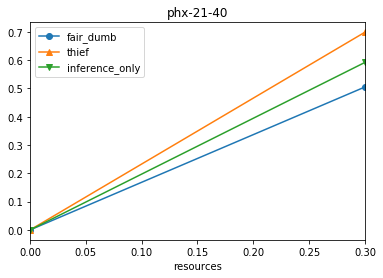

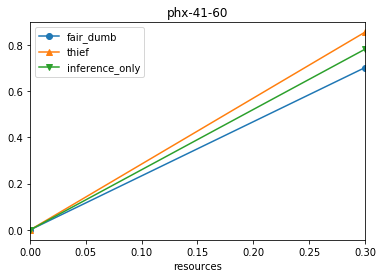

In [56]:
# Cost vs Resource

cities = d.city.unique()
for city in cities:
    temp_df = d[d['city']==city]
    ax = temp_df.plot(x='resources', y=scheds, kind='line',
                        title=city,
                        legend=True, style=['o-', '^-', 'v-'])

In [57]:
d

,city,period,resources,use_oracle,fair_dumb,thief,inference_only
1,phx-21-40,100,0.0,False,0.000000,0.000000,0.000000
3,phx-21-40,100,0.3,False,0.504749,0.698170,0.591501
5,phx-41-60,100,0.0,False,0.000000,0.000000,0.000000
7,phx-41-60,100,0.3,False,0.700924,0.853869,0.780291


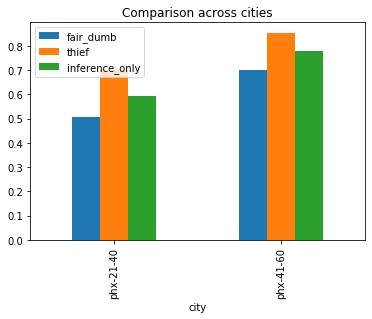

In [66]:
# Comparison across cameras
COMPARE_RES = 0.3
ax = d[d['resources']==COMPARE_RES].plot(x='city', y=scheds, kind='bar',
                  title="Comparison across cities")